# 深層学習 + CNN + Resnet + AdaCos + Metric Learning + GradCam によるMVTec AD leather の画像異常検知と可視化 

## 環境構築（Google Colab 以外の方は、手順1〜6は不要です。）

### 手順0：「ランタイム」より、「ランタイムのタイプを変更」して下さい。

### 手順１：Google Driveに画像データをアップロードしよう　

Google Drive に "MVTec_data"というフォルダを作り、その下に、画像データをアップロードします。

### 手順2：下記コードを実行し、先ほど画像をアップロードした Google Driveを指定して、画面の指示に従い、認証コードを入力します。

In [ ]:
from google.colab import drive
drive.mount('/content/drive')

### 手順3：Google Deiveがマウントされていることを確認します。 

In [ ]:
ls /content/drive/'My Drive'

### 手順4-1： Google Drive の MVTec_data/ に leather.zip をアップロードします。
（事前に、MVTEc AD データセットのleather/以下をzip圧縮した leather.zip を準備する必要があります。）

### 手順4-2： leather.zipを解凍します。

In [ ]:
!unzip /content/drive/'My Drive'/MVTec_data/leather.zip

### 手順4-3： 解凍できたことを確認します。

In [ ]:
ls /content/leather/

### 手順5-1：同じ場所（Google Drive の MVTec_data/）に archs_lether.py  dataset.py  metrics.py utils.py をアップロードします。

In [ ]:
ls /content/drive/'My Drive'/MVTec_data/

### 手順5-1：archs_lether.py  dataset.py  metrics.py utils.py を Google Colabにコピーします。

In [ ]:
!cp /content/drive/'My Drive'/MVTec_data/archs_lether.py ./
!cp /content/drive/'My Drive'/MVTec_data/utils.py ./
!cp /content/drive/'My Drive'/MVTec_data/dataset.py ./
!cp /content/drive/'My Drive'/MVTec_data/metrics.py ./

In [ ]:
ls

### 手順６：Google Drive の MVTec_data/ に models フォルダを作成します。

In [ ]:
!mkdir /content/drive/'My Drive'/MVTec_data/models

In [ ]:
ls /content/drive/'My Drive'/MVTec_data/

## ここまでは、Google Colab の環境作成で、ここからが実行コードです。

## Google Colab以外の環境をお使いの場合は、ここから始めて下さい。

In [1]:
import os
import numpy as np
import pandas as pd
import matplotlib.pyplot as plt
import argparse
import joblib
from tqdm import tqdm 
#import glob
from glob import glob
import datetime
import cv2 

import torch
import torch.nn as nn
import torch.backends.cudnn as cudnn
from torch.nn import functional as F
#import torch.nn.functional as F
import torch.optim as optim
from torch.optim import lr_scheduler
from torch.optim.lr_scheduler import ReduceLROnPlateau
from torch.utils.data import Dataset
from torch.utils.data import DataLoader
#import torchvision.transforms as transforms
#import torchvision.datasets as datasets
from torchvision import datasets, transforms, models
from collections import OrderedDict
from sklearn.model_selection import train_test_split
from sklearn.manifold import TSNE

### 外部の.pyから、NN作成用のデータとパラメーターを読み込み

In [2]:
import archs_lether, dataset
from utils import *
import metrics

In [3]:
ls_colors = ['#00FFFF', #水色
            '#DEB887',#ベージュ
            '#B8860B',#薄い茶色   
            '#ffa58f',
            '#ff5f24'] 

mvtec_classes = []
for i in range(5):
    mvtec_classes.append(str(i))

### NN用のパラメータを設定

In [4]:
def parse_args():
    parser = argparse.ArgumentParser()

    parser.add_argument('--name', default=None,
                        help='model name: (default: arch+timestamp)')
    parser.add_argument('--arch', default='ResNet_IR',
                        choices=archs_lether.__all__,
                        help='model architecture')
    parser.add_argument('--backbone', default='resnet18')
    parser.add_argument('--metric', default='adacos',
                        choices=['adacos', 'arcface', 'sphereface', 'cosface', 'softmax'])
    parser.add_argument('--num-features', default=512, type=int,
                        help='dimention of embedded features')
    parser.add_argument('--num-classes', default=10, type=int)
    parser.add_argument('-b', '--batch-size', default=32, type=int,
                        metavar='N', help='mini-batch size (default: 32)')
    parser.add_argument('--epochs', default=1000, type=int)
    parser.add_argument('--lr', '--learning-rate', default=1e-1, type=float)
    parser.add_argument('--min-lr', default=1e-3, type=float)
    parser.add_argument('--momentum', default=0.9, type=float)
    parser.add_argument('--weight-decay', default=1e-4, type=float)
    parser.add_argument('--nesterov', default=False, type=str2bool)
    parser.add_argument('--cpu', default=False, type=str2bool)

    args = parser.parse_args()

    return args

### 学習用の関数を定義

In [5]:
def train(args, train_loader, model, metric_fc, criterion, optimizer):
    losses = AverageMeter()
    acc1s = AverageMeter()
    acc5s = AverageMeter()

    model.train()
    metric_fc.train()

    for i, (input, target) in tqdm(enumerate(train_loader), total=len(train_loader)):
        if args.cpu:
            input = input.cpu()
            target = target.long().cpu()
        else:
            input = input.cuda()
            target = target.long().cuda() 

        feature = model(input)
        if args.metric == 'softmax':
            output = metric_fc(feature)
        else:
            output = metric_fc(feature, target)
        loss = criterion(output, target)

        acc1, acc5 = accuracy(output, target, topk=(1, 5))

        losses.update(loss.item(), input.size(0))
        acc1s.update(acc1.item(), input.size(0))
        acc5s.update(acc5.item(), input.size(0))

        # compute gradient and do optimizing step
        optimizer.zero_grad()
        loss.backward()
        optimizer.step()

    log = OrderedDict([
        ('loss', losses.avg),
        ('acc@1', acc1s.avg),
        ('acc@5', acc5s.avg),
    ])

    return log

def validate(args, val_loader, model, metric_fc, criterion):
    losses = AverageMeter()
    acc1s = AverageMeter()
    acc5s = AverageMeter()

    # switch to evaluate mode
    model.eval()
    metric_fc.eval()

    with torch.no_grad():
        for i, (input, target) in tqdm(enumerate(val_loader), total=len(val_loader)):
            if args.cpu:
                input = input.cpu()
                target = target.long().cpu()
            else:
                input = input.cuda()
                target = target.long().cuda() 

            feature = model(input)
            output = metric_fc(feature)
            loss = criterion(output, target)

            acc1, acc5 = accuracy(output, target, topk=(1, 5))

            losses.update(loss.item(), input.size(0))
            acc1s.update(acc1.item(), input.size(0))
            acc5s.update(acc5.item(), input.size(0))

    log = OrderedDict([
        ('loss', losses.avg),
        ('acc@1', acc1s.avg),
        ('acc@5', acc5s.avg),
    ])

    return log

### NN用のパラメーター読み込み

In [6]:
import sys
if sys.argv:
        del sys.argv[1:]

In [7]:
args = parse_args()
    
if args.name is None:
    args.name = 'MVTec_%s_%s_%dd' % (
        args.arch, args.metric, args.num_features)

if not os.path.exists('models/%s' % args.name):
    os.makedirs('models/%s' % args.name)

print('Config -----')
for arg in vars(args):
    print('%s: %s' % (arg, getattr(args, arg)))
print('------------')

with open('models/%s/args.txt' % args.name, 'w') as f:
    for arg in vars(args):
        print('%s: %s' % (arg, getattr(args, arg)), file=f)

joblib.dump(args, 'models/%s/args.pkl' % args.name)

if args.cpu:
    criterion = nn.CrossEntropyLoss().cpu()
else:
    criterion = nn.CrossEntropyLoss().cuda()

cudnn.benchmark = True

Config -----
name: MVTec_ResNet_IR_adacos_512d
arch: ResNet_IR
backbone: resnet18
metric: adacos
num_features: 512
num_classes: 10
batch_size: 32
epochs: 1000
lr: 0.1
min_lr: 0.001
momentum: 0.9
weight_decay: 0.0001
nesterov: False
cpu: False
------------


## データセット読み込み

#### データセットのファイル名取得

In [8]:
#base_dir = '/content/leather/' #Google Colab用
base_dir = './MVTec_data/leather/'

add_dir = 'train/good/'
img_paths_train_good = glob(base_dir + add_dir + '*.png')
labels_train_good = [0 for p in img_paths_train_good]

add_dir = 'test/good/'
img_paths_test_good = glob(base_dir + add_dir + '*.png')
labels_test_good = [0 for p in img_paths_test_good]

add_dir = 'test/color/'
img_paths_test_bad = glob(base_dir + add_dir + '*.png')
add_dir = 'test/cut/'
img_paths_test_bad.extend(glob(base_dir + add_dir + '*.png'))
add_dir = 'test/fold/'
img_paths_test_bad.extend(glob(base_dir + add_dir + '*.png'))
add_dir = 'test/glue/'
img_paths_test_bad.extend(glob(base_dir + add_dir + '*.png')) 
add_dir = 'test/poke/'
img_paths_test_bad.extend(glob(base_dir + add_dir + '*.png'))
labels_test_bad = [1 for p in img_paths_test_bad]

In [9]:
print(len(img_paths_train_good))
print(len(img_paths_test_good))
print(len(img_paths_test_bad))
print(len(labels_train_good))
print(len(labels_test_good))
print(len(labels_test_bad))

245
32
92
245
32
92


### 異常データセットの画像確認

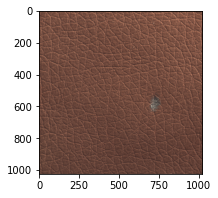

In [10]:
for i in range(len(img_paths_test_bad)):
    filename = img_paths_test_bad[i]
    test_image = Image.open(filename)  # 画像読み込み
    plt.figure(figsize=(3,3))
    plt.imshow(test_image)
    break # 全部を表示させる場合は、ここをコメントアウトする

### ファイル名から、dataset、dataloader を作成

In [11]:
train_img_paths_train_good, test_img_paths_train_good, train_labels_train_good, test_labels_train_good = train_test_split(
    img_paths_train_good, 
    labels_train_good, 
    test_size=0.2, random_state=41, stratify=labels_train_good)

train_img_paths_test_good, test_img_paths_test_good, train_labels_test_good, test_labels_test_good = train_test_split(
    img_paths_test_good, 
    labels_test_good, 
    test_size=0.2, random_state=41, stratify=labels_test_good)

train_img_paths_test_bad, test_img_paths_test_bad, train_labels_test_bad, test_labels_test_bad = train_test_split(
    img_paths_test_bad, 
    labels_test_bad, 
    test_size=0.2, random_state=41, stratify=labels_test_bad)

In [12]:
train_img_paths = train_img_paths_train_good + train_img_paths_test_good + train_img_paths_test_bad
test_img_paths = test_img_paths_train_good + test_img_paths_test_good + test_img_paths_test_bad

train_labels =  train_labels_train_good + train_labels_test_good + train_labels_test_bad
test_labels =  test_labels_train_good + test_labels_test_good + test_labels_test_bad

In [13]:
transform_mvtec_lether = transforms.Compose([
  transforms.Resize((512,512)), 
  transforms.ToTensor()
  ])

In [14]:
    train_set = dataset.MVTec_dataset(
        train_img_paths,
        train_labels,
        transform=transform_mvtec_lether)

    test_set = dataset.MVTec_dataset(
        test_img_paths,
        test_labels,
        transform=transform_mvtec_lether)

In [15]:
    train_loader = torch.utils.data.DataLoader(
        train_set,
        batch_size=8,
        shuffle=True,
        num_workers=0)

    test_loader = torch.utils.data.DataLoader(
        test_set,
        batch_size=8,
        shuffle=False,
        num_workers=0)

## NNインスタンスの作成

In [16]:
# create model
model = archs_lether.__dict__[args.arch](args)
if args.cpu:
    model = model.cpu()
else:
    model = model.cuda()

In [17]:
if args.metric == 'adacos':
    metric_fc = metrics.AdaCos(
        num_features=args.num_features, num_classes=args.num_classes)
elif args.metric == 'arcface':
    metric_fc = metrics.ArcFace(
        num_features=args.num_features, num_classes=args.num_classes)
elif args.metric == 'sphereface':
    metric_fc = metrics.SphereFace(
        num_features=args.num_features, num_classes=args.num_classes)
elif args.metric == 'cosface':
    metric_fc = metrics.CosFace(
        num_features=args.num_features, num_classes=args.num_classes)
else:
    metric_fc = nn.Linear(args.num_features, args.num_classes)
if args.cpu:
    metric_fc = metric_fc.cpu()
else:
    metric_fc = metric_fc.cuda()

In [18]:
model

ResNet_IR(
  (backbone): ResNet(
    (conv1): Conv2d(3, 64, kernel_size=(7, 7), stride=(2, 2), padding=(3, 3), bias=False)
    (bn1): BatchNorm2d(64, eps=1e-05, momentum=0.1, affine=True, track_running_stats=True)
    (relu): ReLU(inplace=True)
    (maxpool): MaxPool2d(kernel_size=3, stride=2, padding=1, dilation=1, ceil_mode=False)
    (layer1): Sequential(
      (0): BasicBlock(
        (conv1): Conv2d(64, 64, kernel_size=(3, 3), stride=(1, 1), padding=(1, 1), bias=False)
        (bn1): BatchNorm2d(64, eps=1e-05, momentum=0.1, affine=True, track_running_stats=True)
        (relu): ReLU(inplace=True)
        (conv2): Conv2d(64, 64, kernel_size=(3, 3), stride=(1, 1), padding=(1, 1), bias=False)
        (bn2): BatchNorm2d(64, eps=1e-05, momentum=0.1, affine=True, track_running_stats=True)
      )
      (1): BasicBlock(
        (conv1): Conv2d(64, 64, kernel_size=(3, 3), stride=(1, 1), padding=(1, 1), bias=False)
        (bn1): BatchNorm2d(64, eps=1e-05, momentum=0.1, affine=True, track_

## 学習

### 学習済みのモデルを使う場合は、下記のセルは実施しないで下さい。

In [19]:
# 学習済みのモデルを使う場合は、このセルは実施しないで下さい。
optimizer = optim.SGD(filter(lambda p: p.requires_grad, model.parameters()), lr=args.lr,
                          momentum=args.momentum, weight_decay=args.weight_decay)

scheduler = lr_scheduler.CosineAnnealingLR(optimizer,
                                            T_max=args.epochs, eta_min=args.min_lr)

log = pd.DataFrame(index=[], columns=[
      'epoch', 'lr', 'loss', 'acc@1', 'acc@5', 'val_loss', 'val_acc1', 'val_acc5'
    ])

best_loss = float('inf')
for epoch in range(args.epochs):
    print('Epoch [%d/%d]' % (epoch + 1, args.epochs))

    scheduler.step()

    # train for one epoch
    train_log = train(args, train_loader, model, metric_fc, criterion, optimizer)
    # evaluate on validation set
    val_log = validate(args, test_loader, model, metric_fc, criterion)

    print('loss %.4f - acc@1 %.4f - acc@5 %.4f - val_loss %.4f - val_acc@1 %.4f - val_acc@5 %.4f'
            %(train_log['loss'], train_log['acc@1'], train_log['acc@5'], val_log['loss'], val_log['acc@1'], val_log['acc@5']))

    tmp = pd.Series([
            epoch,
            scheduler.get_lr()[0],
            train_log['loss'],
            train_log['acc@1'],
            train_log['acc@5'],
            val_log['loss'],
            val_log['acc@1'],
            val_log['acc@5'],
        ], index=['epoch', 'lr', 'loss', 'acc@1', 'acc@5', 'val_loss', 'val_acc1', 'val_acc5'])

    log = log.append(tmp, ignore_index=True)
    log.to_csv('models/%s/log.csv' % args.name, index=False)

    if val_log['loss'] < best_loss:
        torch.save(model.state_dict(), 'models/%s/model.pth' %args.name)
        best_loss = val_log['loss']
        print("=> saved best model")

/usr/local/lib64/python3.6/site-packages/torch/optim/lr_scheduler.py:82: UserWarning: Detected call of `lr_scheduler.step()` before `optimizer.step()`. In PyTorch 1.1.0 and later, you should call them in the opposite order: `optimizer.step()` before `lr_scheduler.step()`.  Failure to do this will result in PyTorch skipping the first value of the learning rate schedule.See more details at https://pytorch.org/docs/stable/optim.html#how-to-adjust-learning-rate
  "https://pytorch.org/docs/stable/optim.html#how-to-adjust-learning-rate", UserWarning)
  0%|          | 0/37 [00:00<?, ?it/s]

Epoch [1/1000]


100%|██████████| 10/10 [00:03<00:00,  2.57it/s]


loss 1.5621 - acc@1 74.8299 - acc@5 80.9524 - val_loss 2.1547 - val_acc@1 68.0000 - val_acc@5 70.6667


  0%|          | 0/37 [00:00<?, ?it/s]

=> saved best model
Epoch [2/1000]


100%|██████████| 10/10 [00:03<00:00,  2.82it/s]


loss 1.1602 - acc@1 84.0136 - acc@5 89.1156 - val_loss 1.8739 - val_acc@1 77.3333 - val_acc@5 82.6667


  0%|          | 0/37 [00:00<?, ?it/s]

=> saved best model
Epoch [3/1000]


  0%|          | 0/37 [00:00<?, ?it/s]

loss 1.0156 - acc@1 87.0748 - acc@5 94.2177 - val_loss 2.8078 - val_acc@1 25.3333 - val_acc@5 25.3333
Epoch [4/1000]


100%|██████████| 10/10 [00:03<00:00,  2.83it/s]


loss 0.9931 - acc@1 88.4354 - acc@5 95.2381 - val_loss 1.6146 - val_acc@1 82.6667 - val_acc@5 93.3333


  0%|          | 0/37 [00:00<?, ?it/s]

=> saved best model
Epoch [5/1000]


  0%|          | 0/37 [00:00<?, ?it/s]

loss 0.9378 - acc@1 89.4558 - acc@5 96.5986 - val_loss 1.6804 - val_acc@1 76.0000 - val_acc@5 92.0000
Epoch [6/1000]


  0%|          | 0/37 [00:00<?, ?it/s]

loss 0.9294 - acc@1 91.1565 - acc@5 94.8980 - val_loss 2.6553 - val_acc@1 26.6667 - val_acc@5 26.6667
Epoch [7/1000]


  0%|          | 0/37 [00:00<?, ?it/s]

loss 0.8969 - acc@1 91.4966 - acc@5 96.9388 - val_loss 2.7295 - val_acc@1 25.3333 - val_acc@5 25.3333
Epoch [8/1000]


100%|██████████| 10/10 [00:03<00:00,  2.73it/s]


loss 0.8948 - acc@1 91.8367 - acc@5 96.2585 - val_loss 1.5727 - val_acc@1 84.0000 - val_acc@5 100.0000


  0%|          | 0/37 [00:00<?, ?it/s]

=> saved best model
Epoch [9/1000]


  0%|          | 0/37 [00:00<?, ?it/s]

loss 0.8552 - acc@1 93.1973 - acc@5 98.2993 - val_loss 1.7806 - val_acc@1 76.0000 - val_acc@5 86.6667
Epoch [10/1000]


  0%|          | 0/37 [00:00<?, ?it/s]

loss 0.8276 - acc@1 94.5578 - acc@5 99.3197 - val_loss 2.6937 - val_acc@1 25.3333 - val_acc@5 25.3333
Epoch [11/1000]


  0%|          | 0/37 [00:00<?, ?it/s]

loss 0.8082 - acc@1 96.2585 - acc@5 98.9796 - val_loss 1.6284 - val_acc@1 78.6667 - val_acc@5 93.3333
Epoch [12/1000]


  0%|          | 0/37 [00:00<?, ?it/s]

loss 0.8006 - acc@1 95.9184 - acc@5 99.3197 - val_loss 2.6980 - val_acc@1 25.3333 - val_acc@5 25.3333
Epoch [13/1000]


  0%|          | 0/37 [00:00<?, ?it/s]

loss 0.8482 - acc@1 92.5170 - acc@5 97.9592 - val_loss 1.5990 - val_acc@1 80.0000 - val_acc@5 96.0000
Epoch [14/1000]


  0%|          | 0/37 [00:00<?, ?it/s]

loss 0.8014 - acc@1 95.5782 - acc@5 99.3197 - val_loss 2.6859 - val_acc@1 25.3333 - val_acc@5 25.3333
Epoch [15/1000]


100%|██████████| 10/10 [00:03<00:00,  2.84it/s]


loss 0.8101 - acc@1 94.5578 - acc@5 98.2993 - val_loss 1.5411 - val_acc@1 86.6667 - val_acc@5 100.0000


  0%|          | 0/37 [00:00<?, ?it/s]

=> saved best model
Epoch [16/1000]


  0%|          | 0/37 [00:00<?, ?it/s]

loss 0.8501 - acc@1 91.1565 - acc@5 97.9592 - val_loss 1.7855 - val_acc@1 73.3333 - val_acc@5 80.0000
Epoch [17/1000]


100%|██████████| 10/10 [00:03<00:00,  2.85it/s]


loss 0.8128 - acc@1 93.8776 - acc@5 98.6395 - val_loss 1.4755 - val_acc@1 94.6667 - val_acc@5 100.0000


  0%|          | 0/37 [00:00<?, ?it/s]

=> saved best model
Epoch [18/1000]


  0%|          | 0/37 [00:00<?, ?it/s]

loss 0.8084 - acc@1 95.5782 - acc@5 97.9592 - val_loss 1.7948 - val_acc@1 56.0000 - val_acc@5 94.6667
Epoch [19/1000]


  0%|          | 0/37 [00:00<?, ?it/s]

loss 0.8540 - acc@1 90.4762 - acc@5 97.9592 - val_loss 2.2723 - val_acc@1 38.6667 - val_acc@5 49.3333
Epoch [20/1000]


  0%|          | 0/37 [00:00<?, ?it/s]

loss 0.8666 - acc@1 90.1361 - acc@5 98.2993 - val_loss 1.5967 - val_acc@1 77.3333 - val_acc@5 100.0000
Epoch [21/1000]


  0%|          | 0/37 [00:00<?, ?it/s]

loss 0.7769 - acc@1 96.9388 - acc@5 99.6599 - val_loss 2.6048 - val_acc@1 25.3333 - val_acc@5 25.3333
Epoch [22/1000]


  0%|          | 0/37 [00:00<?, ?it/s]

loss 0.8403 - acc@1 92.1769 - acc@5 97.9592 - val_loss 1.5303 - val_acc@1 88.0000 - val_acc@5 100.0000
Epoch [23/1000]


  0%|          | 0/37 [00:00<?, ?it/s]

loss 0.8376 - acc@1 91.1565 - acc@5 98.2993 - val_loss 1.5268 - val_acc@1 88.0000 - val_acc@5 100.0000
Epoch [24/1000]


  0%|          | 0/37 [00:00<?, ?it/s]

loss 0.8062 - acc@1 94.2177 - acc@5 97.6190 - val_loss 2.4835 - val_acc@1 25.3333 - val_acc@5 28.0000
Epoch [25/1000]


  0%|          | 0/37 [00:00<?, ?it/s]

loss 0.7841 - acc@1 95.9184 - acc@5 98.6395 - val_loss 1.4914 - val_acc@1 93.3333 - val_acc@5 100.0000
Epoch [26/1000]


  0%|          | 0/37 [00:00<?, ?it/s]

loss 0.7671 - acc@1 95.9184 - acc@5 98.9796 - val_loss 2.5622 - val_acc@1 25.3333 - val_acc@5 25.3333
Epoch [27/1000]


  0%|          | 0/37 [00:00<?, ?it/s]

loss 0.7979 - acc@1 94.5578 - acc@5 98.2993 - val_loss 2.6012 - val_acc@1 25.3333 - val_acc@5 25.3333
Epoch [28/1000]


  0%|          | 0/37 [00:00<?, ?it/s]

loss 0.8162 - acc@1 93.5374 - acc@5 97.9592 - val_loss 1.8302 - val_acc@1 74.6667 - val_acc@5 76.0000
Epoch [29/1000]


100%|██████████| 10/10 [00:03<00:00,  2.84it/s]


loss 0.7650 - acc@1 96.5986 - acc@5 98.9796 - val_loss 1.4627 - val_acc@1 94.6667 - val_acc@5 100.0000


  0%|          | 0/37 [00:00<?, ?it/s]

=> saved best model
Epoch [30/1000]


  0%|          | 0/37 [00:00<?, ?it/s]

loss 0.7899 - acc@1 94.2177 - acc@5 98.9796 - val_loss 1.7069 - val_acc@1 72.0000 - val_acc@5 94.6667
Epoch [31/1000]


  0%|          | 0/37 [00:00<?, ?it/s]

loss 0.8218 - acc@1 92.8571 - acc@5 98.2993 - val_loss 1.4807 - val_acc@1 92.0000 - val_acc@5 100.0000
Epoch [32/1000]


  0%|          | 0/37 [00:00<?, ?it/s]

loss 0.7778 - acc@1 95.9184 - acc@5 98.9796 - val_loss 2.4422 - val_acc@1 28.0000 - val_acc@5 32.0000
Epoch [33/1000]


100%|██████████| 10/10 [00:03<00:00,  2.82it/s]


loss 0.7712 - acc@1 96.2585 - acc@5 99.3197 - val_loss 1.4558 - val_acc@1 94.6667 - val_acc@5 100.0000


  0%|          | 0/37 [00:00<?, ?it/s]

=> saved best model
Epoch [34/1000]


100%|██████████| 10/10 [00:03<00:00,  2.63it/s]


loss 0.7428 - acc@1 97.9592 - acc@5 99.3197 - val_loss 1.4519 - val_acc@1 96.0000 - val_acc@5 100.0000


  0%|          | 0/37 [00:00<?, ?it/s]

=> saved best model
Epoch [35/1000]


  0%|          | 0/37 [00:00<?, ?it/s]

loss 0.7924 - acc@1 95.2381 - acc@5 98.2993 - val_loss 1.5262 - val_acc@1 88.0000 - val_acc@5 98.6667
Epoch [36/1000]


  0%|          | 0/37 [00:00<?, ?it/s]

loss 0.7373 - acc@1 97.9592 - acc@5 100.0000 - val_loss 1.4953 - val_acc@1 92.0000 - val_acc@5 97.3333
Epoch [37/1000]


  0%|          | 0/37 [00:00<?, ?it/s]

loss 0.7520 - acc@1 97.2789 - acc@5 99.6599 - val_loss 1.6327 - val_acc@1 74.6667 - val_acc@5 97.3333
Epoch [38/1000]


  0%|          | 0/37 [00:00<?, ?it/s]

loss 0.7442 - acc@1 97.2789 - acc@5 100.0000 - val_loss 1.4523 - val_acc@1 96.0000 - val_acc@5 100.0000
Epoch [39/1000]


  0%|          | 0/37 [00:00<?, ?it/s]

loss 0.7938 - acc@1 94.2177 - acc@5 98.9796 - val_loss 2.5150 - val_acc@1 25.3333 - val_acc@5 25.3333
Epoch [40/1000]


  0%|          | 0/37 [00:00<?, ?it/s]

loss 0.8133 - acc@1 92.5170 - acc@5 98.6395 - val_loss 1.5733 - val_acc@1 85.3333 - val_acc@5 96.0000
Epoch [41/1000]


  0%|          | 0/37 [00:00<?, ?it/s]

loss 0.7357 - acc@1 97.6190 - acc@5 100.0000 - val_loss 1.4523 - val_acc@1 94.6667 - val_acc@5 100.0000
Epoch [42/1000]


  0%|          | 0/37 [00:00<?, ?it/s]

loss 0.7926 - acc@1 93.1973 - acc@5 99.3197 - val_loss 1.4536 - val_acc@1 96.0000 - val_acc@5 100.0000
Epoch [43/1000]


  0%|          | 0/37 [00:00<?, ?it/s]

loss 0.7956 - acc@1 93.5374 - acc@5 99.6599 - val_loss 1.4656 - val_acc@1 94.6667 - val_acc@5 100.0000
Epoch [44/1000]


  0%|          | 0/37 [00:00<?, ?it/s]

loss 0.7731 - acc@1 93.8776 - acc@5 100.0000 - val_loss 1.5879 - val_acc@1 82.6667 - val_acc@5 93.3333
Epoch [45/1000]


  0%|          | 0/37 [00:00<?, ?it/s]

loss 0.7854 - acc@1 94.2177 - acc@5 98.9796 - val_loss 1.4679 - val_acc@1 92.0000 - val_acc@5 100.0000
Epoch [46/1000]


  0%|          | 0/37 [00:00<?, ?it/s]

loss 0.7853 - acc@1 93.8776 - acc@5 99.3197 - val_loss 1.4806 - val_acc@1 92.0000 - val_acc@5 100.0000
Epoch [47/1000]


  0%|          | 0/37 [00:00<?, ?it/s]

loss 0.7636 - acc@1 95.9184 - acc@5 99.3197 - val_loss 1.4755 - val_acc@1 92.0000 - val_acc@5 100.0000
Epoch [48/1000]


100%|██████████| 10/10 [00:03<00:00,  2.81it/s]


loss 0.7557 - acc@1 97.6190 - acc@5 99.6599 - val_loss 1.4385 - val_acc@1 98.6667 - val_acc@5 100.0000


  0%|          | 0/37 [00:00<?, ?it/s]

=> saved best model
Epoch [49/1000]


  0%|          | 0/37 [00:00<?, ?it/s]

loss 0.7372 - acc@1 96.9388 - acc@5 100.0000 - val_loss 1.4633 - val_acc@1 93.3333 - val_acc@5 100.0000
Epoch [50/1000]


  0%|          | 0/37 [00:00<?, ?it/s]

loss 0.7438 - acc@1 97.6190 - acc@5 99.6599 - val_loss 1.4492 - val_acc@1 96.0000 - val_acc@5 100.0000
Epoch [51/1000]


  0%|          | 0/37 [00:00<?, ?it/s]

loss 0.7409 - acc@1 96.9388 - acc@5 100.0000 - val_loss 1.4764 - val_acc@1 93.3333 - val_acc@5 100.0000
Epoch [52/1000]


  0%|          | 0/37 [00:00<?, ?it/s]

loss 0.7313 - acc@1 97.2789 - acc@5 100.0000 - val_loss 1.4767 - val_acc@1 92.0000 - val_acc@5 100.0000
Epoch [53/1000]


  0%|          | 0/37 [00:00<?, ?it/s]

loss 0.7402 - acc@1 97.2789 - acc@5 100.0000 - val_loss 1.4597 - val_acc@1 97.3333 - val_acc@5 100.0000
Epoch [54/1000]


  0%|          | 0/37 [00:00<?, ?it/s]

loss 0.7518 - acc@1 96.2585 - acc@5 100.0000 - val_loss 2.4147 - val_acc@1 25.3333 - val_acc@5 25.3333
Epoch [55/1000]


  0%|          | 0/37 [00:00<?, ?it/s]

loss 0.7936 - acc@1 93.1973 - acc@5 99.6599 - val_loss 1.5359 - val_acc@1 86.6667 - val_acc@5 96.0000
Epoch [56/1000]


  0%|          | 0/37 [00:00<?, ?it/s]

loss 0.7790 - acc@1 94.2177 - acc@5 99.6599 - val_loss 1.4692 - val_acc@1 93.3333 - val_acc@5 100.0000
Epoch [57/1000]


  0%|          | 0/37 [00:00<?, ?it/s]

loss 0.7201 - acc@1 98.6395 - acc@5 100.0000 - val_loss 1.5024 - val_acc@1 89.3333 - val_acc@5 100.0000
Epoch [58/1000]


  0%|          | 0/37 [00:00<?, ?it/s]

loss 0.7683 - acc@1 95.2381 - acc@5 100.0000 - val_loss 1.5068 - val_acc@1 89.3333 - val_acc@5 100.0000
Epoch [59/1000]


100%|██████████| 10/10 [00:03<00:00,  2.84it/s]


loss 0.7578 - acc@1 95.5782 - acc@5 100.0000 - val_loss 1.4372 - val_acc@1 97.3333 - val_acc@5 100.0000


  0%|          | 0/37 [00:00<?, ?it/s]

=> saved best model
Epoch [60/1000]


  0%|          | 0/37 [00:00<?, ?it/s]

loss 0.7520 - acc@1 95.9184 - acc@5 99.6599 - val_loss 1.7542 - val_acc@1 53.3333 - val_acc@5 100.0000
Epoch [61/1000]


  0%|          | 0/37 [00:00<?, ?it/s]

loss 0.7538 - acc@1 96.5986 - acc@5 100.0000 - val_loss 2.1737 - val_acc@1 25.3333 - val_acc@5 52.0000
Epoch [62/1000]


  0%|          | 0/37 [00:00<?, ?it/s]

loss 0.7332 - acc@1 96.9388 - acc@5 99.6599 - val_loss 2.3841 - val_acc@1 26.6667 - val_acc@5 34.6667
Epoch [63/1000]


  0%|          | 0/37 [00:00<?, ?it/s]

loss 0.7442 - acc@1 96.2585 - acc@5 100.0000 - val_loss 1.7968 - val_acc@1 58.6667 - val_acc@5 90.6667
Epoch [64/1000]


  0%|          | 0/37 [00:00<?, ?it/s]

loss 0.7365 - acc@1 96.9388 - acc@5 100.0000 - val_loss 1.4497 - val_acc@1 96.0000 - val_acc@5 100.0000
Epoch [65/1000]


  0%|          | 0/37 [00:00<?, ?it/s]

loss 0.7444 - acc@1 96.5986 - acc@5 100.0000 - val_loss 1.5573 - val_acc@1 88.0000 - val_acc@5 97.3333
Epoch [66/1000]


  0%|          | 0/37 [00:00<?, ?it/s]

loss 0.7282 - acc@1 98.2993 - acc@5 100.0000 - val_loss 1.4485 - val_acc@1 94.6667 - val_acc@5 100.0000
Epoch [67/1000]


  0%|          | 0/37 [00:00<?, ?it/s]

loss 0.7352 - acc@1 97.9592 - acc@5 99.6599 - val_loss 1.4671 - val_acc@1 93.3333 - val_acc@5 98.6667
Epoch [68/1000]


  0%|          | 0/37 [00:00<?, ?it/s]

loss 0.7429 - acc@1 96.9388 - acc@5 100.0000 - val_loss 1.4430 - val_acc@1 96.0000 - val_acc@5 100.0000
Epoch [69/1000]


  0%|          | 0/37 [00:00<?, ?it/s]

loss 0.7268 - acc@1 97.6190 - acc@5 100.0000 - val_loss 1.4468 - val_acc@1 97.3333 - val_acc@5 100.0000
Epoch [70/1000]


  0%|          | 0/37 [00:00<?, ?it/s]

loss 0.7227 - acc@1 98.2993 - acc@5 100.0000 - val_loss 1.4468 - val_acc@1 97.3333 - val_acc@5 100.0000
Epoch [71/1000]


  0%|          | 0/37 [00:00<?, ?it/s]

loss 0.7269 - acc@1 97.6190 - acc@5 100.0000 - val_loss 2.1894 - val_acc@1 16.0000 - val_acc@5 77.3333
Epoch [72/1000]


  0%|          | 0/37 [00:00<?, ?it/s]

loss 0.7240 - acc@1 98.6395 - acc@5 99.6599 - val_loss 1.5727 - val_acc@1 84.0000 - val_acc@5 100.0000
Epoch [73/1000]


  0%|          | 0/37 [00:00<?, ?it/s]

loss 0.7485 - acc@1 95.9184 - acc@5 99.6599 - val_loss 2.2709 - val_acc@1 29.3333 - val_acc@5 38.6667
Epoch [74/1000]


  0%|          | 0/37 [00:00<?, ?it/s]

loss 0.7446 - acc@1 96.5986 - acc@5 100.0000 - val_loss 2.4467 - val_acc@1 25.3333 - val_acc@5 25.3333
Epoch [75/1000]


  0%|          | 0/37 [00:00<?, ?it/s]

loss 0.7594 - acc@1 95.9184 - acc@5 99.6599 - val_loss 1.4721 - val_acc@1 93.3333 - val_acc@5 100.0000
Epoch [76/1000]


100%|██████████| 10/10 [00:03<00:00,  2.84it/s]


loss 0.7789 - acc@1 93.5374 - acc@5 100.0000 - val_loss 1.4327 - val_acc@1 96.0000 - val_acc@5 100.0000


  0%|          | 0/37 [00:00<?, ?it/s]

=> saved best model
Epoch [77/1000]


  0%|          | 0/37 [00:00<?, ?it/s]

loss 0.7320 - acc@1 97.6190 - acc@5 100.0000 - val_loss 1.9294 - val_acc@1 38.6667 - val_acc@5 100.0000
Epoch [78/1000]


  0%|          | 0/37 [00:00<?, ?it/s]

loss 0.7270 - acc@1 98.2993 - acc@5 100.0000 - val_loss 1.4405 - val_acc@1 97.3333 - val_acc@5 100.0000
Epoch [79/1000]


  0%|          | 0/37 [00:00<?, ?it/s]

loss 0.7497 - acc@1 96.2585 - acc@5 99.6599 - val_loss 1.4476 - val_acc@1 96.0000 - val_acc@5 100.0000
Epoch [80/1000]


  0%|          | 0/37 [00:00<?, ?it/s]

loss 0.7462 - acc@1 96.9388 - acc@5 100.0000 - val_loss 1.6904 - val_acc@1 64.0000 - val_acc@5 100.0000
Epoch [81/1000]


  0%|          | 0/37 [00:00<?, ?it/s]

loss 0.7279 - acc@1 97.2789 - acc@5 100.0000 - val_loss 2.0894 - val_acc@1 38.6667 - val_acc@5 54.6667
Epoch [82/1000]


  0%|          | 0/37 [00:00<?, ?it/s]

loss 0.7471 - acc@1 96.2585 - acc@5 100.0000 - val_loss 1.9283 - val_acc@1 42.6667 - val_acc@5 82.6667
Epoch [83/1000]


  0%|          | 0/37 [00:00<?, ?it/s]

loss 0.7277 - acc@1 97.6190 - acc@5 100.0000 - val_loss 1.4505 - val_acc@1 94.6667 - val_acc@5 100.0000
Epoch [84/1000]


  0%|          | 0/37 [00:00<?, ?it/s]

loss 0.7223 - acc@1 98.2993 - acc@5 100.0000 - val_loss 1.4766 - val_acc@1 93.3333 - val_acc@5 100.0000
Epoch [85/1000]


  0%|          | 0/37 [00:00<?, ?it/s]

loss 0.7262 - acc@1 97.9592 - acc@5 100.0000 - val_loss 1.4401 - val_acc@1 97.3333 - val_acc@5 100.0000
Epoch [86/1000]


  0%|          | 0/37 [00:00<?, ?it/s]

loss 0.7173 - acc@1 97.9592 - acc@5 100.0000 - val_loss 1.4457 - val_acc@1 96.0000 - val_acc@5 100.0000
Epoch [87/1000]


  0%|          | 0/37 [00:00<?, ?it/s]

loss 0.7364 - acc@1 97.2789 - acc@5 100.0000 - val_loss 1.6606 - val_acc@1 65.3333 - val_acc@5 97.3333
Epoch [88/1000]


  0%|          | 0/37 [00:00<?, ?it/s]

loss 0.7491 - acc@1 95.2381 - acc@5 100.0000 - val_loss 1.4519 - val_acc@1 94.6667 - val_acc@5 100.0000
Epoch [89/1000]


  0%|          | 0/37 [00:00<?, ?it/s]

loss 0.7409 - acc@1 95.9184 - acc@5 100.0000 - val_loss 1.4491 - val_acc@1 96.0000 - val_acc@5 100.0000
Epoch [90/1000]


  0%|          | 0/37 [00:00<?, ?it/s]

loss 0.7319 - acc@1 97.9592 - acc@5 99.6599 - val_loss 1.4384 - val_acc@1 97.3333 - val_acc@5 100.0000
Epoch [91/1000]


  0%|          | 0/37 [00:00<?, ?it/s]

loss 0.7144 - acc@1 98.9796 - acc@5 100.0000 - val_loss 1.5292 - val_acc@1 89.3333 - val_acc@5 100.0000
Epoch [92/1000]


  0%|          | 0/37 [00:00<?, ?it/s]

loss 0.7255 - acc@1 97.6190 - acc@5 100.0000 - val_loss 1.4570 - val_acc@1 94.6667 - val_acc@5 100.0000
Epoch [93/1000]


  0%|          | 0/37 [00:00<?, ?it/s]

loss 0.7300 - acc@1 97.2789 - acc@5 100.0000 - val_loss 1.4708 - val_acc@1 93.3333 - val_acc@5 100.0000
Epoch [94/1000]


  0%|          | 0/37 [00:00<?, ?it/s]

loss 0.7314 - acc@1 97.2789 - acc@5 100.0000 - val_loss 1.8327 - val_acc@1 46.6667 - val_acc@5 98.6667
Epoch [95/1000]


  0%|          | 0/37 [00:00<?, ?it/s]

loss 0.7307 - acc@1 97.2789 - acc@5 100.0000 - val_loss 1.4810 - val_acc@1 92.0000 - val_acc@5 100.0000
Epoch [96/1000]


  0%|          | 0/37 [00:00<?, ?it/s]

loss 0.7399 - acc@1 96.9388 - acc@5 100.0000 - val_loss 1.4828 - val_acc@1 90.6667 - val_acc@5 100.0000
Epoch [97/1000]


  0%|          | 0/37 [00:00<?, ?it/s]

loss 0.7365 - acc@1 97.2789 - acc@5 100.0000 - val_loss 1.7745 - val_acc@1 58.6667 - val_acc@5 97.3333
Epoch [98/1000]


  0%|          | 0/37 [00:00<?, ?it/s]

loss 0.7204 - acc@1 98.2993 - acc@5 100.0000 - val_loss 1.4445 - val_acc@1 96.0000 - val_acc@5 100.0000
Epoch [99/1000]


  0%|          | 0/37 [00:00<?, ?it/s]

loss 0.7218 - acc@1 97.9592 - acc@5 100.0000 - val_loss 1.5026 - val_acc@1 89.3333 - val_acc@5 98.6667
Epoch [100/1000]


  0%|          | 0/37 [00:00<?, ?it/s]

loss 0.7402 - acc@1 96.9388 - acc@5 100.0000 - val_loss 1.5073 - val_acc@1 89.3333 - val_acc@5 100.0000
Epoch [101/1000]


  0%|          | 0/37 [00:00<?, ?it/s]

loss 0.7299 - acc@1 97.2789 - acc@5 100.0000 - val_loss 1.4359 - val_acc@1 96.0000 - val_acc@5 100.0000
Epoch [102/1000]


  0%|          | 0/37 [00:00<?, ?it/s]

loss 0.7273 - acc@1 97.2789 - acc@5 100.0000 - val_loss 1.4530 - val_acc@1 96.0000 - val_acc@5 100.0000
Epoch [103/1000]


  0%|          | 0/37 [00:00<?, ?it/s]

loss 0.7188 - acc@1 98.2993 - acc@5 100.0000 - val_loss 2.0338 - val_acc@1 37.3333 - val_acc@5 73.3333
Epoch [104/1000]


  0%|          | 0/37 [00:00<?, ?it/s]

loss 0.7577 - acc@1 95.9184 - acc@5 99.6599 - val_loss 1.4593 - val_acc@1 96.0000 - val_acc@5 100.0000
Epoch [105/1000]


  0%|          | 0/37 [00:00<?, ?it/s]

loss 0.7239 - acc@1 98.2993 - acc@5 100.0000 - val_loss 1.4394 - val_acc@1 97.3333 - val_acc@5 100.0000
Epoch [106/1000]


  0%|          | 0/37 [00:00<?, ?it/s]

loss 0.7461 - acc@1 95.2381 - acc@5 100.0000 - val_loss 1.5021 - val_acc@1 90.6667 - val_acc@5 100.0000
Epoch [107/1000]


  0%|          | 0/37 [00:00<?, ?it/s]

loss 0.7261 - acc@1 97.2789 - acc@5 100.0000 - val_loss 1.5849 - val_acc@1 81.3333 - val_acc@5 96.0000
Epoch [108/1000]


  0%|          | 0/37 [00:00<?, ?it/s]

loss 0.7573 - acc@1 95.9184 - acc@5 99.6599 - val_loss 1.4594 - val_acc@1 94.6667 - val_acc@5 100.0000
Epoch [109/1000]


  0%|          | 0/37 [00:00<?, ?it/s]

loss 0.7162 - acc@1 98.9796 - acc@5 100.0000 - val_loss 1.4489 - val_acc@1 96.0000 - val_acc@5 100.0000
Epoch [110/1000]


  0%|          | 0/37 [00:00<?, ?it/s]

loss 0.7303 - acc@1 96.9388 - acc@5 100.0000 - val_loss 1.4331 - val_acc@1 98.6667 - val_acc@5 100.0000
Epoch [111/1000]


  0%|          | 0/37 [00:00<?, ?it/s]

loss 0.7272 - acc@1 97.9592 - acc@5 100.0000 - val_loss 1.8981 - val_acc@1 25.3333 - val_acc@5 100.0000
Epoch [112/1000]


  0%|          | 0/37 [00:00<?, ?it/s]

loss 0.7234 - acc@1 97.2789 - acc@5 100.0000 - val_loss 1.6813 - val_acc@1 66.6667 - val_acc@5 97.3333
Epoch [113/1000]


  0%|          | 0/37 [00:00<?, ?it/s]

loss 0.7287 - acc@1 97.6190 - acc@5 100.0000 - val_loss 1.8703 - val_acc@1 37.3333 - val_acc@5 100.0000
Epoch [114/1000]


  0%|          | 0/37 [00:00<?, ?it/s]

loss 0.7266 - acc@1 97.9592 - acc@5 100.0000 - val_loss 1.5087 - val_acc@1 90.6667 - val_acc@5 100.0000
Epoch [115/1000]


  0%|          | 0/37 [00:00<?, ?it/s]

loss 0.7246 - acc@1 97.9592 - acc@5 100.0000 - val_loss 1.4462 - val_acc@1 96.0000 - val_acc@5 100.0000
Epoch [116/1000]


  0%|          | 0/37 [00:00<?, ?it/s]

loss 0.7175 - acc@1 98.6395 - acc@5 100.0000 - val_loss 1.4604 - val_acc@1 92.0000 - val_acc@5 100.0000
Epoch [117/1000]


  0%|          | 0/37 [00:00<?, ?it/s]

loss 0.7166 - acc@1 98.6395 - acc@5 100.0000 - val_loss 1.4350 - val_acc@1 97.3333 - val_acc@5 100.0000
Epoch [118/1000]


  0%|          | 0/37 [00:00<?, ?it/s]

loss 0.7154 - acc@1 98.6395 - acc@5 100.0000 - val_loss 1.4950 - val_acc@1 90.6667 - val_acc@5 100.0000
Epoch [119/1000]


  0%|          | 0/37 [00:00<?, ?it/s]

loss 0.7317 - acc@1 97.2789 - acc@5 100.0000 - val_loss 2.2386 - val_acc@1 26.6667 - val_acc@5 50.6667
Epoch [120/1000]


  0%|          | 0/37 [00:00<?, ?it/s]

loss 0.7175 - acc@1 98.2993 - acc@5 100.0000 - val_loss 1.4516 - val_acc@1 94.6667 - val_acc@5 100.0000
Epoch [121/1000]


  0%|          | 0/37 [00:00<?, ?it/s]

loss 0.7120 - acc@1 98.6395 - acc@5 100.0000 - val_loss 1.4453 - val_acc@1 96.0000 - val_acc@5 100.0000
Epoch [122/1000]


  0%|          | 0/37 [00:00<?, ?it/s]

loss 0.7209 - acc@1 98.2993 - acc@5 100.0000 - val_loss 1.4706 - val_acc@1 93.3333 - val_acc@5 100.0000
Epoch [123/1000]


  0%|          | 0/37 [00:00<?, ?it/s]

loss 0.7263 - acc@1 97.6190 - acc@5 100.0000 - val_loss 1.9415 - val_acc@1 34.6667 - val_acc@5 98.6667
Epoch [124/1000]


  0%|          | 0/37 [00:00<?, ?it/s]

loss 0.7191 - acc@1 98.6395 - acc@5 100.0000 - val_loss 1.4569 - val_acc@1 98.6667 - val_acc@5 100.0000
Epoch [125/1000]


  0%|          | 0/37 [00:00<?, ?it/s]

loss 0.7044 - acc@1 99.6599 - acc@5 100.0000 - val_loss 1.4417 - val_acc@1 96.0000 - val_acc@5 100.0000
Epoch [126/1000]


  0%|          | 0/37 [00:00<?, ?it/s]

loss 0.7125 - acc@1 98.9796 - acc@5 100.0000 - val_loss 1.4410 - val_acc@1 96.0000 - val_acc@5 100.0000
Epoch [127/1000]


  0%|          | 0/37 [00:00<?, ?it/s]

loss 0.7214 - acc@1 97.9592 - acc@5 100.0000 - val_loss 1.4945 - val_acc@1 90.6667 - val_acc@5 100.0000
Epoch [128/1000]


  0%|          | 0/37 [00:00<?, ?it/s]

loss 0.7176 - acc@1 98.6395 - acc@5 100.0000 - val_loss 1.5631 - val_acc@1 84.0000 - val_acc@5 100.0000
Epoch [129/1000]


  0%|          | 0/37 [00:00<?, ?it/s]

loss 0.7280 - acc@1 96.9388 - acc@5 100.0000 - val_loss 1.4378 - val_acc@1 97.3333 - val_acc@5 100.0000
Epoch [130/1000]


  0%|          | 0/37 [00:00<?, ?it/s]

loss 0.7228 - acc@1 97.2789 - acc@5 100.0000 - val_loss 1.4584 - val_acc@1 96.0000 - val_acc@5 100.0000
Epoch [131/1000]


  0%|          | 0/37 [00:00<?, ?it/s]

loss 0.7170 - acc@1 98.6395 - acc@5 100.0000 - val_loss 1.4350 - val_acc@1 97.3333 - val_acc@5 100.0000
Epoch [132/1000]


  0%|          | 0/37 [00:00<?, ?it/s]

loss 0.7281 - acc@1 97.2789 - acc@5 100.0000 - val_loss 1.4872 - val_acc@1 92.0000 - val_acc@5 100.0000
Epoch [133/1000]


  0%|          | 0/37 [00:00<?, ?it/s]

loss 0.7290 - acc@1 97.6190 - acc@5 100.0000 - val_loss 1.4438 - val_acc@1 96.0000 - val_acc@5 100.0000
Epoch [134/1000]


  0%|          | 0/37 [00:00<?, ?it/s]

loss 0.7232 - acc@1 97.6190 - acc@5 100.0000 - val_loss 1.5115 - val_acc@1 89.3333 - val_acc@5 98.6667
Epoch [135/1000]


  0%|          | 0/37 [00:00<?, ?it/s]

loss 0.7130 - acc@1 98.6395 - acc@5 100.0000 - val_loss 1.9193 - val_acc@1 37.3333 - val_acc@5 94.6667
Epoch [136/1000]


  0%|          | 0/37 [00:00<?, ?it/s]

loss 0.7138 - acc@1 98.9796 - acc@5 100.0000 - val_loss 1.7222 - val_acc@1 53.3333 - val_acc@5 98.6667
Epoch [137/1000]


  0%|          | 0/37 [00:00<?, ?it/s]

loss 0.7104 - acc@1 98.6395 - acc@5 100.0000 - val_loss 1.4494 - val_acc@1 96.0000 - val_acc@5 100.0000
Epoch [138/1000]


  0%|          | 0/37 [00:00<?, ?it/s]

loss 0.7224 - acc@1 97.6190 - acc@5 100.0000 - val_loss 1.4981 - val_acc@1 89.3333 - val_acc@5 100.0000
Epoch [139/1000]


  0%|          | 0/37 [00:00<?, ?it/s]

loss 0.7193 - acc@1 97.9592 - acc@5 100.0000 - val_loss 1.4363 - val_acc@1 100.0000 - val_acc@5 100.0000
Epoch [140/1000]


  0%|          | 0/37 [00:00<?, ?it/s]

loss 0.7091 - acc@1 99.3197 - acc@5 100.0000 - val_loss 1.4457 - val_acc@1 96.0000 - val_acc@5 100.0000
Epoch [141/1000]


  0%|          | 0/37 [00:00<?, ?it/s]

loss 0.7034 - acc@1 99.6599 - acc@5 100.0000 - val_loss 1.4367 - val_acc@1 96.0000 - val_acc@5 100.0000
Epoch [142/1000]


  0%|          | 0/37 [00:00<?, ?it/s]

loss 0.7230 - acc@1 97.9592 - acc@5 100.0000 - val_loss 1.4446 - val_acc@1 96.0000 - val_acc@5 100.0000
Epoch [143/1000]


  0%|          | 0/37 [00:00<?, ?it/s]

loss 0.7244 - acc@1 97.6190 - acc@5 100.0000 - val_loss 1.4358 - val_acc@1 97.3333 - val_acc@5 100.0000
Epoch [144/1000]


  0%|          | 0/37 [00:00<?, ?it/s]

loss 0.7226 - acc@1 96.9388 - acc@5 100.0000 - val_loss 1.4356 - val_acc@1 96.0000 - val_acc@5 100.0000
Epoch [145/1000]


  0%|          | 0/37 [00:00<?, ?it/s]

loss 0.7063 - acc@1 99.3197 - acc@5 100.0000 - val_loss 2.0728 - val_acc@1 30.6667 - val_acc@5 100.0000
Epoch [146/1000]


100%|██████████| 10/10 [00:03<00:00,  2.85it/s]


loss 0.7228 - acc@1 96.9388 - acc@5 100.0000 - val_loss 1.4318 - val_acc@1 96.0000 - val_acc@5 100.0000


  0%|          | 0/37 [00:00<?, ?it/s]

=> saved best model
Epoch [147/1000]


  0%|          | 0/37 [00:00<?, ?it/s]

loss 0.7102 - acc@1 98.6395 - acc@5 100.0000 - val_loss 1.4506 - val_acc@1 97.3333 - val_acc@5 100.0000
Epoch [148/1000]


  0%|          | 0/37 [00:00<?, ?it/s]

loss 0.7174 - acc@1 97.9592 - acc@5 100.0000 - val_loss 1.5066 - val_acc@1 90.6667 - val_acc@5 100.0000
Epoch [149/1000]


  0%|          | 0/37 [00:00<?, ?it/s]

loss 0.7152 - acc@1 98.2993 - acc@5 100.0000 - val_loss 1.4389 - val_acc@1 96.0000 - val_acc@5 100.0000
Epoch [150/1000]


  0%|          | 0/37 [00:00<?, ?it/s]

loss 0.7074 - acc@1 98.9796 - acc@5 100.0000 - val_loss 1.4625 - val_acc@1 94.6667 - val_acc@5 100.0000
Epoch [151/1000]


  0%|          | 0/37 [00:00<?, ?it/s]

loss 0.7154 - acc@1 98.6395 - acc@5 100.0000 - val_loss 1.5493 - val_acc@1 85.3333 - val_acc@5 96.0000
Epoch [152/1000]


  0%|          | 0/37 [00:00<?, ?it/s]

loss 0.7253 - acc@1 97.6190 - acc@5 100.0000 - val_loss 1.4435 - val_acc@1 96.0000 - val_acc@5 100.0000
Epoch [153/1000]


  0%|          | 0/37 [00:00<?, ?it/s]

loss 0.7119 - acc@1 98.6395 - acc@5 100.0000 - val_loss 1.9098 - val_acc@1 49.3333 - val_acc@5 81.3333
Epoch [154/1000]


  0%|          | 0/37 [00:00<?, ?it/s]

loss 0.7258 - acc@1 97.6190 - acc@5 100.0000 - val_loss 1.9466 - val_acc@1 41.3333 - val_acc@5 82.6667
Epoch [155/1000]


  0%|          | 0/37 [00:00<?, ?it/s]

loss 0.7135 - acc@1 98.6395 - acc@5 100.0000 - val_loss 1.4867 - val_acc@1 93.3333 - val_acc@5 100.0000
Epoch [156/1000]


  0%|          | 0/37 [00:00<?, ?it/s]

loss 0.7272 - acc@1 96.9388 - acc@5 100.0000 - val_loss 1.4367 - val_acc@1 97.3333 - val_acc@5 100.0000
Epoch [157/1000]


  0%|          | 0/37 [00:00<?, ?it/s]

loss 0.7082 - acc@1 99.3197 - acc@5 100.0000 - val_loss 1.4474 - val_acc@1 96.0000 - val_acc@5 100.0000
Epoch [158/1000]


  0%|          | 0/37 [00:00<?, ?it/s]

loss 0.7123 - acc@1 99.3197 - acc@5 100.0000 - val_loss 1.5236 - val_acc@1 90.6667 - val_acc@5 100.0000
Epoch [159/1000]


100%|██████████| 10/10 [00:03<00:00,  2.84it/s]


loss 0.7202 - acc@1 98.2993 - acc@5 100.0000 - val_loss 1.4191 - val_acc@1 98.6667 - val_acc@5 100.0000


  0%|          | 0/37 [00:00<?, ?it/s]

=> saved best model
Epoch [160/1000]


  0%|          | 0/37 [00:00<?, ?it/s]

loss 0.7245 - acc@1 97.2789 - acc@5 99.6599 - val_loss 1.7665 - val_acc@1 36.0000 - val_acc@5 100.0000
Epoch [161/1000]


  0%|          | 0/37 [00:00<?, ?it/s]

loss 0.7292 - acc@1 97.2789 - acc@5 100.0000 - val_loss 1.4414 - val_acc@1 96.0000 - val_acc@5 100.0000
Epoch [162/1000]


  0%|          | 0/37 [00:00<?, ?it/s]

loss 0.7144 - acc@1 98.6395 - acc@5 100.0000 - val_loss 1.4463 - val_acc@1 94.6667 - val_acc@5 100.0000
Epoch [163/1000]


  0%|          | 0/37 [00:00<?, ?it/s]

loss 0.7191 - acc@1 97.9592 - acc@5 100.0000 - val_loss 1.4290 - val_acc@1 100.0000 - val_acc@5 100.0000
Epoch [164/1000]


  0%|          | 0/37 [00:00<?, ?it/s]

loss 0.7236 - acc@1 97.9592 - acc@5 100.0000 - val_loss 1.4394 - val_acc@1 97.3333 - val_acc@5 100.0000
Epoch [165/1000]


  0%|          | 0/37 [00:00<?, ?it/s]

loss 0.7194 - acc@1 97.9592 - acc@5 100.0000 - val_loss 1.4248 - val_acc@1 98.6667 - val_acc@5 100.0000
Epoch [166/1000]


  0%|          | 0/37 [00:00<?, ?it/s]

loss 0.7313 - acc@1 96.9388 - acc@5 100.0000 - val_loss 1.4418 - val_acc@1 96.0000 - val_acc@5 100.0000
Epoch [167/1000]


  0%|          | 0/37 [00:00<?, ?it/s]

loss 0.7238 - acc@1 97.2789 - acc@5 100.0000 - val_loss 1.4286 - val_acc@1 96.0000 - val_acc@5 100.0000
Epoch [168/1000]


  0%|          | 0/37 [00:00<?, ?it/s]

loss 0.7137 - acc@1 98.9796 - acc@5 100.0000 - val_loss 1.4334 - val_acc@1 96.0000 - val_acc@5 100.0000
Epoch [169/1000]


  0%|          | 0/37 [00:00<?, ?it/s]

loss 0.7150 - acc@1 98.2993 - acc@5 100.0000 - val_loss 1.4392 - val_acc@1 96.0000 - val_acc@5 100.0000
Epoch [170/1000]


  0%|          | 0/37 [00:00<?, ?it/s]

loss 0.7245 - acc@1 97.6190 - acc@5 100.0000 - val_loss 1.5342 - val_acc@1 85.3333 - val_acc@5 100.0000
Epoch [171/1000]


  0%|          | 0/37 [00:00<?, ?it/s]

loss 0.7198 - acc@1 97.9592 - acc@5 100.0000 - val_loss 1.4453 - val_acc@1 96.0000 - val_acc@5 100.0000
Epoch [172/1000]


  0%|          | 0/37 [00:00<?, ?it/s]

loss 0.7064 - acc@1 99.3197 - acc@5 100.0000 - val_loss 1.4357 - val_acc@1 97.3333 - val_acc@5 100.0000
Epoch [173/1000]


  0%|          | 0/37 [00:00<?, ?it/s]

loss 0.7179 - acc@1 97.9592 - acc@5 100.0000 - val_loss 1.4407 - val_acc@1 96.0000 - val_acc@5 100.0000
Epoch [174/1000]


  0%|          | 0/37 [00:00<?, ?it/s]

loss 0.7108 - acc@1 98.2993 - acc@5 100.0000 - val_loss 1.4493 - val_acc@1 96.0000 - val_acc@5 100.0000
Epoch [175/1000]


  0%|          | 0/37 [00:00<?, ?it/s]

loss 0.7168 - acc@1 98.2993 - acc@5 100.0000 - val_loss 1.4416 - val_acc@1 96.0000 - val_acc@5 100.0000
Epoch [176/1000]


  0%|          | 0/37 [00:00<?, ?it/s]

loss 0.7405 - acc@1 95.9184 - acc@5 100.0000 - val_loss 2.2657 - val_acc@1 32.0000 - val_acc@5 50.6667
Epoch [177/1000]


  0%|          | 0/37 [00:00<?, ?it/s]

loss 0.7186 - acc@1 97.9592 - acc@5 100.0000 - val_loss 1.5874 - val_acc@1 85.3333 - val_acc@5 98.6667
Epoch [178/1000]


  0%|          | 0/37 [00:00<?, ?it/s]

loss 0.7042 - acc@1 99.6599 - acc@5 100.0000 - val_loss 1.5744 - val_acc@1 82.6667 - val_acc@5 98.6667
Epoch [179/1000]


  0%|          | 0/37 [00:00<?, ?it/s]

loss 0.7171 - acc@1 98.6395 - acc@5 100.0000 - val_loss 1.4500 - val_acc@1 96.0000 - val_acc@5 100.0000
Epoch [180/1000]


  0%|          | 0/37 [00:00<?, ?it/s]

loss 0.7251 - acc@1 97.9592 - acc@5 100.0000 - val_loss 1.5189 - val_acc@1 90.6667 - val_acc@5 94.6667
Epoch [181/1000]


  0%|          | 0/37 [00:00<?, ?it/s]

loss 0.7415 - acc@1 95.5782 - acc@5 99.6599 - val_loss 2.0850 - val_acc@1 25.3333 - val_acc@5 100.0000
Epoch [182/1000]


  0%|          | 0/37 [00:00<?, ?it/s]

loss 0.7189 - acc@1 98.6395 - acc@5 99.6599 - val_loss 1.4766 - val_acc@1 94.6667 - val_acc@5 100.0000
Epoch [183/1000]


  0%|          | 0/37 [00:00<?, ?it/s]

loss 0.7164 - acc@1 98.6395 - acc@5 100.0000 - val_loss 1.4541 - val_acc@1 94.6667 - val_acc@5 97.3333
Epoch [184/1000]


  0%|          | 0/37 [00:00<?, ?it/s]

loss 0.7353 - acc@1 96.5986 - acc@5 100.0000 - val_loss 2.2496 - val_acc@1 25.3333 - val_acc@5 53.3333
Epoch [185/1000]


  0%|          | 0/37 [00:00<?, ?it/s]

loss 0.7159 - acc@1 98.9796 - acc@5 100.0000 - val_loss 1.5219 - val_acc@1 89.3333 - val_acc@5 98.6667
Epoch [186/1000]


  0%|          | 0/37 [00:00<?, ?it/s]

loss 0.7320 - acc@1 97.6190 - acc@5 100.0000 - val_loss 1.5979 - val_acc@1 80.0000 - val_acc@5 98.6667
Epoch [187/1000]


  0%|          | 0/37 [00:00<?, ?it/s]

loss 0.7362 - acc@1 96.9388 - acc@5 100.0000 - val_loss 1.4469 - val_acc@1 96.0000 - val_acc@5 100.0000
Epoch [188/1000]


  0%|          | 0/37 [00:00<?, ?it/s]

loss 0.7375 - acc@1 96.5986 - acc@5 100.0000 - val_loss 2.2380 - val_acc@1 25.3333 - val_acc@5 25.3333
Epoch [189/1000]


  0%|          | 0/37 [00:00<?, ?it/s]

loss 0.7258 - acc@1 97.9592 - acc@5 100.0000 - val_loss 1.4442 - val_acc@1 96.0000 - val_acc@5 100.0000
Epoch [190/1000]


  0%|          | 0/37 [00:00<?, ?it/s]

loss 0.7271 - acc@1 98.2993 - acc@5 100.0000 - val_loss 1.4639 - val_acc@1 93.3333 - val_acc@5 100.0000
Epoch [191/1000]


  0%|          | 0/37 [00:00<?, ?it/s]

loss 0.7336 - acc@1 97.9592 - acc@5 99.6599 - val_loss 1.4824 - val_acc@1 90.6667 - val_acc@5 100.0000
Epoch [192/1000]


  0%|          | 0/37 [00:00<?, ?it/s]

loss 0.7336 - acc@1 97.2789 - acc@5 100.0000 - val_loss 1.4649 - val_acc@1 93.3333 - val_acc@5 98.6667
Epoch [193/1000]


  0%|          | 0/37 [00:00<?, ?it/s]

loss 0.7167 - acc@1 98.9796 - acc@5 100.0000 - val_loss 1.4469 - val_acc@1 94.6667 - val_acc@5 100.0000
Epoch [194/1000]


  0%|          | 0/37 [00:00<?, ?it/s]

loss 0.7192 - acc@1 98.2993 - acc@5 100.0000 - val_loss 1.4276 - val_acc@1 98.6667 - val_acc@5 100.0000
Epoch [195/1000]


  0%|          | 0/37 [00:00<?, ?it/s]

loss 0.7133 - acc@1 98.6395 - acc@5 100.0000 - val_loss 1.4550 - val_acc@1 94.6667 - val_acc@5 100.0000
Epoch [196/1000]


  0%|          | 0/37 [00:00<?, ?it/s]

loss 0.7264 - acc@1 97.2789 - acc@5 100.0000 - val_loss 1.4410 - val_acc@1 96.0000 - val_acc@5 100.0000
Epoch [197/1000]


  0%|          | 0/37 [00:00<?, ?it/s]

loss 0.7141 - acc@1 98.6395 - acc@5 100.0000 - val_loss 1.4391 - val_acc@1 96.0000 - val_acc@5 100.0000
Epoch [198/1000]


  0%|          | 0/37 [00:00<?, ?it/s]

loss 0.7241 - acc@1 97.6190 - acc@5 100.0000 - val_loss 1.4370 - val_acc@1 97.3333 - val_acc@5 100.0000
Epoch [199/1000]


  0%|          | 0/37 [00:00<?, ?it/s]

loss 0.7306 - acc@1 96.9388 - acc@5 100.0000 - val_loss 1.4515 - val_acc@1 96.0000 - val_acc@5 100.0000
Epoch [200/1000]


  0%|          | 0/37 [00:00<?, ?it/s]

loss 0.7464 - acc@1 96.2585 - acc@5 100.0000 - val_loss 1.4506 - val_acc@1 93.3333 - val_acc@5 100.0000
Epoch [201/1000]


  0%|          | 0/37 [00:00<?, ?it/s]

loss 0.7082 - acc@1 99.3197 - acc@5 100.0000 - val_loss 1.4418 - val_acc@1 96.0000 - val_acc@5 100.0000
Epoch [202/1000]


  0%|          | 0/37 [00:00<?, ?it/s]

loss 0.7148 - acc@1 98.6395 - acc@5 100.0000 - val_loss 1.4941 - val_acc@1 94.6667 - val_acc@5 100.0000
Epoch [203/1000]


  0%|          | 0/37 [00:00<?, ?it/s]

loss 0.7163 - acc@1 97.6190 - acc@5 100.0000 - val_loss 1.5469 - val_acc@1 86.6667 - val_acc@5 100.0000
Epoch [204/1000]


  0%|          | 0/37 [00:00<?, ?it/s]

loss 0.7137 - acc@1 98.9796 - acc@5 100.0000 - val_loss 1.4527 - val_acc@1 96.0000 - val_acc@5 100.0000
Epoch [205/1000]


  0%|          | 0/37 [00:00<?, ?it/s]

loss 0.7227 - acc@1 97.9592 - acc@5 100.0000 - val_loss 1.4642 - val_acc@1 94.6667 - val_acc@5 100.0000
Epoch [206/1000]


  0%|          | 0/37 [00:00<?, ?it/s]

loss 0.7276 - acc@1 96.9388 - acc@5 100.0000 - val_loss 1.6046 - val_acc@1 70.6667 - val_acc@5 100.0000
Epoch [207/1000]


  0%|          | 0/37 [00:00<?, ?it/s]

loss 0.7127 - acc@1 99.3197 - acc@5 100.0000 - val_loss 1.4309 - val_acc@1 96.0000 - val_acc@5 100.0000
Epoch [208/1000]


  0%|          | 0/37 [00:00<?, ?it/s]

loss 0.7205 - acc@1 97.9592 - acc@5 100.0000 - val_loss 1.4914 - val_acc@1 97.3333 - val_acc@5 100.0000
Epoch [209/1000]


  0%|          | 0/37 [00:00<?, ?it/s]

loss 0.7332 - acc@1 97.2789 - acc@5 100.0000 - val_loss 1.5044 - val_acc@1 89.3333 - val_acc@5 98.6667
Epoch [210/1000]


  0%|          | 0/37 [00:00<?, ?it/s]

loss 0.7152 - acc@1 98.2993 - acc@5 100.0000 - val_loss 1.4332 - val_acc@1 98.6667 - val_acc@5 100.0000
Epoch [211/1000]


  0%|          | 0/37 [00:00<?, ?it/s]

loss 0.7083 - acc@1 98.9796 - acc@5 100.0000 - val_loss 1.4476 - val_acc@1 96.0000 - val_acc@5 100.0000
Epoch [212/1000]


  0%|          | 0/37 [00:00<?, ?it/s]

loss 0.7163 - acc@1 97.2789 - acc@5 100.0000 - val_loss 2.1925 - val_acc@1 25.3333 - val_acc@5 68.0000
Epoch [213/1000]


  0%|          | 0/37 [00:00<?, ?it/s]

loss 0.7131 - acc@1 98.6395 - acc@5 100.0000 - val_loss 1.4601 - val_acc@1 94.6667 - val_acc@5 100.0000
Epoch [214/1000]


  0%|          | 0/37 [00:00<?, ?it/s]

loss 0.7188 - acc@1 97.6190 - acc@5 100.0000 - val_loss 1.4312 - val_acc@1 98.6667 - val_acc@5 100.0000
Epoch [215/1000]


  0%|          | 0/37 [00:00<?, ?it/s]

loss 0.7168 - acc@1 98.2993 - acc@5 100.0000 - val_loss 1.4246 - val_acc@1 97.3333 - val_acc@5 100.0000
Epoch [216/1000]


  0%|          | 0/37 [00:00<?, ?it/s]

loss 0.7139 - acc@1 98.9796 - acc@5 100.0000 - val_loss 1.6623 - val_acc@1 56.0000 - val_acc@5 100.0000
Epoch [217/1000]


  0%|          | 0/37 [00:00<?, ?it/s]

loss 0.7163 - acc@1 98.6395 - acc@5 100.0000 - val_loss 1.4738 - val_acc@1 93.3333 - val_acc@5 98.6667
Epoch [218/1000]


  0%|          | 0/37 [00:00<?, ?it/s]

loss 0.7099 - acc@1 98.9796 - acc@5 100.0000 - val_loss 1.4422 - val_acc@1 96.0000 - val_acc@5 100.0000
Epoch [219/1000]


  0%|          | 0/37 [00:00<?, ?it/s]

loss 0.7173 - acc@1 98.2993 - acc@5 100.0000 - val_loss 1.4398 - val_acc@1 97.3333 - val_acc@5 100.0000
Epoch [220/1000]


  0%|          | 0/37 [00:00<?, ?it/s]

loss 0.7157 - acc@1 98.6395 - acc@5 100.0000 - val_loss 1.5060 - val_acc@1 89.3333 - val_acc@5 100.0000
Epoch [221/1000]


  0%|          | 0/37 [00:00<?, ?it/s]

loss 0.7767 - acc@1 94.5578 - acc@5 99.3197 - val_loss 2.1331 - val_acc@1 25.3333 - val_acc@5 100.0000
Epoch [222/1000]


  0%|          | 0/37 [00:00<?, ?it/s]

loss 0.7299 - acc@1 96.5986 - acc@5 100.0000 - val_loss 1.5739 - val_acc@1 86.6667 - val_acc@5 100.0000
Epoch [223/1000]


  0%|          | 0/37 [00:00<?, ?it/s]

loss 0.7197 - acc@1 97.6190 - acc@5 100.0000 - val_loss 1.4648 - val_acc@1 93.3333 - val_acc@5 100.0000
Epoch [224/1000]


  0%|          | 0/37 [00:00<?, ?it/s]

loss 0.7239 - acc@1 97.6190 - acc@5 100.0000 - val_loss 1.4548 - val_acc@1 94.6667 - val_acc@5 100.0000
Epoch [225/1000]


  0%|          | 0/37 [00:00<?, ?it/s]

loss 0.7084 - acc@1 98.9796 - acc@5 100.0000 - val_loss 1.4749 - val_acc@1 93.3333 - val_acc@5 100.0000
Epoch [226/1000]


  0%|          | 0/37 [00:00<?, ?it/s]

loss 0.7184 - acc@1 98.2993 - acc@5 100.0000 - val_loss 1.4500 - val_acc@1 96.0000 - val_acc@5 100.0000
Epoch [227/1000]


  0%|          | 0/37 [00:00<?, ?it/s]

loss 0.7100 - acc@1 98.9796 - acc@5 100.0000 - val_loss 1.5389 - val_acc@1 84.0000 - val_acc@5 97.3333
Epoch [228/1000]


  0%|          | 0/37 [00:00<?, ?it/s]

loss 0.7145 - acc@1 98.2993 - acc@5 100.0000 - val_loss 1.4443 - val_acc@1 96.0000 - val_acc@5 100.0000
Epoch [229/1000]


  0%|          | 0/37 [00:00<?, ?it/s]

loss 0.8169 - acc@1 89.4558 - acc@5 100.0000 - val_loss 1.6600 - val_acc@1 45.3333 - val_acc@5 100.0000
Epoch [234/1000]


  0%|          | 0/37 [00:00<?, ?it/s]

loss 0.8201 - acc@1 90.1361 - acc@5 100.0000 - val_loss 1.5936 - val_acc@1 93.3333 - val_acc@5 100.0000
Epoch [235/1000]


  0%|          | 0/37 [00:00<?, ?it/s]

loss 0.8206 - acc@1 89.7959 - acc@5 100.0000 - val_loss 1.6062 - val_acc@1 80.0000 - val_acc@5 94.6667
Epoch [236/1000]


  0%|          | 0/37 [00:00<?, ?it/s]

loss 0.8111 - acc@1 89.7959 - acc@5 100.0000 - val_loss 1.5650 - val_acc@1 86.6667 - val_acc@5 100.0000
Epoch [237/1000]


  0%|          | 0/37 [00:00<?, ?it/s]

loss 0.8008 - acc@1 91.4966 - acc@5 99.6599 - val_loss 1.8148 - val_acc@1 49.3333 - val_acc@5 100.0000
Epoch [238/1000]


  0%|          | 0/37 [00:00<?, ?it/s]

loss 0.7819 - acc@1 93.8776 - acc@5 100.0000 - val_loss 1.4456 - val_acc@1 96.0000 - val_acc@5 100.0000
Epoch [239/1000]


  0%|          | 0/37 [00:00<?, ?it/s]

loss 0.7935 - acc@1 93.5374 - acc@5 100.0000 - val_loss 1.4628 - val_acc@1 100.0000 - val_acc@5 100.0000
Epoch [240/1000]


  0%|          | 0/37 [00:00<?, ?it/s]

loss 0.7764 - acc@1 94.2177 - acc@5 100.0000 - val_loss 1.6757 - val_acc@1 52.0000 - val_acc@5 100.0000
Epoch [241/1000]


  0%|          | 0/37 [00:00<?, ?it/s]

loss 0.7859 - acc@1 92.8571 - acc@5 100.0000 - val_loss 1.4836 - val_acc@1 94.6667 - val_acc@5 100.0000
Epoch [242/1000]


  0%|          | 0/37 [00:00<?, ?it/s]

loss 0.7868 - acc@1 92.5170 - acc@5 100.0000 - val_loss 1.4538 - val_acc@1 94.6667 - val_acc@5 100.0000
Epoch [243/1000]


  0%|          | 0/37 [00:00<?, ?it/s]

loss 0.7804 - acc@1 93.5374 - acc@5 99.6599 - val_loss 1.5553 - val_acc@1 82.6667 - val_acc@5 100.0000
Epoch [244/1000]


  0%|          | 0/37 [00:00<?, ?it/s]

loss 0.8041 - acc@1 89.7959 - acc@5 100.0000 - val_loss 1.4844 - val_acc@1 92.0000 - val_acc@5 100.0000
Epoch [245/1000]


  0%|          | 0/37 [00:00<?, ?it/s]

loss 0.7694 - acc@1 94.8980 - acc@5 100.0000 - val_loss 1.5061 - val_acc@1 93.3333 - val_acc@5 100.0000
Epoch [246/1000]


  0%|          | 0/37 [00:00<?, ?it/s]

loss 0.8089 - acc@1 90.8163 - acc@5 99.6599 - val_loss 1.5335 - val_acc@1 89.3333 - val_acc@5 97.3333
Epoch [247/1000]


  0%|          | 0/37 [00:00<?, ?it/s]

loss 0.7853 - acc@1 94.2177 - acc@5 100.0000 - val_loss 1.5546 - val_acc@1 81.3333 - val_acc@5 96.0000
Epoch [248/1000]


  0%|          | 0/37 [00:00<?, ?it/s]

loss 0.7645 - acc@1 95.5782 - acc@5 100.0000 - val_loss 1.5902 - val_acc@1 93.3333 - val_acc@5 100.0000
Epoch [249/1000]


  0%|          | 0/37 [00:00<?, ?it/s]

loss 0.7590 - acc@1 97.2789 - acc@5 99.3197 - val_loss 1.5019 - val_acc@1 96.0000 - val_acc@5 100.0000
Epoch [250/1000]


  0%|          | 0/37 [00:00<?, ?it/s]

loss 0.7591 - acc@1 94.5578 - acc@5 100.0000 - val_loss 1.4801 - val_acc@1 96.0000 - val_acc@5 98.6667
Epoch [251/1000]


  0%|          | 0/37 [00:00<?, ?it/s]

loss 0.7749 - acc@1 93.8776 - acc@5 100.0000 - val_loss 1.4749 - val_acc@1 94.6667 - val_acc@5 100.0000
Epoch [252/1000]


  0%|          | 0/37 [00:00<?, ?it/s]

loss 0.7535 - acc@1 96.5986 - acc@5 100.0000 - val_loss 1.4570 - val_acc@1 96.0000 - val_acc@5 100.0000
Epoch [253/1000]


  0%|          | 0/37 [00:00<?, ?it/s]

loss 0.7339 - acc@1 97.6190 - acc@5 100.0000 - val_loss 1.5023 - val_acc@1 90.6667 - val_acc@5 100.0000
Epoch [254/1000]


  0%|          | 0/37 [00:00<?, ?it/s]

loss 0.7695 - acc@1 94.8980 - acc@5 100.0000 - val_loss 1.4629 - val_acc@1 93.3333 - val_acc@5 100.0000
Epoch [255/1000]


  0%|          | 0/37 [00:00<?, ?it/s]

loss 0.7497 - acc@1 95.9184 - acc@5 100.0000 - val_loss 2.0931 - val_acc@1 25.3333 - val_acc@5 100.0000
Epoch [256/1000]


  0%|          | 0/37 [00:00<?, ?it/s]

loss 0.7442 - acc@1 96.9388 - acc@5 100.0000 - val_loss 1.5588 - val_acc@1 90.6667 - val_acc@5 100.0000
Epoch [257/1000]


  0%|          | 0/37 [00:00<?, ?it/s]

loss 0.7581 - acc@1 94.8980 - acc@5 100.0000 - val_loss 1.5619 - val_acc@1 82.6667 - val_acc@5 97.3333
Epoch [258/1000]


  0%|          | 0/37 [00:00<?, ?it/s]

loss 0.7458 - acc@1 97.2789 - acc@5 99.6599 - val_loss 1.6128 - val_acc@1 65.3333 - val_acc@5 100.0000
Epoch [259/1000]


  0%|          | 0/37 [00:00<?, ?it/s]

loss 0.7543 - acc@1 96.2585 - acc@5 100.0000 - val_loss 1.5079 - val_acc@1 89.3333 - val_acc@5 100.0000
Epoch [260/1000]


  0%|          | 0/37 [00:00<?, ?it/s]

loss 0.7301 - acc@1 97.9592 - acc@5 100.0000 - val_loss 1.4507 - val_acc@1 96.0000 - val_acc@5 100.0000
Epoch [261/1000]


  0%|          | 0/37 [00:00<?, ?it/s]

loss 0.7321 - acc@1 98.6395 - acc@5 100.0000 - val_loss 1.4623 - val_acc@1 93.3333 - val_acc@5 100.0000
Epoch [262/1000]


  0%|          | 0/37 [00:00<?, ?it/s]

loss 0.7322 - acc@1 97.6190 - acc@5 100.0000 - val_loss 1.5172 - val_acc@1 96.0000 - val_acc@5 100.0000
Epoch [263/1000]


  0%|          | 0/37 [00:00<?, ?it/s]

loss 0.7436 - acc@1 95.9184 - acc@5 100.0000 - val_loss 1.4517 - val_acc@1 94.6667 - val_acc@5 100.0000
Epoch [264/1000]


  0%|          | 0/37 [00:00<?, ?it/s]

loss 0.7260 - acc@1 97.9592 - acc@5 100.0000 - val_loss 1.4671 - val_acc@1 94.6667 - val_acc@5 100.0000
Epoch [265/1000]


  0%|          | 0/37 [00:00<?, ?it/s]

loss 0.7456 - acc@1 96.5986 - acc@5 100.0000 - val_loss 1.4624 - val_acc@1 94.6667 - val_acc@5 100.0000
Epoch [266/1000]


  0%|          | 0/37 [00:00<?, ?it/s]

loss 0.7424 - acc@1 97.2789 - acc@5 99.6599 - val_loss 1.4570 - val_acc@1 96.0000 - val_acc@5 100.0000
Epoch [267/1000]


  0%|          | 0/37 [00:00<?, ?it/s]

loss 0.7462 - acc@1 96.9388 - acc@5 99.6599 - val_loss 1.5782 - val_acc@1 82.6667 - val_acc@5 100.0000
Epoch [268/1000]


  0%|          | 0/37 [00:00<?, ?it/s]

loss 0.7395 - acc@1 97.2789 - acc@5 100.0000 - val_loss 1.5029 - val_acc@1 93.3333 - val_acc@5 100.0000
Epoch [269/1000]


  0%|          | 0/37 [00:00<?, ?it/s]

loss 0.7304 - acc@1 97.6190 - acc@5 100.0000 - val_loss 1.4776 - val_acc@1 94.6667 - val_acc@5 100.0000
Epoch [270/1000]


  0%|          | 0/37 [00:00<?, ?it/s]

loss 0.7297 - acc@1 97.6190 - acc@5 100.0000 - val_loss 1.4791 - val_acc@1 94.6667 - val_acc@5 100.0000
Epoch [271/1000]


  0%|          | 0/37 [00:00<?, ?it/s]

loss 0.7262 - acc@1 97.2789 - acc@5 100.0000 - val_loss 1.8891 - val_acc@1 38.6667 - val_acc@5 100.0000
Epoch [272/1000]


  0%|          | 0/37 [00:00<?, ?it/s]

loss 0.7254 - acc@1 98.2993 - acc@5 100.0000 - val_loss 1.4637 - val_acc@1 96.0000 - val_acc@5 100.0000
Epoch [273/1000]


  0%|          | 0/37 [00:00<?, ?it/s]

loss 0.7285 - acc@1 97.9592 - acc@5 100.0000 - val_loss 1.6548 - val_acc@1 73.3333 - val_acc@5 100.0000
Epoch [274/1000]


  0%|          | 0/37 [00:00<?, ?it/s]

loss 0.7171 - acc@1 98.6395 - acc@5 100.0000 - val_loss 1.5238 - val_acc@1 89.3333 - val_acc@5 100.0000
Epoch [275/1000]


  0%|          | 0/37 [00:00<?, ?it/s]

loss 0.7218 - acc@1 97.9592 - acc@5 100.0000 - val_loss 1.4463 - val_acc@1 94.6667 - val_acc@5 100.0000
Epoch [276/1000]


  0%|          | 0/37 [00:00<?, ?it/s]

loss 0.7242 - acc@1 97.9592 - acc@5 100.0000 - val_loss 2.2468 - val_acc@1 25.3333 - val_acc@5 29.3333
Epoch [277/1000]


  0%|          | 0/37 [00:00<?, ?it/s]

loss 0.7224 - acc@1 97.9592 - acc@5 100.0000 - val_loss 1.6398 - val_acc@1 74.6667 - val_acc@5 94.6667
Epoch [278/1000]


  0%|          | 0/37 [00:00<?, ?it/s]

loss 0.7219 - acc@1 97.9592 - acc@5 100.0000 - val_loss 1.4805 - val_acc@1 94.6667 - val_acc@5 100.0000
Epoch [279/1000]


  0%|          | 0/37 [00:00<?, ?it/s]

loss 0.7125 - acc@1 98.6395 - acc@5 100.0000 - val_loss 1.4767 - val_acc@1 93.3333 - val_acc@5 100.0000
Epoch [280/1000]


  0%|          | 0/37 [00:00<?, ?it/s]

loss 0.7260 - acc@1 97.9592 - acc@5 100.0000 - val_loss 1.4511 - val_acc@1 96.0000 - val_acc@5 100.0000
Epoch [281/1000]


  0%|          | 0/37 [00:00<?, ?it/s]

loss 0.7170 - acc@1 97.9592 - acc@5 100.0000 - val_loss 1.5902 - val_acc@1 88.0000 - val_acc@5 100.0000
Epoch [282/1000]


  0%|          | 0/37 [00:00<?, ?it/s]

loss 0.7313 - acc@1 97.2789 - acc@5 100.0000 - val_loss 1.4512 - val_acc@1 93.3333 - val_acc@5 100.0000
Epoch [283/1000]


  0%|          | 0/37 [00:00<?, ?it/s]

loss 0.7228 - acc@1 97.9592 - acc@5 100.0000 - val_loss 1.4467 - val_acc@1 96.0000 - val_acc@5 100.0000
Epoch [284/1000]


  0%|          | 0/37 [00:00<?, ?it/s]

loss 0.7382 - acc@1 96.2585 - acc@5 100.0000 - val_loss 1.5613 - val_acc@1 82.6667 - val_acc@5 100.0000
Epoch [285/1000]


  0%|          | 0/37 [00:00<?, ?it/s]

loss 0.7313 - acc@1 97.2789 - acc@5 100.0000 - val_loss 1.4686 - val_acc@1 93.3333 - val_acc@5 100.0000
Epoch [286/1000]


  0%|          | 0/37 [00:00<?, ?it/s]

loss 0.7145 - acc@1 98.6395 - acc@5 100.0000 - val_loss 1.4506 - val_acc@1 94.6667 - val_acc@5 100.0000
Epoch [287/1000]


  0%|          | 0/37 [00:00<?, ?it/s]

loss 0.7300 - acc@1 96.2585 - acc@5 100.0000 - val_loss 1.4711 - val_acc@1 94.6667 - val_acc@5 100.0000
Epoch [288/1000]


  0%|          | 0/37 [00:00<?, ?it/s]

loss 0.7018 - acc@1 100.0000 - acc@5 100.0000 - val_loss 1.4361 - val_acc@1 98.6667 - val_acc@5 100.0000
Epoch [289/1000]


  0%|          | 0/37 [00:00<?, ?it/s]

loss 0.7090 - acc@1 99.3197 - acc@5 100.0000 - val_loss 1.4397 - val_acc@1 96.0000 - val_acc@5 100.0000
Epoch [290/1000]


  0%|          | 0/37 [00:00<?, ?it/s]

loss 0.7231 - acc@1 98.2993 - acc@5 100.0000 - val_loss 2.2650 - val_acc@1 25.3333 - val_acc@5 25.3333
Epoch [291/1000]


 30%|██▉       | 11/37 [00:04<00:10,  2.50it/s]IOPub message rate exceeded.
The notebook server will temporarily stop sending output
to the client in order to avoid crashing it.
To change this limit, set the config variable
`--NotebookApp.iopub_msg_rate_limit`.

Current values:
NotebookApp.iopub_msg_rate_limit=1000.0 (msgs/sec)
NotebookApp.rate_limit_window=3.0 (secs)

  0%|          | 0/37 [00:00<?, ?it/s]

loss 0.7221 - acc@1 98.2993 - acc@5 100.0000 - val_loss 1.4437 - val_acc@1 97.3333 - val_acc@5 100.0000
Epoch [344/1000]


  0%|          | 0/37 [00:00<?, ?it/s]

loss 0.7232 - acc@1 97.9592 - acc@5 100.0000 - val_loss 1.5399 - val_acc@1 86.6667 - val_acc@5 100.0000
Epoch [345/1000]


  0%|          | 0/37 [00:00<?, ?it/s]

loss 0.7315 - acc@1 97.6190 - acc@5 100.0000 - val_loss 2.1131 - val_acc@1 25.3333 - val_acc@5 100.0000
Epoch [346/1000]


  0%|          | 0/37 [00:00<?, ?it/s]

loss 0.7381 - acc@1 96.5986 - acc@5 99.6599 - val_loss 1.5489 - val_acc@1 86.6667 - val_acc@5 100.0000
Epoch [347/1000]


  0%|          | 0/37 [00:00<?, ?it/s]

loss 0.7173 - acc@1 97.9592 - acc@5 100.0000 - val_loss 1.4478 - val_acc@1 94.6667 - val_acc@5 100.0000
Epoch [348/1000]


  0%|          | 0/37 [00:00<?, ?it/s]

loss 0.7178 - acc@1 98.9796 - acc@5 100.0000 - val_loss 1.4540 - val_acc@1 94.6667 - val_acc@5 100.0000
Epoch [349/1000]


  0%|          | 0/37 [00:00<?, ?it/s]

loss 0.7144 - acc@1 97.9592 - acc@5 100.0000 - val_loss 1.4512 - val_acc@1 94.6667 - val_acc@5 100.0000
Epoch [350/1000]


  0%|          | 0/37 [00:00<?, ?it/s]

loss 0.7101 - acc@1 98.6395 - acc@5 100.0000 - val_loss 1.4500 - val_acc@1 94.6667 - val_acc@5 100.0000
Epoch [351/1000]


  0%|          | 0/37 [00:00<?, ?it/s]

loss 0.7131 - acc@1 98.9796 - acc@5 100.0000 - val_loss 1.4824 - val_acc@1 93.3333 - val_acc@5 100.0000
Epoch [352/1000]


  0%|          | 0/37 [00:00<?, ?it/s]

loss 0.7135 - acc@1 98.6395 - acc@5 100.0000 - val_loss 1.4571 - val_acc@1 97.3333 - val_acc@5 100.0000
Epoch [353/1000]


  0%|          | 0/37 [00:00<?, ?it/s]

loss 0.7176 - acc@1 98.6395 - acc@5 100.0000 - val_loss 1.4743 - val_acc@1 92.0000 - val_acc@5 100.0000
Epoch [354/1000]


  0%|          | 0/37 [00:00<?, ?it/s]

loss 0.7111 - acc@1 98.9796 - acc@5 100.0000 - val_loss 1.4460 - val_acc@1 96.0000 - val_acc@5 100.0000
Epoch [355/1000]


  0%|          | 0/37 [00:00<?, ?it/s]

loss 0.7147 - acc@1 98.2993 - acc@5 100.0000 - val_loss 1.4405 - val_acc@1 96.0000 - val_acc@5 100.0000
Epoch [356/1000]


  0%|          | 0/37 [00:00<?, ?it/s]

loss 0.7016 - acc@1 99.6599 - acc@5 100.0000 - val_loss 1.4520 - val_acc@1 94.6667 - val_acc@5 100.0000
Epoch [357/1000]


  0%|          | 0/37 [00:00<?, ?it/s]

loss 0.7132 - acc@1 98.2993 - acc@5 100.0000 - val_loss 1.4497 - val_acc@1 94.6667 - val_acc@5 100.0000
Epoch [358/1000]


  0%|          | 0/37 [00:00<?, ?it/s]

loss 0.7131 - acc@1 97.9592 - acc@5 100.0000 - val_loss 1.4437 - val_acc@1 96.0000 - val_acc@5 100.0000
Epoch [359/1000]


  0%|          | 0/37 [00:00<?, ?it/s]

loss 0.7213 - acc@1 97.6190 - acc@5 100.0000 - val_loss 1.4446 - val_acc@1 96.0000 - val_acc@5 100.0000
Epoch [360/1000]


  0%|          | 0/37 [00:00<?, ?it/s]

loss 0.7082 - acc@1 98.9796 - acc@5 100.0000 - val_loss 1.4581 - val_acc@1 93.3333 - val_acc@5 100.0000
Epoch [361/1000]


  0%|          | 0/37 [00:00<?, ?it/s]

loss 0.7067 - acc@1 98.9796 - acc@5 100.0000 - val_loss 1.4536 - val_acc@1 94.6667 - val_acc@5 100.0000
Epoch [362/1000]


  0%|          | 0/37 [00:00<?, ?it/s]

loss 0.7165 - acc@1 98.2993 - acc@5 100.0000 - val_loss 1.4926 - val_acc@1 92.0000 - val_acc@5 100.0000
Epoch [363/1000]


  0%|          | 0/37 [00:00<?, ?it/s]

loss 0.7106 - acc@1 98.6395 - acc@5 100.0000 - val_loss 1.4764 - val_acc@1 93.3333 - val_acc@5 98.6667
Epoch [364/1000]


  0%|          | 0/37 [00:00<?, ?it/s]

loss 0.7198 - acc@1 98.6395 - acc@5 100.0000 - val_loss 1.4554 - val_acc@1 94.6667 - val_acc@5 100.0000
Epoch [365/1000]


  0%|          | 0/37 [00:00<?, ?it/s]

loss 0.7263 - acc@1 96.5986 - acc@5 100.0000 - val_loss 2.1108 - val_acc@1 25.3333 - val_acc@5 100.0000
Epoch [366/1000]


  0%|          | 0/37 [00:00<?, ?it/s]

loss 0.7130 - acc@1 98.6395 - acc@5 100.0000 - val_loss 1.4498 - val_acc@1 96.0000 - val_acc@5 100.0000
Epoch [367/1000]


  0%|          | 0/37 [00:00<?, ?it/s]

loss 0.7188 - acc@1 98.6395 - acc@5 100.0000 - val_loss 1.5244 - val_acc@1 90.6667 - val_acc@5 100.0000
Epoch [368/1000]


  0%|          | 0/37 [00:00<?, ?it/s]

loss 0.7131 - acc@1 97.9592 - acc@5 100.0000 - val_loss 1.4691 - val_acc@1 97.3333 - val_acc@5 100.0000
Epoch [369/1000]


  0%|          | 0/37 [00:00<?, ?it/s]

loss 0.7110 - acc@1 98.6395 - acc@5 100.0000 - val_loss 1.4543 - val_acc@1 94.6667 - val_acc@5 100.0000
Epoch [370/1000]


  0%|          | 0/37 [00:00<?, ?it/s]

loss 0.7116 - acc@1 98.6395 - acc@5 100.0000 - val_loss 1.4632 - val_acc@1 93.3333 - val_acc@5 100.0000
Epoch [371/1000]


  0%|          | 0/37 [00:00<?, ?it/s]

loss 0.7014 - acc@1 99.6599 - acc@5 100.0000 - val_loss 1.4529 - val_acc@1 94.6667 - val_acc@5 100.0000
Epoch [372/1000]


  0%|          | 0/37 [00:00<?, ?it/s]

loss 0.7215 - acc@1 96.9388 - acc@5 100.0000 - val_loss 1.6826 - val_acc@1 70.6667 - val_acc@5 100.0000
Epoch [373/1000]


  0%|          | 0/37 [00:00<?, ?it/s]

loss 0.7090 - acc@1 99.3197 - acc@5 100.0000 - val_loss 1.4447 - val_acc@1 96.0000 - val_acc@5 100.0000
Epoch [374/1000]


  0%|          | 0/37 [00:00<?, ?it/s]

loss 0.7064 - acc@1 98.9796 - acc@5 100.0000 - val_loss 1.4419 - val_acc@1 98.6667 - val_acc@5 100.0000
Epoch [375/1000]


  0%|          | 0/37 [00:00<?, ?it/s]

loss 0.7810 - acc@1 94.8980 - acc@5 100.0000 - val_loss 1.4775 - val_acc@1 94.6667 - val_acc@5 100.0000
Epoch [376/1000]


  0%|          | 0/37 [00:00<?, ?it/s]

loss 0.7872 - acc@1 93.1973 - acc@5 100.0000 - val_loss 1.4605 - val_acc@1 96.0000 - val_acc@5 100.0000
Epoch [377/1000]


  0%|          | 0/37 [00:00<?, ?it/s]

loss 0.7677 - acc@1 94.2177 - acc@5 100.0000 - val_loss 1.4877 - val_acc@1 92.0000 - val_acc@5 100.0000
Epoch [378/1000]


  0%|          | 0/37 [00:00<?, ?it/s]

loss 0.7490 - acc@1 96.9388 - acc@5 100.0000 - val_loss 1.4828 - val_acc@1 90.6667 - val_acc@5 100.0000
Epoch [379/1000]


  0%|          | 0/37 [00:00<?, ?it/s]

loss 0.7279 - acc@1 97.9592 - acc@5 100.0000 - val_loss 1.4873 - val_acc@1 88.0000 - val_acc@5 100.0000
Epoch [380/1000]


  0%|          | 0/37 [00:00<?, ?it/s]

loss 0.7658 - acc@1 95.2381 - acc@5 100.0000 - val_loss 1.4821 - val_acc@1 90.6667 - val_acc@5 100.0000
Epoch [381/1000]


  0%|          | 0/37 [00:00<?, ?it/s]

loss 0.7370 - acc@1 97.6190 - acc@5 100.0000 - val_loss 1.4920 - val_acc@1 93.3333 - val_acc@5 100.0000
Epoch [382/1000]


  0%|          | 0/37 [00:00<?, ?it/s]

loss 0.7203 - acc@1 97.9592 - acc@5 100.0000 - val_loss 1.4719 - val_acc@1 93.3333 - val_acc@5 100.0000
Epoch [383/1000]


  0%|          | 0/37 [00:00<?, ?it/s]

loss 0.7364 - acc@1 97.9592 - acc@5 99.6599 - val_loss 1.4670 - val_acc@1 94.6667 - val_acc@5 100.0000
Epoch [384/1000]


  0%|          | 0/37 [00:00<?, ?it/s]

loss 0.7323 - acc@1 97.2789 - acc@5 100.0000 - val_loss 1.4697 - val_acc@1 93.3333 - val_acc@5 100.0000
Epoch [385/1000]


  0%|          | 0/37 [00:00<?, ?it/s]

loss 0.7368 - acc@1 96.5986 - acc@5 100.0000 - val_loss 1.5299 - val_acc@1 90.6667 - val_acc@5 100.0000
Epoch [386/1000]


  0%|          | 0/37 [00:00<?, ?it/s]

loss 0.7303 - acc@1 97.9592 - acc@5 100.0000 - val_loss 1.4672 - val_acc@1 93.3333 - val_acc@5 100.0000
Epoch [387/1000]


  0%|          | 0/37 [00:00<?, ?it/s]

loss 0.7321 - acc@1 97.2789 - acc@5 100.0000 - val_loss 1.4679 - val_acc@1 93.3333 - val_acc@5 100.0000
Epoch [388/1000]


  0%|          | 0/37 [00:00<?, ?it/s]

loss 0.7167 - acc@1 97.9592 - acc@5 100.0000 - val_loss 1.4695 - val_acc@1 93.3333 - val_acc@5 100.0000
Epoch [389/1000]


  0%|          | 0/37 [00:00<?, ?it/s]

loss 0.7204 - acc@1 98.2993 - acc@5 100.0000 - val_loss 1.5291 - val_acc@1 93.3333 - val_acc@5 100.0000
Epoch [390/1000]


  0%|          | 0/37 [00:00<?, ?it/s]

loss 0.7232 - acc@1 98.2993 - acc@5 100.0000 - val_loss 1.4745 - val_acc@1 93.3333 - val_acc@5 100.0000
Epoch [391/1000]


  0%|          | 0/37 [00:00<?, ?it/s]

loss 0.7275 - acc@1 97.6190 - acc@5 100.0000 - val_loss 1.4739 - val_acc@1 93.3333 - val_acc@5 100.0000
Epoch [392/1000]


  0%|          | 0/37 [00:00<?, ?it/s]

loss 0.7465 - acc@1 96.9388 - acc@5 100.0000 - val_loss 1.4821 - val_acc@1 93.3333 - val_acc@5 100.0000
Epoch [399/1000]


  0%|          | 0/37 [00:00<?, ?it/s]

loss 0.7084 - acc@1 99.3197 - acc@5 100.0000 - val_loss 1.4589 - val_acc@1 94.6667 - val_acc@5 100.0000
Epoch [400/1000]


  0%|          | 0/37 [00:00<?, ?it/s]

loss 0.7344 - acc@1 97.6190 - acc@5 100.0000 - val_loss 1.4744 - val_acc@1 92.0000 - val_acc@5 100.0000
Epoch [401/1000]


  0%|          | 0/37 [00:00<?, ?it/s]

loss 0.7241 - acc@1 97.9592 - acc@5 100.0000 - val_loss 1.4789 - val_acc@1 92.0000 - val_acc@5 100.0000
Epoch [402/1000]


  0%|          | 0/37 [00:00<?, ?it/s]

loss 0.7247 - acc@1 97.2789 - acc@5 100.0000 - val_loss 1.4597 - val_acc@1 93.3333 - val_acc@5 100.0000
Epoch [403/1000]


  0%|          | 0/37 [00:00<?, ?it/s]

loss 0.7133 - acc@1 99.3197 - acc@5 100.0000 - val_loss 1.4624 - val_acc@1 93.3333 - val_acc@5 100.0000
Epoch [404/1000]


  0%|          | 0/37 [00:00<?, ?it/s]

loss 0.7243 - acc@1 97.9592 - acc@5 100.0000 - val_loss 1.4589 - val_acc@1 94.6667 - val_acc@5 100.0000
Epoch [405/1000]


  0%|          | 0/37 [00:00<?, ?it/s]

loss 0.7036 - acc@1 100.0000 - acc@5 100.0000 - val_loss 1.4480 - val_acc@1 96.0000 - val_acc@5 100.0000
Epoch [406/1000]


  0%|          | 0/37 [00:00<?, ?it/s]

loss 0.7184 - acc@1 97.6190 - acc@5 100.0000 - val_loss 1.4484 - val_acc@1 94.6667 - val_acc@5 100.0000
Epoch [407/1000]


  0%|          | 0/37 [00:00<?, ?it/s]

loss 0.7222 - acc@1 97.6190 - acc@5 100.0000 - val_loss 1.4501 - val_acc@1 98.6667 - val_acc@5 100.0000
Epoch [408/1000]


  0%|          | 0/37 [00:00<?, ?it/s]

loss 0.7100 - acc@1 98.9796 - acc@5 100.0000 - val_loss 1.4545 - val_acc@1 94.6667 - val_acc@5 100.0000
Epoch [409/1000]


  0%|          | 0/37 [00:00<?, ?it/s]

loss 0.7169 - acc@1 98.6395 - acc@5 100.0000 - val_loss 1.4556 - val_acc@1 93.3333 - val_acc@5 100.0000
Epoch [410/1000]


  0%|          | 0/37 [00:00<?, ?it/s]

loss 0.7125 - acc@1 99.3197 - acc@5 100.0000 - val_loss 1.4489 - val_acc@1 96.0000 - val_acc@5 100.0000
Epoch [411/1000]


  0%|          | 0/37 [00:00<?, ?it/s]

loss 0.7169 - acc@1 98.9796 - acc@5 100.0000 - val_loss 1.4563 - val_acc@1 93.3333 - val_acc@5 100.0000
Epoch [412/1000]


  0%|          | 0/37 [00:00<?, ?it/s]

loss 0.7102 - acc@1 98.9796 - acc@5 100.0000 - val_loss 1.4621 - val_acc@1 93.3333 - val_acc@5 100.0000
Epoch [413/1000]


  0%|          | 0/37 [00:00<?, ?it/s]

loss 0.7070 - acc@1 98.6395 - acc@5 100.0000 - val_loss 1.4580 - val_acc@1 94.6667 - val_acc@5 100.0000
Epoch [414/1000]


  0%|          | 0/37 [00:00<?, ?it/s]

loss 0.7061 - acc@1 98.9796 - acc@5 100.0000 - val_loss 1.4588 - val_acc@1 93.3333 - val_acc@5 100.0000
Epoch [415/1000]


  0%|          | 0/37 [00:00<?, ?it/s]

loss 0.7243 - acc@1 97.6190 - acc@5 100.0000 - val_loss 1.4531 - val_acc@1 94.6667 - val_acc@5 100.0000
Epoch [416/1000]


  0%|          | 0/37 [00:00<?, ?it/s]

loss 0.7147 - acc@1 98.2993 - acc@5 100.0000 - val_loss 1.4566 - val_acc@1 96.0000 - val_acc@5 100.0000
Epoch [417/1000]


  0%|          | 0/37 [00:00<?, ?it/s]

loss 0.7230 - acc@1 96.9388 - acc@5 100.0000 - val_loss 1.4733 - val_acc@1 92.0000 - val_acc@5 100.0000
Epoch [418/1000]


  0%|          | 0/37 [00:00<?, ?it/s]

loss 0.7167 - acc@1 97.9592 - acc@5 100.0000 - val_loss 1.4568 - val_acc@1 93.3333 - val_acc@5 100.0000
Epoch [419/1000]


  0%|          | 0/37 [00:00<?, ?it/s]

loss 0.7121 - acc@1 98.6395 - acc@5 100.0000 - val_loss 1.4508 - val_acc@1 97.3333 - val_acc@5 100.0000
Epoch [420/1000]


  0%|          | 0/37 [00:00<?, ?it/s]

loss 0.7268 - acc@1 96.9388 - acc@5 100.0000 - val_loss 1.4537 - val_acc@1 94.6667 - val_acc@5 100.0000
Epoch [421/1000]


  0%|          | 0/37 [00:00<?, ?it/s]

loss 0.7145 - acc@1 98.6395 - acc@5 100.0000 - val_loss 1.4509 - val_acc@1 96.0000 - val_acc@5 100.0000
Epoch [422/1000]


  0%|          | 0/37 [00:00<?, ?it/s]

loss 0.7097 - acc@1 99.6599 - acc@5 100.0000 - val_loss 1.4459 - val_acc@1 98.6667 - val_acc@5 100.0000
Epoch [423/1000]


  0%|          | 0/37 [00:00<?, ?it/s]

loss 0.7157 - acc@1 97.9592 - acc@5 100.0000 - val_loss 1.4551 - val_acc@1 94.6667 - val_acc@5 100.0000
Epoch [424/1000]


  0%|          | 0/37 [00:00<?, ?it/s]

loss 0.7127 - acc@1 98.2993 - acc@5 100.0000 - val_loss 1.4483 - val_acc@1 94.6667 - val_acc@5 100.0000
Epoch [425/1000]


  0%|          | 0/37 [00:00<?, ?it/s]

loss 0.7057 - acc@1 99.3197 - acc@5 100.0000 - val_loss 1.4431 - val_acc@1 96.0000 - val_acc@5 100.0000
Epoch [426/1000]


  0%|          | 0/37 [00:00<?, ?it/s]

loss 0.7144 - acc@1 98.2993 - acc@5 100.0000 - val_loss 1.4442 - val_acc@1 97.3333 - val_acc@5 100.0000
Epoch [427/1000]


  0%|          | 0/37 [00:00<?, ?it/s]

loss 0.7059 - acc@1 99.3197 - acc@5 100.0000 - val_loss 1.4532 - val_acc@1 94.6667 - val_acc@5 100.0000
Epoch [428/1000]


  0%|          | 0/37 [00:00<?, ?it/s]

loss 0.7141 - acc@1 98.2993 - acc@5 100.0000 - val_loss 1.4420 - val_acc@1 98.6667 - val_acc@5 100.0000
Epoch [429/1000]


  0%|          | 0/37 [00:00<?, ?it/s]

loss 0.7210 - acc@1 97.9592 - acc@5 100.0000 - val_loss 1.4594 - val_acc@1 94.6667 - val_acc@5 100.0000
Epoch [430/1000]


  0%|          | 0/37 [00:00<?, ?it/s]

loss 0.7128 - acc@1 98.2993 - acc@5 100.0000 - val_loss 1.5889 - val_acc@1 76.0000 - val_acc@5 100.0000
Epoch [431/1000]


  0%|          | 0/37 [00:00<?, ?it/s]

loss 0.7176 - acc@1 98.2993 - acc@5 100.0000 - val_loss 1.4529 - val_acc@1 94.6667 - val_acc@5 100.0000
Epoch [432/1000]


  0%|          | 0/37 [00:00<?, ?it/s]

loss 0.7070 - acc@1 98.9796 - acc@5 100.0000 - val_loss 1.4552 - val_acc@1 94.6667 - val_acc@5 100.0000
Epoch [433/1000]


  0%|          | 0/37 [00:00<?, ?it/s]

loss 0.7076 - acc@1 98.9796 - acc@5 100.0000 - val_loss 1.4462 - val_acc@1 94.6667 - val_acc@5 100.0000
Epoch [434/1000]


  0%|          | 0/37 [00:00<?, ?it/s]

loss 0.7150 - acc@1 98.6395 - acc@5 100.0000 - val_loss 1.4599 - val_acc@1 93.3333 - val_acc@5 100.0000
Epoch [435/1000]


  0%|          | 0/37 [00:00<?, ?it/s]

loss 0.7119 - acc@1 98.9796 - acc@5 100.0000 - val_loss 1.4494 - val_acc@1 94.6667 - val_acc@5 100.0000
Epoch [436/1000]


  0%|          | 0/37 [00:00<?, ?it/s]

loss 0.7054 - acc@1 100.0000 - acc@5 100.0000 - val_loss 1.4488 - val_acc@1 94.6667 - val_acc@5 100.0000
Epoch [437/1000]


  0%|          | 0/37 [00:00<?, ?it/s]

loss 0.7125 - acc@1 98.6395 - acc@5 100.0000 - val_loss 2.0101 - val_acc@1 25.3333 - val_acc@5 97.3333
Epoch [438/1000]


  0%|          | 0/37 [00:00<?, ?it/s]

loss 0.7145 - acc@1 98.9796 - acc@5 100.0000 - val_loss 1.4591 - val_acc@1 93.3333 - val_acc@5 100.0000
Epoch [439/1000]


  0%|          | 0/37 [00:00<?, ?it/s]

loss 0.7175 - acc@1 98.2993 - acc@5 100.0000 - val_loss 1.4865 - val_acc@1 93.3333 - val_acc@5 100.0000
Epoch [440/1000]


  0%|          | 0/37 [00:00<?, ?it/s]

loss 0.7096 - acc@1 99.3197 - acc@5 100.0000 - val_loss 1.4697 - val_acc@1 93.3333 - val_acc@5 100.0000
Epoch [441/1000]


  0%|          | 0/37 [00:00<?, ?it/s]

loss 0.7122 - acc@1 98.6395 - acc@5 100.0000 - val_loss 1.4509 - val_acc@1 96.0000 - val_acc@5 100.0000
Epoch [442/1000]


  0%|          | 0/37 [00:00<?, ?it/s]

loss 0.7107 - acc@1 97.9592 - acc@5 100.0000 - val_loss 1.4444 - val_acc@1 94.6667 - val_acc@5 100.0000
Epoch [443/1000]


  0%|          | 0/37 [00:00<?, ?it/s]

loss 0.7355 - acc@1 95.9184 - acc@5 100.0000 - val_loss 1.4455 - val_acc@1 98.6667 - val_acc@5 100.0000
Epoch [444/1000]


  0%|          | 0/37 [00:00<?, ?it/s]

loss 0.7153 - acc@1 98.2993 - acc@5 100.0000 - val_loss 1.4423 - val_acc@1 94.6667 - val_acc@5 100.0000
Epoch [445/1000]


  0%|          | 0/37 [00:00<?, ?it/s]

loss 0.7103 - acc@1 98.2993 - acc@5 100.0000 - val_loss 1.4436 - val_acc@1 96.0000 - val_acc@5 100.0000
Epoch [446/1000]


  0%|          | 0/37 [00:00<?, ?it/s]

loss 0.7099 - acc@1 98.6395 - acc@5 100.0000 - val_loss 1.4628 - val_acc@1 93.3333 - val_acc@5 100.0000
Epoch [447/1000]


  0%|          | 0/37 [00:00<?, ?it/s]

loss 0.7060 - acc@1 99.3197 - acc@5 100.0000 - val_loss 1.4534 - val_acc@1 97.3333 - val_acc@5 100.0000
Epoch [448/1000]


  0%|          | 0/37 [00:00<?, ?it/s]

loss 0.7071 - acc@1 98.9796 - acc@5 100.0000 - val_loss 1.4559 - val_acc@1 93.3333 - val_acc@5 100.0000
Epoch [449/1000]


  0%|          | 0/37 [00:00<?, ?it/s]

loss 0.7164 - acc@1 97.2789 - acc@5 100.0000 - val_loss 1.4598 - val_acc@1 93.3333 - val_acc@5 100.0000
Epoch [450/1000]


  0%|          | 0/37 [00:00<?, ?it/s]

loss 0.7151 - acc@1 98.2993 - acc@5 99.6599 - val_loss 1.4573 - val_acc@1 94.6667 - val_acc@5 100.0000
Epoch [451/1000]


  0%|          | 0/37 [00:00<?, ?it/s]

loss 0.7092 - acc@1 98.6395 - acc@5 100.0000 - val_loss 1.4477 - val_acc@1 94.6667 - val_acc@5 100.0000
Epoch [452/1000]


  0%|          | 0/37 [00:00<?, ?it/s]

loss 0.7081 - acc@1 98.6395 - acc@5 100.0000 - val_loss 1.4529 - val_acc@1 94.6667 - val_acc@5 100.0000
Epoch [453/1000]


  0%|          | 0/37 [00:00<?, ?it/s]

loss 0.7070 - acc@1 98.6395 - acc@5 100.0000 - val_loss 1.4554 - val_acc@1 94.6667 - val_acc@5 100.0000
Epoch [454/1000]


  0%|          | 0/37 [00:00<?, ?it/s]

loss 0.6978 - acc@1 100.0000 - acc@5 100.0000 - val_loss 1.4445 - val_acc@1 94.6667 - val_acc@5 100.0000
Epoch [455/1000]


  0%|          | 0/37 [00:00<?, ?it/s]

loss 0.7197 - acc@1 97.6190 - acc@5 100.0000 - val_loss 2.0964 - val_acc@1 25.3333 - val_acc@5 100.0000
Epoch [456/1000]


 73%|███████▎  | 27/37 [00:10<00:03,  2.54it/s]IOPub message rate exceeded.
The notebook server will temporarily stop sending output
to the client in order to avoid crashing it.
To change this limit, set the config variable
`--NotebookApp.iopub_msg_rate_limit`.

Current values:
NotebookApp.iopub_msg_rate_limit=1000.0 (msgs/sec)
NotebookApp.rate_limit_window=3.0 (secs)

  0%|          | 0/37 [00:00<?, ?it/s]

loss 0.7158 - acc@1 98.2993 - acc@5 100.0000 - val_loss 1.4581 - val_acc@1 93.3333 - val_acc@5 100.0000
Epoch [564/1000]


  0%|          | 0/37 [00:00<?, ?it/s]

loss 0.7018 - acc@1 99.6599 - acc@5 100.0000 - val_loss 1.4660 - val_acc@1 93.3333 - val_acc@5 100.0000
Epoch [565/1000]


  0%|          | 0/37 [00:00<?, ?it/s]

loss 0.7155 - acc@1 98.2993 - acc@5 100.0000 - val_loss 1.4580 - val_acc@1 93.3333 - val_acc@5 100.0000
Epoch [566/1000]


  0%|          | 0/37 [00:00<?, ?it/s]

loss 0.7085 - acc@1 99.3197 - acc@5 100.0000 - val_loss 1.4519 - val_acc@1 96.0000 - val_acc@5 100.0000
Epoch [567/1000]


  0%|          | 0/37 [00:00<?, ?it/s]

loss 0.7055 - acc@1 98.9796 - acc@5 100.0000 - val_loss 1.4577 - val_acc@1 94.6667 - val_acc@5 100.0000
Epoch [568/1000]


  0%|          | 0/37 [00:00<?, ?it/s]

loss 0.7057 - acc@1 98.9796 - acc@5 100.0000 - val_loss 1.4599 - val_acc@1 94.6667 - val_acc@5 100.0000
Epoch [569/1000]


  0%|          | 0/37 [00:00<?, ?it/s]

loss 0.7021 - acc@1 99.3197 - acc@5 100.0000 - val_loss 1.4548 - val_acc@1 94.6667 - val_acc@5 100.0000
Epoch [570/1000]


  0%|          | 0/37 [00:00<?, ?it/s]

loss 0.7130 - acc@1 98.2993 - acc@5 100.0000 - val_loss 1.4825 - val_acc@1 93.3333 - val_acc@5 100.0000
Epoch [571/1000]


  0%|          | 0/37 [00:00<?, ?it/s]

loss 0.7119 - acc@1 97.9592 - acc@5 100.0000 - val_loss 1.4882 - val_acc@1 93.3333 - val_acc@5 100.0000
Epoch [572/1000]


  0%|          | 0/37 [00:00<?, ?it/s]

loss 0.7053 - acc@1 99.3197 - acc@5 100.0000 - val_loss 1.4612 - val_acc@1 94.6667 - val_acc@5 100.0000
Epoch [573/1000]


  0%|          | 0/37 [00:00<?, ?it/s]

loss 0.7083 - acc@1 98.6395 - acc@5 100.0000 - val_loss 1.4935 - val_acc@1 90.6667 - val_acc@5 100.0000
Epoch [574/1000]


  0%|          | 0/37 [00:00<?, ?it/s]

loss 0.7017 - acc@1 99.3197 - acc@5 100.0000 - val_loss 1.4600 - val_acc@1 94.6667 - val_acc@5 100.0000
Epoch [575/1000]


  0%|          | 0/37 [00:00<?, ?it/s]

loss 0.7118 - acc@1 98.2993 - acc@5 100.0000 - val_loss 1.4611 - val_acc@1 93.3333 - val_acc@5 100.0000
Epoch [576/1000]


  0%|          | 0/37 [00:00<?, ?it/s]

loss 0.7084 - acc@1 98.6395 - acc@5 100.0000 - val_loss 1.4917 - val_acc@1 93.3333 - val_acc@5 100.0000
Epoch [577/1000]


  0%|          | 0/37 [00:00<?, ?it/s]

loss 0.7155 - acc@1 97.9592 - acc@5 100.0000 - val_loss 1.4625 - val_acc@1 92.0000 - val_acc@5 100.0000
Epoch [578/1000]


  0%|          | 0/37 [00:00<?, ?it/s]

loss 0.7140 - acc@1 98.2993 - acc@5 100.0000 - val_loss 1.4653 - val_acc@1 92.0000 - val_acc@5 100.0000
Epoch [579/1000]


  0%|          | 0/37 [00:00<?, ?it/s]

loss 0.7104 - acc@1 98.6395 - acc@5 100.0000 - val_loss 1.4655 - val_acc@1 92.0000 - val_acc@5 100.0000
Epoch [580/1000]


  0%|          | 0/37 [00:00<?, ?it/s]

loss 0.7027 - acc@1 99.6599 - acc@5 100.0000 - val_loss 1.4602 - val_acc@1 93.3333 - val_acc@5 100.0000
Epoch [581/1000]


  0%|          | 0/37 [00:00<?, ?it/s]

loss 0.7125 - acc@1 97.9592 - acc@5 100.0000 - val_loss 1.4592 - val_acc@1 94.6667 - val_acc@5 100.0000
Epoch [582/1000]


  0%|          | 0/37 [00:00<?, ?it/s]

loss 0.7051 - acc@1 98.9796 - acc@5 100.0000 - val_loss 1.4585 - val_acc@1 93.3333 - val_acc@5 100.0000
Epoch [583/1000]


  0%|          | 0/37 [00:00<?, ?it/s]

loss 0.7192 - acc@1 97.2789 - acc@5 100.0000 - val_loss 1.4641 - val_acc@1 92.0000 - val_acc@5 100.0000
Epoch [584/1000]


  0%|          | 0/37 [00:00<?, ?it/s]

loss 0.7047 - acc@1 98.9796 - acc@5 100.0000 - val_loss 1.4652 - val_acc@1 94.6667 - val_acc@5 100.0000
Epoch [585/1000]


  0%|          | 0/37 [00:00<?, ?it/s]

loss 0.7095 - acc@1 98.9796 - acc@5 100.0000 - val_loss 1.4633 - val_acc@1 93.3333 - val_acc@5 100.0000
Epoch [586/1000]


  0%|          | 0/37 [00:00<?, ?it/s]

loss 0.7079 - acc@1 98.6395 - acc@5 100.0000 - val_loss 1.4706 - val_acc@1 93.3333 - val_acc@5 100.0000
Epoch [587/1000]


  0%|          | 0/37 [00:00<?, ?it/s]

loss 0.7046 - acc@1 98.9796 - acc@5 100.0000 - val_loss 1.4668 - val_acc@1 93.3333 - val_acc@5 100.0000
Epoch [588/1000]


  0%|          | 0/37 [00:00<?, ?it/s]

loss 0.7127 - acc@1 98.2993 - acc@5 100.0000 - val_loss 1.5522 - val_acc@1 84.0000 - val_acc@5 100.0000
Epoch [589/1000]


  0%|          | 0/37 [00:00<?, ?it/s]

loss 0.7114 - acc@1 98.6395 - acc@5 100.0000 - val_loss 1.4770 - val_acc@1 93.3333 - val_acc@5 100.0000
Epoch [590/1000]


  0%|          | 0/37 [00:00<?, ?it/s]

loss 0.7103 - acc@1 98.9796 - acc@5 100.0000 - val_loss 1.4653 - val_acc@1 92.0000 - val_acc@5 100.0000
Epoch [591/1000]


  0%|          | 0/37 [00:00<?, ?it/s]

loss 0.7097 - acc@1 98.6395 - acc@5 100.0000 - val_loss 1.4600 - val_acc@1 94.6667 - val_acc@5 100.0000
Epoch [592/1000]


  0%|          | 0/37 [00:00<?, ?it/s]

loss 0.7081 - acc@1 98.9796 - acc@5 100.0000 - val_loss 1.4640 - val_acc@1 94.6667 - val_acc@5 100.0000
Epoch [593/1000]


  0%|          | 0/37 [00:00<?, ?it/s]

loss 0.7066 - acc@1 98.9796 - acc@5 100.0000 - val_loss 1.4724 - val_acc@1 96.0000 - val_acc@5 100.0000
Epoch [594/1000]


  0%|          | 0/37 [00:00<?, ?it/s]

loss 0.7060 - acc@1 99.3197 - acc@5 100.0000 - val_loss 1.4637 - val_acc@1 93.3333 - val_acc@5 100.0000
Epoch [595/1000]


  0%|          | 0/37 [00:00<?, ?it/s]

loss 0.7066 - acc@1 98.6395 - acc@5 100.0000 - val_loss 1.4796 - val_acc@1 93.3333 - val_acc@5 100.0000
Epoch [596/1000]


  0%|          | 0/37 [00:00<?, ?it/s]

loss 0.7133 - acc@1 97.9592 - acc@5 100.0000 - val_loss 1.4698 - val_acc@1 93.3333 - val_acc@5 100.0000
Epoch [597/1000]


  0%|          | 0/37 [00:00<?, ?it/s]

loss 0.7112 - acc@1 98.6395 - acc@5 100.0000 - val_loss 1.4604 - val_acc@1 94.6667 - val_acc@5 100.0000
Epoch [598/1000]


  0%|          | 0/37 [00:00<?, ?it/s]

loss 0.7031 - acc@1 99.3197 - acc@5 100.0000 - val_loss 1.4571 - val_acc@1 93.3333 - val_acc@5 100.0000
Epoch [599/1000]


  0%|          | 0/37 [00:00<?, ?it/s]

loss 0.7078 - acc@1 98.9796 - acc@5 100.0000 - val_loss 1.4646 - val_acc@1 93.3333 - val_acc@5 100.0000
Epoch [600/1000]


  0%|          | 0/37 [00:00<?, ?it/s]

loss 0.7036 - acc@1 99.3197 - acc@5 100.0000 - val_loss 1.4812 - val_acc@1 92.0000 - val_acc@5 100.0000
Epoch [601/1000]


  0%|          | 0/37 [00:00<?, ?it/s]

loss 0.7121 - acc@1 97.9592 - acc@5 100.0000 - val_loss 1.4798 - val_acc@1 93.3333 - val_acc@5 100.0000
Epoch [602/1000]


  0%|          | 0/37 [00:00<?, ?it/s]

loss 0.7074 - acc@1 99.3197 - acc@5 100.0000 - val_loss 1.4584 - val_acc@1 94.6667 - val_acc@5 100.0000
Epoch [603/1000]


  0%|          | 0/37 [00:00<?, ?it/s]

loss 0.7052 - acc@1 100.0000 - acc@5 100.0000 - val_loss 1.4679 - val_acc@1 93.3333 - val_acc@5 100.0000
Epoch [604/1000]


  0%|          | 0/37 [00:00<?, ?it/s]

loss 0.7050 - acc@1 98.9796 - acc@5 100.0000 - val_loss 1.4598 - val_acc@1 93.3333 - val_acc@5 100.0000
Epoch [605/1000]


  0%|          | 0/37 [00:00<?, ?it/s]

loss 0.6999 - acc@1 99.6599 - acc@5 100.0000 - val_loss 1.4574 - val_acc@1 97.3333 - val_acc@5 100.0000
Epoch [606/1000]


  0%|          | 0/37 [00:00<?, ?it/s]

loss 0.7151 - acc@1 98.2993 - acc@5 100.0000 - val_loss 1.4716 - val_acc@1 90.6667 - val_acc@5 100.0000
Epoch [607/1000]


  0%|          | 0/37 [00:00<?, ?it/s]

loss 0.7164 - acc@1 97.6190 - acc@5 100.0000 - val_loss 1.4708 - val_acc@1 93.3333 - val_acc@5 100.0000
Epoch [608/1000]


  0%|          | 0/37 [00:00<?, ?it/s]

loss 0.7151 - acc@1 97.9592 - acc@5 100.0000 - val_loss 1.4730 - val_acc@1 93.3333 - val_acc@5 100.0000
Epoch [609/1000]


  0%|          | 0/37 [00:00<?, ?it/s]

loss 0.7082 - acc@1 98.6395 - acc@5 100.0000 - val_loss 1.4675 - val_acc@1 93.3333 - val_acc@5 100.0000
Epoch [610/1000]


  0%|          | 0/37 [00:00<?, ?it/s]

loss 0.7069 - acc@1 98.9796 - acc@5 100.0000 - val_loss 1.4659 - val_acc@1 93.3333 - val_acc@5 100.0000
Epoch [611/1000]


  0%|          | 0/37 [00:00<?, ?it/s]

loss 0.7046 - acc@1 98.9796 - acc@5 100.0000 - val_loss 1.4589 - val_acc@1 93.3333 - val_acc@5 100.0000
Epoch [612/1000]


  0%|          | 0/37 [00:00<?, ?it/s]

loss 0.7101 - acc@1 98.6395 - acc@5 100.0000 - val_loss 1.4691 - val_acc@1 94.6667 - val_acc@5 100.0000
Epoch [613/1000]


  0%|          | 0/37 [00:00<?, ?it/s]

loss 0.7086 - acc@1 98.6395 - acc@5 100.0000 - val_loss 1.4580 - val_acc@1 94.6667 - val_acc@5 100.0000
Epoch [614/1000]


  0%|          | 0/37 [00:00<?, ?it/s]

loss 0.7066 - acc@1 98.9796 - acc@5 100.0000 - val_loss 1.4704 - val_acc@1 93.3333 - val_acc@5 100.0000
Epoch [615/1000]


  0%|          | 0/37 [00:00<?, ?it/s]

loss 0.7102 - acc@1 98.2993 - acc@5 100.0000 - val_loss 1.4644 - val_acc@1 94.6667 - val_acc@5 100.0000
Epoch [616/1000]


  0%|          | 0/37 [00:00<?, ?it/s]

loss 0.7193 - acc@1 97.6190 - acc@5 100.0000 - val_loss 1.4842 - val_acc@1 89.3333 - val_acc@5 100.0000
Epoch [617/1000]


  0%|          | 0/37 [00:00<?, ?it/s]

loss 0.7146 - acc@1 98.6395 - acc@5 100.0000 - val_loss 1.4690 - val_acc@1 93.3333 - val_acc@5 100.0000
Epoch [618/1000]


  0%|          | 0/37 [00:00<?, ?it/s]

loss 0.7193 - acc@1 97.6190 - acc@5 100.0000 - val_loss 1.4591 - val_acc@1 94.6667 - val_acc@5 100.0000
Epoch [619/1000]


  0%|          | 0/37 [00:00<?, ?it/s]

loss 0.7086 - acc@1 98.2993 - acc@5 100.0000 - val_loss 1.4636 - val_acc@1 93.3333 - val_acc@5 100.0000
Epoch [620/1000]


 40%|████      | 4/10 [00:01<00:02,  2.74it/s]IOPub message rate exceeded.
The notebook server will temporarily stop sending output
to the client in order to avoid crashing it.
To change this limit, set the config variable
`--NotebookApp.iopub_msg_rate_limit`.

Current values:
NotebookApp.iopub_msg_rate_limit=1000.0 (msgs/sec)
NotebookApp.rate_limit_window=3.0 (secs)

  0%|          | 0/37 [00:00<?, ?it/s]

loss 0.7049 - acc@1 100.0000 - acc@5 100.0000 - val_loss 1.4513 - val_acc@1 96.0000 - val_acc@5 100.0000
Epoch [724/1000]


  0%|          | 0/37 [00:00<?, ?it/s]

loss 0.6993 - acc@1 100.0000 - acc@5 100.0000 - val_loss 1.4490 - val_acc@1 96.0000 - val_acc@5 100.0000
Epoch [725/1000]


  0%|          | 0/37 [00:00<?, ?it/s]

loss 0.7002 - acc@1 100.0000 - acc@5 100.0000 - val_loss 1.4461 - val_acc@1 98.6667 - val_acc@5 100.0000
Epoch [726/1000]


  0%|          | 0/37 [00:00<?, ?it/s]

loss 0.7056 - acc@1 99.6599 - acc@5 100.0000 - val_loss 1.4511 - val_acc@1 96.0000 - val_acc@5 100.0000
Epoch [727/1000]


  0%|          | 0/37 [00:00<?, ?it/s]

loss 0.7175 - acc@1 99.3197 - acc@5 100.0000 - val_loss 1.4523 - val_acc@1 96.0000 - val_acc@5 100.0000
Epoch [728/1000]


  0%|          | 0/37 [00:00<?, ?it/s]

loss 0.7030 - acc@1 100.0000 - acc@5 100.0000 - val_loss 1.4564 - val_acc@1 94.6667 - val_acc@5 100.0000
Epoch [729/1000]


  0%|          | 0/37 [00:00<?, ?it/s]

loss 0.7088 - acc@1 100.0000 - acc@5 100.0000 - val_loss 1.4567 - val_acc@1 94.6667 - val_acc@5 100.0000
Epoch [730/1000]


  0%|          | 0/37 [00:00<?, ?it/s]

loss 0.7116 - acc@1 99.6599 - acc@5 100.0000 - val_loss 1.4528 - val_acc@1 97.3333 - val_acc@5 100.0000
Epoch [731/1000]


  0%|          | 0/37 [00:00<?, ?it/s]

loss 0.7052 - acc@1 100.0000 - acc@5 100.0000 - val_loss 1.4527 - val_acc@1 97.3333 - val_acc@5 100.0000
Epoch [732/1000]


  0%|          | 0/37 [00:00<?, ?it/s]

loss 0.7062 - acc@1 99.6599 - acc@5 100.0000 - val_loss 1.4659 - val_acc@1 93.3333 - val_acc@5 100.0000
Epoch [733/1000]


  0%|          | 0/37 [00:00<?, ?it/s]

loss 0.7069 - acc@1 100.0000 - acc@5 100.0000 - val_loss 1.4633 - val_acc@1 93.3333 - val_acc@5 100.0000
Epoch [734/1000]


  0%|          | 0/37 [00:00<?, ?it/s]

loss 0.7070 - acc@1 99.6599 - acc@5 100.0000 - val_loss 1.4493 - val_acc@1 97.3333 - val_acc@5 100.0000
Epoch [735/1000]


  0%|          | 0/37 [00:00<?, ?it/s]

loss 0.7024 - acc@1 100.0000 - acc@5 100.0000 - val_loss 1.4516 - val_acc@1 94.6667 - val_acc@5 100.0000
Epoch [736/1000]


  0%|          | 0/37 [00:00<?, ?it/s]

loss 0.7037 - acc@1 100.0000 - acc@5 100.0000 - val_loss 1.4490 - val_acc@1 94.6667 - val_acc@5 100.0000
Epoch [737/1000]


  0%|          | 0/37 [00:00<?, ?it/s]

loss 0.7055 - acc@1 99.3197 - acc@5 100.0000 - val_loss 1.4505 - val_acc@1 96.0000 - val_acc@5 100.0000
Epoch [738/1000]


  0%|          | 0/37 [00:00<?, ?it/s]

loss 0.7067 - acc@1 99.3197 - acc@5 100.0000 - val_loss 1.4527 - val_acc@1 94.6667 - val_acc@5 100.0000
Epoch [739/1000]


  0%|          | 0/37 [00:00<?, ?it/s]

loss 0.7044 - acc@1 99.6599 - acc@5 100.0000 - val_loss 1.4537 - val_acc@1 97.3333 - val_acc@5 100.0000
Epoch [740/1000]


  0%|          | 0/37 [00:00<?, ?it/s]

loss 0.7112 - acc@1 98.6395 - acc@5 100.0000 - val_loss 1.4504 - val_acc@1 97.3333 - val_acc@5 100.0000
Epoch [741/1000]


  0%|          | 0/37 [00:00<?, ?it/s]

loss 0.7066 - acc@1 100.0000 - acc@5 100.0000 - val_loss 1.4550 - val_acc@1 94.6667 - val_acc@5 100.0000
Epoch [742/1000]


  0%|          | 0/37 [00:00<?, ?it/s]

loss 0.7112 - acc@1 98.6395 - acc@5 100.0000 - val_loss 1.4533 - val_acc@1 94.6667 - val_acc@5 100.0000
Epoch [743/1000]


  0%|          | 0/37 [00:00<?, ?it/s]

loss 0.7126 - acc@1 99.6599 - acc@5 100.0000 - val_loss 1.4488 - val_acc@1 96.0000 - val_acc@5 100.0000
Epoch [744/1000]


  0%|          | 0/37 [00:00<?, ?it/s]

loss 0.7077 - acc@1 99.3197 - acc@5 100.0000 - val_loss 1.4584 - val_acc@1 94.6667 - val_acc@5 100.0000
Epoch [745/1000]


  0%|          | 0/37 [00:00<?, ?it/s]

loss 0.7070 - acc@1 100.0000 - acc@5 100.0000 - val_loss 1.4560 - val_acc@1 94.6667 - val_acc@5 100.0000
Epoch [746/1000]


  0%|          | 0/37 [00:00<?, ?it/s]

loss 0.7153 - acc@1 98.6395 - acc@5 100.0000 - val_loss 1.4504 - val_acc@1 96.0000 - val_acc@5 100.0000
Epoch [747/1000]


  0%|          | 0/37 [00:00<?, ?it/s]

loss 0.7073 - acc@1 99.3197 - acc@5 100.0000 - val_loss 1.4460 - val_acc@1 98.6667 - val_acc@5 100.0000
Epoch [748/1000]


  0%|          | 0/37 [00:00<?, ?it/s]

loss 0.6978 - acc@1 100.0000 - acc@5 100.0000 - val_loss 1.4450 - val_acc@1 98.6667 - val_acc@5 100.0000
Epoch [749/1000]


  0%|          | 0/37 [00:00<?, ?it/s]

loss 0.7003 - acc@1 99.3197 - acc@5 100.0000 - val_loss 1.4574 - val_acc@1 93.3333 - val_acc@5 100.0000
Epoch [750/1000]


  0%|          | 0/37 [00:00<?, ?it/s]

loss 0.7035 - acc@1 99.3197 - acc@5 100.0000 - val_loss 1.4542 - val_acc@1 94.6667 - val_acc@5 100.0000
Epoch [751/1000]


  0%|          | 0/37 [00:00<?, ?it/s]

loss 0.7055 - acc@1 99.3197 - acc@5 100.0000 - val_loss 1.4829 - val_acc@1 94.6667 - val_acc@5 100.0000
Epoch [752/1000]


  0%|          | 0/37 [00:00<?, ?it/s]

loss 0.7083 - acc@1 100.0000 - acc@5 100.0000 - val_loss 1.4488 - val_acc@1 98.6667 - val_acc@5 100.0000
Epoch [753/1000]


  0%|          | 0/37 [00:00<?, ?it/s]

loss 0.7077 - acc@1 100.0000 - acc@5 100.0000 - val_loss 1.4669 - val_acc@1 93.3333 - val_acc@5 100.0000
Epoch [754/1000]


  0%|          | 0/37 [00:00<?, ?it/s]

loss 0.7104 - acc@1 100.0000 - acc@5 100.0000 - val_loss 1.4557 - val_acc@1 94.6667 - val_acc@5 100.0000
Epoch [755/1000]


  0%|          | 0/37 [00:00<?, ?it/s]

loss 0.7089 - acc@1 99.6599 - acc@5 100.0000 - val_loss 1.4535 - val_acc@1 94.6667 - val_acc@5 100.0000
Epoch [756/1000]


  0%|          | 0/37 [00:00<?, ?it/s]

loss 0.7066 - acc@1 100.0000 - acc@5 100.0000 - val_loss 1.4489 - val_acc@1 96.0000 - val_acc@5 100.0000
Epoch [757/1000]


  0%|          | 0/37 [00:00<?, ?it/s]

loss 0.6977 - acc@1 100.0000 - acc@5 100.0000 - val_loss 1.4492 - val_acc@1 96.0000 - val_acc@5 100.0000
Epoch [758/1000]


  0%|          | 0/37 [00:00<?, ?it/s]

loss 0.7015 - acc@1 100.0000 - acc@5 100.0000 - val_loss 1.4505 - val_acc@1 96.0000 - val_acc@5 100.0000
Epoch [759/1000]


  0%|          | 0/37 [00:00<?, ?it/s]

loss 0.7097 - acc@1 99.3197 - acc@5 100.0000 - val_loss 1.4799 - val_acc@1 93.3333 - val_acc@5 100.0000
Epoch [760/1000]


  0%|          | 0/37 [00:00<?, ?it/s]

loss 0.7084 - acc@1 99.6599 - acc@5 100.0000 - val_loss 1.4636 - val_acc@1 94.6667 - val_acc@5 100.0000
Epoch [761/1000]


  0%|          | 0/37 [00:00<?, ?it/s]

loss 0.7011 - acc@1 99.6599 - acc@5 100.0000 - val_loss 1.4436 - val_acc@1 96.0000 - val_acc@5 100.0000
Epoch [762/1000]


  0%|          | 0/37 [00:00<?, ?it/s]

loss 0.7110 - acc@1 99.6599 - acc@5 100.0000 - val_loss 1.4587 - val_acc@1 93.3333 - val_acc@5 100.0000
Epoch [763/1000]


  0%|          | 0/37 [00:00<?, ?it/s]

loss 0.7087 - acc@1 99.6599 - acc@5 100.0000 - val_loss 1.4493 - val_acc@1 94.6667 - val_acc@5 100.0000
Epoch [764/1000]


  0%|          | 0/37 [00:00<?, ?it/s]

loss 0.7166 - acc@1 99.3197 - acc@5 100.0000 - val_loss 1.4492 - val_acc@1 96.0000 - val_acc@5 100.0000
Epoch [765/1000]


  0%|          | 0/37 [00:00<?, ?it/s]

loss 0.7057 - acc@1 100.0000 - acc@5 100.0000 - val_loss 1.4428 - val_acc@1 96.0000 - val_acc@5 100.0000
Epoch [766/1000]


  0%|          | 0/37 [00:00<?, ?it/s]

loss 0.7060 - acc@1 100.0000 - acc@5 100.0000 - val_loss 1.4444 - val_acc@1 98.6667 - val_acc@5 100.0000
Epoch [767/1000]


  0%|          | 0/37 [00:00<?, ?it/s]

loss 0.7104 - acc@1 99.6599 - acc@5 100.0000 - val_loss 1.4421 - val_acc@1 98.6667 - val_acc@5 100.0000
Epoch [768/1000]


  0%|          | 0/37 [00:00<?, ?it/s]

loss 0.7092 - acc@1 98.9796 - acc@5 100.0000 - val_loss 1.4486 - val_acc@1 97.3333 - val_acc@5 100.0000
Epoch [769/1000]


  0%|          | 0/37 [00:00<?, ?it/s]

loss 0.7035 - acc@1 100.0000 - acc@5 100.0000 - val_loss 1.4454 - val_acc@1 97.3333 - val_acc@5 100.0000
Epoch [770/1000]


  0%|          | 0/37 [00:00<?, ?it/s]

loss 0.7091 - acc@1 99.6599 - acc@5 100.0000 - val_loss 1.4425 - val_acc@1 98.6667 - val_acc@5 100.0000
Epoch [771/1000]


  0%|          | 0/37 [00:00<?, ?it/s]

loss 0.7016 - acc@1 100.0000 - acc@5 100.0000 - val_loss 1.4592 - val_acc@1 94.6667 - val_acc@5 100.0000
Epoch [772/1000]


  0%|          | 0/37 [00:00<?, ?it/s]

loss 0.7124 - acc@1 99.3197 - acc@5 100.0000 - val_loss 1.4423 - val_acc@1 98.6667 - val_acc@5 100.0000
Epoch [773/1000]


  0%|          | 0/37 [00:00<?, ?it/s]

loss 0.7021 - acc@1 100.0000 - acc@5 100.0000 - val_loss 1.4473 - val_acc@1 94.6667 - val_acc@5 100.0000
Epoch [774/1000]


  0%|          | 0/37 [00:00<?, ?it/s]

loss 0.7282 - acc@1 98.6395 - acc@5 100.0000 - val_loss 1.4460 - val_acc@1 98.6667 - val_acc@5 100.0000
Epoch [775/1000]


  0%|          | 0/37 [00:00<?, ?it/s]

loss 0.7086 - acc@1 99.6599 - acc@5 100.0000 - val_loss 1.4739 - val_acc@1 93.3333 - val_acc@5 100.0000
Epoch [776/1000]


  0%|          | 0/37 [00:00<?, ?it/s]

loss 0.7203 - acc@1 98.9796 - acc@5 100.0000 - val_loss 1.5103 - val_acc@1 89.3333 - val_acc@5 100.0000
Epoch [777/1000]


  0%|          | 0/37 [00:00<?, ?it/s]

loss 0.7291 - acc@1 97.9592 - acc@5 100.0000 - val_loss 1.4814 - val_acc@1 94.6667 - val_acc@5 100.0000
Epoch [778/1000]


  0%|          | 0/37 [00:00<?, ?it/s]

loss 0.7134 - acc@1 99.6599 - acc@5 100.0000 - val_loss 1.4612 - val_acc@1 94.6667 - val_acc@5 100.0000
Epoch [779/1000]


  0%|          | 0/37 [00:00<?, ?it/s]

loss 0.7086 - acc@1 100.0000 - acc@5 100.0000 - val_loss 1.4613 - val_acc@1 94.6667 - val_acc@5 100.0000
Epoch [780/1000]


100%|██████████| 37/37 [00:14<00:00,  2.57it/s]IOPub message rate exceeded.
The notebook server will temporarily stop sending output
to the client in order to avoid crashing it.
To change this limit, set the config variable
`--NotebookApp.iopub_msg_rate_limit`.

Current values:
NotebookApp.iopub_msg_rate_limit=1000.0 (msgs/sec)
NotebookApp.rate_limit_window=3.0 (secs)

  0%|          | 0/37 [00:00<?, ?it/s]

loss 0.7043 - acc@1 100.0000 - acc@5 100.0000 - val_loss 1.4499 - val_acc@1 94.6667 - val_acc@5 100.0000
Epoch [799/1000]


  0%|          | 0/37 [00:00<?, ?it/s]

loss 0.7023 - acc@1 100.0000 - acc@5 100.0000 - val_loss 1.4461 - val_acc@1 97.3333 - val_acc@5 100.0000
Epoch [800/1000]


  0%|          | 0/37 [00:00<?, ?it/s]

loss 0.7080 - acc@1 99.6599 - acc@5 100.0000 - val_loss 1.4472 - val_acc@1 96.0000 - val_acc@5 100.0000
Epoch [801/1000]


  0%|          | 0/37 [00:00<?, ?it/s]

loss 0.7062 - acc@1 100.0000 - acc@5 100.0000 - val_loss 1.4525 - val_acc@1 94.6667 - val_acc@5 100.0000
Epoch [802/1000]


  0%|          | 0/37 [00:00<?, ?it/s]

loss 0.7072 - acc@1 100.0000 - acc@5 100.0000 - val_loss 1.4463 - val_acc@1 98.6667 - val_acc@5 100.0000
Epoch [803/1000]


  0%|          | 0/37 [00:00<?, ?it/s]

loss 0.7081 - acc@1 100.0000 - acc@5 100.0000 - val_loss 1.4533 - val_acc@1 94.6667 - val_acc@5 100.0000
Epoch [804/1000]


  0%|          | 0/37 [00:00<?, ?it/s]

loss 0.7050 - acc@1 100.0000 - acc@5 100.0000 - val_loss 1.4425 - val_acc@1 98.6667 - val_acc@5 100.0000
Epoch [805/1000]


  0%|          | 0/37 [00:00<?, ?it/s]

loss 0.7036 - acc@1 100.0000 - acc@5 100.0000 - val_loss 1.4532 - val_acc@1 94.6667 - val_acc@5 100.0000
Epoch [806/1000]


  0%|          | 0/37 [00:00<?, ?it/s]

loss 0.6993 - acc@1 100.0000 - acc@5 100.0000 - val_loss 1.4415 - val_acc@1 98.6667 - val_acc@5 100.0000
Epoch [807/1000]


  0%|          | 0/37 [00:00<?, ?it/s]

loss 0.7084 - acc@1 100.0000 - acc@5 100.0000 - val_loss 1.4472 - val_acc@1 96.0000 - val_acc@5 100.0000
Epoch [808/1000]


  0%|          | 0/37 [00:00<?, ?it/s]

loss 0.7104 - acc@1 99.6599 - acc@5 100.0000 - val_loss 1.4490 - val_acc@1 96.0000 - val_acc@5 100.0000
Epoch [809/1000]


  0%|          | 0/37 [00:00<?, ?it/s]

loss 0.7031 - acc@1 100.0000 - acc@5 100.0000 - val_loss 1.4431 - val_acc@1 97.3333 - val_acc@5 100.0000
Epoch [810/1000]


  0%|          | 0/37 [00:00<?, ?it/s]

loss 0.7038 - acc@1 100.0000 - acc@5 100.0000 - val_loss 1.4444 - val_acc@1 97.3333 - val_acc@5 100.0000
Epoch [811/1000]


  0%|          | 0/37 [00:00<?, ?it/s]

loss 0.7042 - acc@1 100.0000 - acc@5 100.0000 - val_loss 1.4430 - val_acc@1 97.3333 - val_acc@5 100.0000
Epoch [812/1000]


  0%|          | 0/37 [00:00<?, ?it/s]

loss 0.7098 - acc@1 100.0000 - acc@5 100.0000 - val_loss 1.4457 - val_acc@1 97.3333 - val_acc@5 100.0000
Epoch [813/1000]


  0%|          | 0/37 [00:00<?, ?it/s]

loss 0.7088 - acc@1 100.0000 - acc@5 100.0000 - val_loss 1.4489 - val_acc@1 97.3333 - val_acc@5 100.0000
Epoch [814/1000]


  0%|          | 0/37 [00:00<?, ?it/s]

loss 0.7034 - acc@1 100.0000 - acc@5 100.0000 - val_loss 1.4431 - val_acc@1 98.6667 - val_acc@5 100.0000
Epoch [815/1000]


  0%|          | 0/37 [00:00<?, ?it/s]

loss 0.7032 - acc@1 100.0000 - acc@5 100.0000 - val_loss 1.4439 - val_acc@1 98.6667 - val_acc@5 100.0000
Epoch [816/1000]


  0%|          | 0/37 [00:00<?, ?it/s]

loss 0.7083 - acc@1 100.0000 - acc@5 100.0000 - val_loss 1.4468 - val_acc@1 96.0000 - val_acc@5 100.0000
Epoch [817/1000]


  0%|          | 0/37 [00:00<?, ?it/s]

loss 0.7124 - acc@1 100.0000 - acc@5 100.0000 - val_loss 1.4427 - val_acc@1 98.6667 - val_acc@5 100.0000
Epoch [818/1000]


  0%|          | 0/37 [00:00<?, ?it/s]

loss 0.6991 - acc@1 100.0000 - acc@5 100.0000 - val_loss 1.4399 - val_acc@1 98.6667 - val_acc@5 100.0000
Epoch [819/1000]


  0%|          | 0/37 [00:00<?, ?it/s]

loss 0.7026 - acc@1 100.0000 - acc@5 100.0000 - val_loss 1.4479 - val_acc@1 96.0000 - val_acc@5 100.0000
Epoch [820/1000]


  0%|          | 0/37 [00:00<?, ?it/s]

loss 0.7098 - acc@1 100.0000 - acc@5 100.0000 - val_loss 1.4436 - val_acc@1 98.6667 - val_acc@5 100.0000
Epoch [821/1000]


  0%|          | 0/37 [00:00<?, ?it/s]

loss 0.7079 - acc@1 99.6599 - acc@5 100.0000 - val_loss 1.4430 - val_acc@1 98.6667 - val_acc@5 100.0000
Epoch [822/1000]


  0%|          | 0/37 [00:00<?, ?it/s]

loss 0.7160 - acc@1 100.0000 - acc@5 100.0000 - val_loss 1.4537 - val_acc@1 94.6667 - val_acc@5 100.0000
Epoch [823/1000]


  0%|          | 0/37 [00:00<?, ?it/s]

loss 0.7015 - acc@1 100.0000 - acc@5 100.0000 - val_loss 1.4454 - val_acc@1 97.3333 - val_acc@5 100.0000
Epoch [824/1000]


  0%|          | 0/37 [00:00<?, ?it/s]

loss 0.7044 - acc@1 100.0000 - acc@5 100.0000 - val_loss 1.4474 - val_acc@1 96.0000 - val_acc@5 100.0000
Epoch [825/1000]


  0%|          | 0/37 [00:00<?, ?it/s]

loss 0.7021 - acc@1 100.0000 - acc@5 100.0000 - val_loss 1.4427 - val_acc@1 98.6667 - val_acc@5 100.0000
Epoch [826/1000]


  0%|          | 0/37 [00:00<?, ?it/s]

loss 0.6979 - acc@1 100.0000 - acc@5 100.0000 - val_loss 1.4471 - val_acc@1 97.3333 - val_acc@5 100.0000
Epoch [827/1000]


  0%|          | 0/37 [00:00<?, ?it/s]

loss 0.7027 - acc@1 100.0000 - acc@5 100.0000 - val_loss 1.4442 - val_acc@1 98.6667 - val_acc@5 100.0000
Epoch [828/1000]


  0%|          | 0/37 [00:00<?, ?it/s]

loss 0.7036 - acc@1 100.0000 - acc@5 100.0000 - val_loss 1.4501 - val_acc@1 94.6667 - val_acc@5 100.0000
Epoch [829/1000]


  0%|          | 0/37 [00:00<?, ?it/s]

loss 0.6967 - acc@1 100.0000 - acc@5 100.0000 - val_loss 1.4416 - val_acc@1 98.6667 - val_acc@5 100.0000
Epoch [830/1000]


  0%|          | 0/37 [00:00<?, ?it/s]

loss 0.7057 - acc@1 100.0000 - acc@5 100.0000 - val_loss 1.4476 - val_acc@1 96.0000 - val_acc@5 100.0000
Epoch [831/1000]


  0%|          | 0/37 [00:00<?, ?it/s]

loss 0.7007 - acc@1 100.0000 - acc@5 100.0000 - val_loss 1.4446 - val_acc@1 97.3333 - val_acc@5 100.0000
Epoch [832/1000]


  0%|          | 0/37 [00:00<?, ?it/s]

loss 0.7073 - acc@1 100.0000 - acc@5 100.0000 - val_loss 1.4491 - val_acc@1 97.3333 - val_acc@5 100.0000
Epoch [833/1000]


  0%|          | 0/37 [00:00<?, ?it/s]

loss 0.7115 - acc@1 99.6599 - acc@5 100.0000 - val_loss 1.4438 - val_acc@1 98.6667 - val_acc@5 100.0000
Epoch [834/1000]


  0%|          | 0/37 [00:00<?, ?it/s]

loss 0.7045 - acc@1 100.0000 - acc@5 100.0000 - val_loss 1.4458 - val_acc@1 97.3333 - val_acc@5 100.0000
Epoch [835/1000]


  0%|          | 0/37 [00:00<?, ?it/s]

loss 0.7085 - acc@1 100.0000 - acc@5 100.0000 - val_loss 1.4478 - val_acc@1 97.3333 - val_acc@5 100.0000
Epoch [836/1000]


  0%|          | 0/37 [00:00<?, ?it/s]

loss 0.7117 - acc@1 99.3197 - acc@5 100.0000 - val_loss 1.4444 - val_acc@1 97.3333 - val_acc@5 100.0000
Epoch [837/1000]


  0%|          | 0/37 [00:00<?, ?it/s]

loss 0.7004 - acc@1 100.0000 - acc@5 100.0000 - val_loss 1.4458 - val_acc@1 96.0000 - val_acc@5 100.0000
Epoch [838/1000]


  0%|          | 0/37 [00:00<?, ?it/s]

loss 0.7035 - acc@1 100.0000 - acc@5 100.0000 - val_loss 1.4425 - val_acc@1 98.6667 - val_acc@5 100.0000
Epoch [839/1000]


  0%|          | 0/37 [00:00<?, ?it/s]

loss 0.7105 - acc@1 100.0000 - acc@5 100.0000 - val_loss 1.4433 - val_acc@1 98.6667 - val_acc@5 100.0000
Epoch [840/1000]


  0%|          | 0/37 [00:00<?, ?it/s]

loss 0.7006 - acc@1 100.0000 - acc@5 100.0000 - val_loss 1.4399 - val_acc@1 98.6667 - val_acc@5 100.0000
Epoch [841/1000]


  0%|          | 0/37 [00:00<?, ?it/s]

loss 0.6990 - acc@1 100.0000 - acc@5 100.0000 - val_loss 1.4531 - val_acc@1 94.6667 - val_acc@5 100.0000
Epoch [842/1000]


  0%|          | 0/37 [00:00<?, ?it/s]

loss 0.7113 - acc@1 100.0000 - acc@5 100.0000 - val_loss 1.4457 - val_acc@1 97.3333 - val_acc@5 100.0000
Epoch [843/1000]


  0%|          | 0/37 [00:00<?, ?it/s]

loss 0.7078 - acc@1 100.0000 - acc@5 100.0000 - val_loss 1.4447 - val_acc@1 97.3333 - val_acc@5 100.0000
Epoch [844/1000]


  0%|          | 0/37 [00:00<?, ?it/s]

loss 0.7095 - acc@1 100.0000 - acc@5 100.0000 - val_loss 1.4434 - val_acc@1 97.3333 - val_acc@5 100.0000
Epoch [845/1000]


  0%|          | 0/37 [00:00<?, ?it/s]

loss 0.7079 - acc@1 100.0000 - acc@5 100.0000 - val_loss 1.4515 - val_acc@1 94.6667 - val_acc@5 100.0000
Epoch [846/1000]


  0%|          | 0/37 [00:00<?, ?it/s]

loss 0.7043 - acc@1 100.0000 - acc@5 100.0000 - val_loss 1.4464 - val_acc@1 97.3333 - val_acc@5 100.0000
Epoch [847/1000]


  0%|          | 0/37 [00:00<?, ?it/s]

loss 0.7159 - acc@1 99.3197 - acc@5 100.0000 - val_loss 1.4474 - val_acc@1 96.0000 - val_acc@5 100.0000
Epoch [848/1000]


  0%|          | 0/37 [00:00<?, ?it/s]

loss 0.7061 - acc@1 100.0000 - acc@5 100.0000 - val_loss 1.4440 - val_acc@1 98.6667 - val_acc@5 100.0000
Epoch [849/1000]


  0%|          | 0/37 [00:00<?, ?it/s]

loss 0.7092 - acc@1 100.0000 - acc@5 100.0000 - val_loss 1.4426 - val_acc@1 97.3333 - val_acc@5 100.0000
Epoch [850/1000]


  0%|          | 0/37 [00:00<?, ?it/s]

loss 0.6986 - acc@1 100.0000 - acc@5 100.0000 - val_loss 1.4424 - val_acc@1 97.3333 - val_acc@5 100.0000
Epoch [851/1000]


  0%|          | 0/37 [00:00<?, ?it/s]

loss 0.7013 - acc@1 100.0000 - acc@5 100.0000 - val_loss 1.4460 - val_acc@1 96.0000 - val_acc@5 100.0000
Epoch [852/1000]


  0%|          | 0/37 [00:00<?, ?it/s]

loss 0.7142 - acc@1 98.9796 - acc@5 100.0000 - val_loss 1.4475 - val_acc@1 94.6667 - val_acc@5 100.0000
Epoch [853/1000]


  0%|          | 0/37 [00:00<?, ?it/s]

loss 0.7097 - acc@1 100.0000 - acc@5 100.0000 - val_loss 1.4390 - val_acc@1 98.6667 - val_acc@5 100.0000
Epoch [854/1000]


  0%|          | 0/37 [00:00<?, ?it/s]

loss 0.7059 - acc@1 100.0000 - acc@5 100.0000 - val_loss 1.4484 - val_acc@1 94.6667 - val_acc@5 100.0000
Epoch [855/1000]


  0%|          | 0/37 [00:00<?, ?it/s]

loss 0.7123 - acc@1 99.6599 - acc@5 100.0000 - val_loss 1.4466 - val_acc@1 96.0000 - val_acc@5 100.0000
Epoch [856/1000]


  0%|          | 0/37 [00:00<?, ?it/s]

loss 0.6989 - acc@1 100.0000 - acc@5 100.0000 - val_loss 1.4486 - val_acc@1 94.6667 - val_acc@5 100.0000
Epoch [857/1000]


  0%|          | 0/37 [00:00<?, ?it/s]

loss 0.7007 - acc@1 100.0000 - acc@5 100.0000 - val_loss 1.4506 - val_acc@1 94.6667 - val_acc@5 100.0000
Epoch [858/1000]


  0%|          | 0/37 [00:00<?, ?it/s]

loss 0.7040 - acc@1 100.0000 - acc@5 100.0000 - val_loss 1.4424 - val_acc@1 98.6667 - val_acc@5 100.0000
Epoch [859/1000]


  0%|          | 0/37 [00:00<?, ?it/s]

loss 0.7034 - acc@1 100.0000 - acc@5 100.0000 - val_loss 1.4473 - val_acc@1 94.6667 - val_acc@5 100.0000
Epoch [860/1000]


  0%|          | 0/37 [00:00<?, ?it/s]

loss 0.7053 - acc@1 100.0000 - acc@5 100.0000 - val_loss 1.4461 - val_acc@1 96.0000 - val_acc@5 100.0000
Epoch [861/1000]


  0%|          | 0/37 [00:00<?, ?it/s]

loss 0.7086 - acc@1 100.0000 - acc@5 100.0000 - val_loss 1.4424 - val_acc@1 98.6667 - val_acc@5 100.0000
Epoch [862/1000]


  0%|          | 0/37 [00:00<?, ?it/s]

loss 0.7106 - acc@1 100.0000 - acc@5 100.0000 - val_loss 1.4450 - val_acc@1 96.0000 - val_acc@5 100.0000
Epoch [863/1000]


  0%|          | 0/37 [00:00<?, ?it/s]

loss 0.7069 - acc@1 99.6599 - acc@5 100.0000 - val_loss 1.4491 - val_acc@1 94.6667 - val_acc@5 100.0000
Epoch [864/1000]


  0%|          | 0/37 [00:00<?, ?it/s]

loss 0.7053 - acc@1 100.0000 - acc@5 100.0000 - val_loss 1.4437 - val_acc@1 96.0000 - val_acc@5 100.0000
Epoch [865/1000]


  0%|          | 0/37 [00:00<?, ?it/s]

loss 0.7049 - acc@1 100.0000 - acc@5 100.0000 - val_loss 1.4484 - val_acc@1 94.6667 - val_acc@5 100.0000
Epoch [866/1000]


  0%|          | 0/37 [00:00<?, ?it/s]

loss 0.7095 - acc@1 100.0000 - acc@5 100.0000 - val_loss 1.4433 - val_acc@1 98.6667 - val_acc@5 100.0000
Epoch [867/1000]


  0%|          | 0/37 [00:00<?, ?it/s]

loss 0.7000 - acc@1 100.0000 - acc@5 100.0000 - val_loss 1.4444 - val_acc@1 96.0000 - val_acc@5 100.0000
Epoch [868/1000]


  0%|          | 0/37 [00:00<?, ?it/s]

loss 0.7152 - acc@1 99.3197 - acc@5 99.6599 - val_loss 1.4454 - val_acc@1 98.6667 - val_acc@5 100.0000
Epoch [869/1000]


  0%|          | 0/37 [00:00<?, ?it/s]

loss 0.7024 - acc@1 100.0000 - acc@5 100.0000 - val_loss 1.4458 - val_acc@1 97.3333 - val_acc@5 100.0000
Epoch [870/1000]


  0%|          | 0/37 [00:00<?, ?it/s]

loss 0.6968 - acc@1 100.0000 - acc@5 100.0000 - val_loss 1.4480 - val_acc@1 94.6667 - val_acc@5 100.0000
Epoch [871/1000]


  0%|          | 0/37 [00:00<?, ?it/s]

loss 0.7088 - acc@1 100.0000 - acc@5 100.0000 - val_loss 1.4534 - val_acc@1 94.6667 - val_acc@5 100.0000
Epoch [872/1000]


  0%|          | 0/37 [00:00<?, ?it/s]

loss 0.7085 - acc@1 100.0000 - acc@5 100.0000 - val_loss 1.4436 - val_acc@1 98.6667 - val_acc@5 100.0000
Epoch [873/1000]


  0%|          | 0/37 [00:00<?, ?it/s]

loss 0.6979 - acc@1 100.0000 - acc@5 100.0000 - val_loss 1.4447 - val_acc@1 97.3333 - val_acc@5 100.0000
Epoch [874/1000]


  0%|          | 0/37 [00:00<?, ?it/s]

loss 0.7021 - acc@1 100.0000 - acc@5 100.0000 - val_loss 1.4456 - val_acc@1 96.0000 - val_acc@5 100.0000
Epoch [875/1000]


  0%|          | 0/37 [00:00<?, ?it/s]

loss 0.7062 - acc@1 100.0000 - acc@5 100.0000 - val_loss 1.4442 - val_acc@1 97.3333 - val_acc@5 100.0000
Epoch [876/1000]


  0%|          | 0/37 [00:00<?, ?it/s]

loss 0.7067 - acc@1 99.3197 - acc@5 100.0000 - val_loss 1.4431 - val_acc@1 97.3333 - val_acc@5 100.0000
Epoch [877/1000]


  0%|          | 0/37 [00:00<?, ?it/s]

loss 0.7010 - acc@1 100.0000 - acc@5 100.0000 - val_loss 1.4529 - val_acc@1 94.6667 - val_acc@5 100.0000
Epoch [878/1000]


  0%|          | 0/37 [00:00<?, ?it/s]

loss 0.7119 - acc@1 97.6190 - acc@5 100.0000 - val_loss 1.4508 - val_acc@1 94.6667 - val_acc@5 100.0000
Epoch [879/1000]


  0%|          | 0/37 [00:00<?, ?it/s]

loss 0.6987 - acc@1 100.0000 - acc@5 100.0000 - val_loss 1.4458 - val_acc@1 96.0000 - val_acc@5 100.0000
Epoch [880/1000]


  0%|          | 0/37 [00:00<?, ?it/s]

loss 0.7034 - acc@1 100.0000 - acc@5 100.0000 - val_loss 1.4489 - val_acc@1 96.0000 - val_acc@5 100.0000
Epoch [881/1000]


  0%|          | 0/37 [00:00<?, ?it/s]

loss 0.7036 - acc@1 100.0000 - acc@5 100.0000 - val_loss 1.4427 - val_acc@1 97.3333 - val_acc@5 100.0000
Epoch [882/1000]


  0%|          | 0/37 [00:00<?, ?it/s]

loss 0.7053 - acc@1 100.0000 - acc@5 100.0000 - val_loss 1.4429 - val_acc@1 97.3333 - val_acc@5 100.0000
Epoch [883/1000]


  0%|          | 0/37 [00:00<?, ?it/s]

loss 0.7082 - acc@1 100.0000 - acc@5 100.0000 - val_loss 1.4487 - val_acc@1 96.0000 - val_acc@5 100.0000
Epoch [884/1000]


  0%|          | 0/37 [00:00<?, ?it/s]

loss 0.7051 - acc@1 99.6599 - acc@5 100.0000 - val_loss 1.4450 - val_acc@1 96.0000 - val_acc@5 100.0000
Epoch [885/1000]


  0%|          | 0/37 [00:00<?, ?it/s]

loss 0.7016 - acc@1 99.3197 - acc@5 100.0000 - val_loss 1.4426 - val_acc@1 97.3333 - val_acc@5 100.0000
Epoch [886/1000]


  0%|          | 0/37 [00:00<?, ?it/s]

loss 0.7056 - acc@1 99.6599 - acc@5 100.0000 - val_loss 1.4578 - val_acc@1 94.6667 - val_acc@5 100.0000
Epoch [887/1000]


  0%|          | 0/37 [00:00<?, ?it/s]

loss 0.7044 - acc@1 100.0000 - acc@5 100.0000 - val_loss 1.4487 - val_acc@1 94.6667 - val_acc@5 100.0000
Epoch [888/1000]


  0%|          | 0/37 [00:00<?, ?it/s]

loss 0.7054 - acc@1 99.3197 - acc@5 100.0000 - val_loss 1.4425 - val_acc@1 97.3333 - val_acc@5 100.0000
Epoch [889/1000]


  0%|          | 0/37 [00:00<?, ?it/s]

loss 0.7061 - acc@1 100.0000 - acc@5 100.0000 - val_loss 1.4443 - val_acc@1 98.6667 - val_acc@5 100.0000
Epoch [890/1000]


  0%|          | 0/37 [00:00<?, ?it/s]

loss 0.7041 - acc@1 100.0000 - acc@5 100.0000 - val_loss 1.4437 - val_acc@1 97.3333 - val_acc@5 100.0000
Epoch [891/1000]


  0%|          | 0/37 [00:00<?, ?it/s]

loss 0.7085 - acc@1 98.9796 - acc@5 100.0000 - val_loss 1.4448 - val_acc@1 96.0000 - val_acc@5 100.0000
Epoch [892/1000]


  0%|          | 0/37 [00:00<?, ?it/s]

loss 0.7028 - acc@1 100.0000 - acc@5 100.0000 - val_loss 1.4427 - val_acc@1 98.6667 - val_acc@5 100.0000
Epoch [893/1000]


  0%|          | 0/37 [00:00<?, ?it/s]

loss 0.7114 - acc@1 99.3197 - acc@5 100.0000 - val_loss 1.4449 - val_acc@1 97.3333 - val_acc@5 100.0000
Epoch [894/1000]


  0%|          | 0/37 [00:00<?, ?it/s]

loss 0.7113 - acc@1 100.0000 - acc@5 100.0000 - val_loss 1.4441 - val_acc@1 97.3333 - val_acc@5 100.0000
Epoch [895/1000]


  0%|          | 0/37 [00:00<?, ?it/s]

loss 0.7037 - acc@1 100.0000 - acc@5 100.0000 - val_loss 1.4496 - val_acc@1 94.6667 - val_acc@5 100.0000
Epoch [896/1000]


  0%|          | 0/37 [00:00<?, ?it/s]

loss 0.7105 - acc@1 100.0000 - acc@5 100.0000 - val_loss 1.4475 - val_acc@1 96.0000 - val_acc@5 100.0000
Epoch [897/1000]


  0%|          | 0/37 [00:00<?, ?it/s]

loss 0.7027 - acc@1 100.0000 - acc@5 100.0000 - val_loss 1.4448 - val_acc@1 97.3333 - val_acc@5 100.0000
Epoch [898/1000]


  0%|          | 0/37 [00:00<?, ?it/s]

loss 0.7022 - acc@1 100.0000 - acc@5 100.0000 - val_loss 1.4467 - val_acc@1 97.3333 - val_acc@5 100.0000
Epoch [899/1000]


  0%|          | 0/37 [00:00<?, ?it/s]

loss 0.7082 - acc@1 100.0000 - acc@5 100.0000 - val_loss 1.4452 - val_acc@1 97.3333 - val_acc@5 100.0000
Epoch [900/1000]


  0%|          | 0/37 [00:00<?, ?it/s]

loss 0.7052 - acc@1 100.0000 - acc@5 100.0000 - val_loss 1.4456 - val_acc@1 97.3333 - val_acc@5 100.0000
Epoch [901/1000]


  0%|          | 0/37 [00:00<?, ?it/s]

loss 0.7069 - acc@1 100.0000 - acc@5 100.0000 - val_loss 1.4437 - val_acc@1 98.6667 - val_acc@5 100.0000
Epoch [902/1000]


  0%|          | 0/37 [00:00<?, ?it/s]

loss 0.7005 - acc@1 100.0000 - acc@5 100.0000 - val_loss 1.4478 - val_acc@1 97.3333 - val_acc@5 100.0000
Epoch [903/1000]


  0%|          | 0/37 [00:00<?, ?it/s]

loss 0.7096 - acc@1 100.0000 - acc@5 100.0000 - val_loss 1.4430 - val_acc@1 98.6667 - val_acc@5 100.0000
Epoch [904/1000]


  0%|          | 0/37 [00:00<?, ?it/s]

loss 0.7071 - acc@1 100.0000 - acc@5 100.0000 - val_loss 1.4469 - val_acc@1 94.6667 - val_acc@5 100.0000
Epoch [905/1000]


  0%|          | 0/37 [00:00<?, ?it/s]

loss 0.7051 - acc@1 99.6599 - acc@5 100.0000 - val_loss 1.4457 - val_acc@1 97.3333 - val_acc@5 100.0000
Epoch [906/1000]


  0%|          | 0/37 [00:00<?, ?it/s]

loss 0.7024 - acc@1 100.0000 - acc@5 100.0000 - val_loss 1.4422 - val_acc@1 98.6667 - val_acc@5 100.0000
Epoch [907/1000]


  0%|          | 0/37 [00:00<?, ?it/s]

loss 0.7061 - acc@1 100.0000 - acc@5 100.0000 - val_loss 1.4456 - val_acc@1 97.3333 - val_acc@5 100.0000
Epoch [908/1000]


  0%|          | 0/37 [00:00<?, ?it/s]

loss 0.7055 - acc@1 99.6599 - acc@5 100.0000 - val_loss 1.4425 - val_acc@1 98.6667 - val_acc@5 100.0000
Epoch [909/1000]


  0%|          | 0/37 [00:00<?, ?it/s]

loss 0.7046 - acc@1 100.0000 - acc@5 100.0000 - val_loss 1.4484 - val_acc@1 96.0000 - val_acc@5 100.0000
Epoch [910/1000]


  0%|          | 0/37 [00:00<?, ?it/s]

loss 0.7090 - acc@1 100.0000 - acc@5 100.0000 - val_loss 1.4461 - val_acc@1 97.3333 - val_acc@5 100.0000
Epoch [911/1000]


  0%|          | 0/37 [00:00<?, ?it/s]

loss 0.7070 - acc@1 100.0000 - acc@5 100.0000 - val_loss 1.4440 - val_acc@1 98.6667 - val_acc@5 100.0000
Epoch [912/1000]


  0%|          | 0/37 [00:00<?, ?it/s]

loss 0.7111 - acc@1 100.0000 - acc@5 100.0000 - val_loss 1.4579 - val_acc@1 94.6667 - val_acc@5 100.0000
Epoch [913/1000]


  0%|          | 0/37 [00:00<?, ?it/s]

loss 0.7049 - acc@1 100.0000 - acc@5 100.0000 - val_loss 1.4461 - val_acc@1 96.0000 - val_acc@5 100.0000
Epoch [914/1000]


  0%|          | 0/37 [00:00<?, ?it/s]

loss 0.7002 - acc@1 100.0000 - acc@5 100.0000 - val_loss 1.4467 - val_acc@1 96.0000 - val_acc@5 100.0000
Epoch [915/1000]


  0%|          | 0/37 [00:00<?, ?it/s]

loss 0.7006 - acc@1 100.0000 - acc@5 100.0000 - val_loss 1.4439 - val_acc@1 97.3333 - val_acc@5 100.0000
Epoch [916/1000]


  0%|          | 0/37 [00:00<?, ?it/s]

loss 0.7050 - acc@1 100.0000 - acc@5 100.0000 - val_loss 1.4493 - val_acc@1 96.0000 - val_acc@5 100.0000
Epoch [917/1000]


  0%|          | 0/37 [00:00<?, ?it/s]

loss 0.7097 - acc@1 100.0000 - acc@5 100.0000 - val_loss 1.4470 - val_acc@1 96.0000 - val_acc@5 100.0000
Epoch [918/1000]


  0%|          | 0/37 [00:00<?, ?it/s]

loss 0.7111 - acc@1 99.3197 - acc@5 100.0000 - val_loss 1.4564 - val_acc@1 94.6667 - val_acc@5 100.0000
Epoch [919/1000]


  0%|          | 0/37 [00:00<?, ?it/s]

loss 0.7071 - acc@1 100.0000 - acc@5 100.0000 - val_loss 1.4459 - val_acc@1 97.3333 - val_acc@5 100.0000
Epoch [920/1000]


  0%|          | 0/37 [00:00<?, ?it/s]

loss 0.7046 - acc@1 100.0000 - acc@5 100.0000 - val_loss 1.4439 - val_acc@1 98.6667 - val_acc@5 100.0000
Epoch [921/1000]


  0%|          | 0/37 [00:00<?, ?it/s]

loss 0.7049 - acc@1 100.0000 - acc@5 100.0000 - val_loss 1.4506 - val_acc@1 94.6667 - val_acc@5 100.0000
Epoch [922/1000]


  0%|          | 0/37 [00:00<?, ?it/s]

loss 0.7024 - acc@1 100.0000 - acc@5 100.0000 - val_loss 1.4463 - val_acc@1 96.0000 - val_acc@5 100.0000
Epoch [923/1000]


  0%|          | 0/37 [00:00<?, ?it/s]

loss 0.7050 - acc@1 100.0000 - acc@5 100.0000 - val_loss 1.4529 - val_acc@1 94.6667 - val_acc@5 100.0000
Epoch [924/1000]


  0%|          | 0/37 [00:00<?, ?it/s]

loss 0.7061 - acc@1 99.6599 - acc@5 100.0000 - val_loss 1.4457 - val_acc@1 96.0000 - val_acc@5 100.0000
Epoch [925/1000]


  0%|          | 0/37 [00:00<?, ?it/s]

loss 0.7028 - acc@1 100.0000 - acc@5 100.0000 - val_loss 1.4443 - val_acc@1 96.0000 - val_acc@5 100.0000
Epoch [926/1000]


  0%|          | 0/37 [00:00<?, ?it/s]

loss 0.7016 - acc@1 100.0000 - acc@5 100.0000 - val_loss 1.4438 - val_acc@1 97.3333 - val_acc@5 100.0000
Epoch [927/1000]


  0%|          | 0/37 [00:00<?, ?it/s]

loss 0.7049 - acc@1 100.0000 - acc@5 100.0000 - val_loss 1.4476 - val_acc@1 96.0000 - val_acc@5 100.0000
Epoch [928/1000]


  0%|          | 0/37 [00:00<?, ?it/s]

loss 0.6983 - acc@1 100.0000 - acc@5 100.0000 - val_loss 1.4416 - val_acc@1 98.6667 - val_acc@5 100.0000
Epoch [929/1000]


  0%|          | 0/37 [00:00<?, ?it/s]

loss 0.7083 - acc@1 100.0000 - acc@5 100.0000 - val_loss 1.4481 - val_acc@1 96.0000 - val_acc@5 100.0000
Epoch [930/1000]


  0%|          | 0/37 [00:00<?, ?it/s]

loss 0.7009 - acc@1 100.0000 - acc@5 100.0000 - val_loss 1.4425 - val_acc@1 98.6667 - val_acc@5 100.0000
Epoch [931/1000]


  0%|          | 0/37 [00:00<?, ?it/s]

loss 0.6985 - acc@1 100.0000 - acc@5 100.0000 - val_loss 1.4435 - val_acc@1 98.6667 - val_acc@5 100.0000
Epoch [932/1000]


  0%|          | 0/37 [00:00<?, ?it/s]

loss 0.6954 - acc@1 100.0000 - acc@5 100.0000 - val_loss 1.4440 - val_acc@1 96.0000 - val_acc@5 100.0000
Epoch [933/1000]


  0%|          | 0/37 [00:00<?, ?it/s]

loss 0.7028 - acc@1 100.0000 - acc@5 100.0000 - val_loss 1.4470 - val_acc@1 97.3333 - val_acc@5 100.0000
Epoch [934/1000]


  0%|          | 0/37 [00:00<?, ?it/s]

loss 0.7065 - acc@1 100.0000 - acc@5 100.0000 - val_loss 1.4448 - val_acc@1 98.6667 - val_acc@5 100.0000
Epoch [935/1000]


  0%|          | 0/37 [00:00<?, ?it/s]

loss 0.7028 - acc@1 100.0000 - acc@5 100.0000 - val_loss 1.4454 - val_acc@1 96.0000 - val_acc@5 100.0000
Epoch [936/1000]


  0%|          | 0/37 [00:00<?, ?it/s]

loss 0.7073 - acc@1 99.6599 - acc@5 100.0000 - val_loss 1.4451 - val_acc@1 96.0000 - val_acc@5 100.0000
Epoch [937/1000]


  0%|          | 0/37 [00:00<?, ?it/s]

loss 0.7038 - acc@1 100.0000 - acc@5 100.0000 - val_loss 1.4444 - val_acc@1 98.6667 - val_acc@5 100.0000
Epoch [938/1000]


  0%|          | 0/37 [00:00<?, ?it/s]

loss 0.7007 - acc@1 100.0000 - acc@5 100.0000 - val_loss 1.4420 - val_acc@1 98.6667 - val_acc@5 100.0000
Epoch [939/1000]


  0%|          | 0/37 [00:00<?, ?it/s]

loss 0.7041 - acc@1 100.0000 - acc@5 100.0000 - val_loss 1.4468 - val_acc@1 94.6667 - val_acc@5 100.0000
Epoch [940/1000]


  0%|          | 0/37 [00:00<?, ?it/s]

loss 0.7061 - acc@1 99.6599 - acc@5 100.0000 - val_loss 1.4409 - val_acc@1 98.6667 - val_acc@5 100.0000
Epoch [941/1000]


  0%|          | 0/37 [00:00<?, ?it/s]

loss 0.7040 - acc@1 99.6599 - acc@5 100.0000 - val_loss 1.4457 - val_acc@1 96.0000 - val_acc@5 100.0000
Epoch [942/1000]


  0%|          | 0/37 [00:00<?, ?it/s]

loss 0.7028 - acc@1 100.0000 - acc@5 100.0000 - val_loss 1.4429 - val_acc@1 98.6667 - val_acc@5 100.0000
Epoch [943/1000]


  0%|          | 0/37 [00:00<?, ?it/s]

loss 0.7015 - acc@1 100.0000 - acc@5 100.0000 - val_loss 1.4447 - val_acc@1 97.3333 - val_acc@5 100.0000
Epoch [944/1000]


  0%|          | 0/37 [00:00<?, ?it/s]

loss 0.7090 - acc@1 99.3197 - acc@5 100.0000 - val_loss 1.4417 - val_acc@1 98.6667 - val_acc@5 100.0000
Epoch [945/1000]


  0%|          | 0/37 [00:00<?, ?it/s]

loss 0.7084 - acc@1 100.0000 - acc@5 100.0000 - val_loss 1.4500 - val_acc@1 94.6667 - val_acc@5 100.0000
Epoch [946/1000]


  0%|          | 0/37 [00:00<?, ?it/s]

loss 0.7042 - acc@1 100.0000 - acc@5 100.0000 - val_loss 1.4400 - val_acc@1 98.6667 - val_acc@5 100.0000
Epoch [947/1000]


  0%|          | 0/37 [00:00<?, ?it/s]

loss 0.6988 - acc@1 100.0000 - acc@5 100.0000 - val_loss 1.4461 - val_acc@1 96.0000 - val_acc@5 100.0000
Epoch [948/1000]


  0%|          | 0/37 [00:00<?, ?it/s]

loss 0.7095 - acc@1 100.0000 - acc@5 100.0000 - val_loss 1.4452 - val_acc@1 97.3333 - val_acc@5 100.0000
Epoch [949/1000]


  0%|          | 0/37 [00:00<?, ?it/s]

loss 0.7007 - acc@1 100.0000 - acc@5 100.0000 - val_loss 1.4466 - val_acc@1 94.6667 - val_acc@5 100.0000
Epoch [950/1000]


  0%|          | 0/37 [00:00<?, ?it/s]

loss 0.7095 - acc@1 100.0000 - acc@5 100.0000 - val_loss 1.4495 - val_acc@1 94.6667 - val_acc@5 100.0000
Epoch [951/1000]


  0%|          | 0/37 [00:00<?, ?it/s]

loss 0.7012 - acc@1 100.0000 - acc@5 100.0000 - val_loss 1.4416 - val_acc@1 98.6667 - val_acc@5 100.0000
Epoch [952/1000]


  0%|          | 0/37 [00:00<?, ?it/s]

loss 0.7042 - acc@1 100.0000 - acc@5 100.0000 - val_loss 1.4452 - val_acc@1 98.6667 - val_acc@5 100.0000
Epoch [953/1000]


  0%|          | 0/37 [00:00<?, ?it/s]

loss 0.7027 - acc@1 99.3197 - acc@5 100.0000 - val_loss 1.4514 - val_acc@1 94.6667 - val_acc@5 100.0000
Epoch [954/1000]


  0%|          | 0/37 [00:00<?, ?it/s]

loss 0.7023 - acc@1 100.0000 - acc@5 100.0000 - val_loss 1.4461 - val_acc@1 97.3333 - val_acc@5 100.0000
Epoch [955/1000]


  0%|          | 0/37 [00:00<?, ?it/s]

loss 0.6999 - acc@1 100.0000 - acc@5 100.0000 - val_loss 1.4486 - val_acc@1 97.3333 - val_acc@5 100.0000
Epoch [956/1000]


  0%|          | 0/37 [00:00<?, ?it/s]

loss 0.7046 - acc@1 100.0000 - acc@5 100.0000 - val_loss 1.4428 - val_acc@1 97.3333 - val_acc@5 100.0000
Epoch [957/1000]


  0%|          | 0/37 [00:00<?, ?it/s]

loss 0.7090 - acc@1 100.0000 - acc@5 100.0000 - val_loss 1.4462 - val_acc@1 96.0000 - val_acc@5 100.0000
Epoch [958/1000]


  0%|          | 0/37 [00:00<?, ?it/s]

loss 0.7065 - acc@1 100.0000 - acc@5 100.0000 - val_loss 1.4415 - val_acc@1 98.6667 - val_acc@5 100.0000
Epoch [959/1000]


  0%|          | 0/37 [00:00<?, ?it/s]

loss 0.7089 - acc@1 100.0000 - acc@5 100.0000 - val_loss 1.4477 - val_acc@1 94.6667 - val_acc@5 100.0000
Epoch [960/1000]


  0%|          | 0/37 [00:00<?, ?it/s]

loss 0.7138 - acc@1 99.6599 - acc@5 100.0000 - val_loss 1.4451 - val_acc@1 98.6667 - val_acc@5 100.0000
Epoch [961/1000]


  0%|          | 0/37 [00:00<?, ?it/s]

loss 0.7047 - acc@1 100.0000 - acc@5 100.0000 - val_loss 1.4489 - val_acc@1 96.0000 - val_acc@5 100.0000
Epoch [962/1000]


  0%|          | 0/37 [00:00<?, ?it/s]

loss 0.7139 - acc@1 100.0000 - acc@5 100.0000 - val_loss 1.4451 - val_acc@1 97.3333 - val_acc@5 100.0000
Epoch [963/1000]


  0%|          | 0/37 [00:00<?, ?it/s]

loss 0.7097 - acc@1 100.0000 - acc@5 100.0000 - val_loss 1.4459 - val_acc@1 97.3333 - val_acc@5 100.0000
Epoch [964/1000]


  0%|          | 0/37 [00:00<?, ?it/s]

loss 0.7159 - acc@1 100.0000 - acc@5 100.0000 - val_loss 1.4430 - val_acc@1 98.6667 - val_acc@5 100.0000
Epoch [965/1000]


  0%|          | 0/37 [00:00<?, ?it/s]

loss 0.6982 - acc@1 100.0000 - acc@5 100.0000 - val_loss 1.4493 - val_acc@1 94.6667 - val_acc@5 100.0000
Epoch [966/1000]


  0%|          | 0/37 [00:00<?, ?it/s]

loss 0.7034 - acc@1 100.0000 - acc@5 100.0000 - val_loss 1.4525 - val_acc@1 94.6667 - val_acc@5 100.0000
Epoch [967/1000]


  0%|          | 0/37 [00:00<?, ?it/s]

loss 0.7085 - acc@1 98.9796 - acc@5 100.0000 - val_loss 1.4429 - val_acc@1 98.6667 - val_acc@5 100.0000
Epoch [968/1000]


  0%|          | 0/37 [00:00<?, ?it/s]

loss 0.7076 - acc@1 100.0000 - acc@5 100.0000 - val_loss 1.4486 - val_acc@1 96.0000 - val_acc@5 100.0000
Epoch [969/1000]


  0%|          | 0/37 [00:00<?, ?it/s]

loss 0.7002 - acc@1 100.0000 - acc@5 100.0000 - val_loss 1.4410 - val_acc@1 98.6667 - val_acc@5 100.0000
Epoch [970/1000]


  0%|          | 0/37 [00:00<?, ?it/s]

loss 0.7080 - acc@1 100.0000 - acc@5 100.0000 - val_loss 1.4451 - val_acc@1 97.3333 - val_acc@5 100.0000
Epoch [971/1000]


  0%|          | 0/37 [00:00<?, ?it/s]

loss 0.7028 - acc@1 100.0000 - acc@5 100.0000 - val_loss 1.4550 - val_acc@1 94.6667 - val_acc@5 100.0000
Epoch [972/1000]


  0%|          | 0/37 [00:00<?, ?it/s]

loss 0.7055 - acc@1 100.0000 - acc@5 100.0000 - val_loss 1.4412 - val_acc@1 98.6667 - val_acc@5 100.0000
Epoch [973/1000]


  0%|          | 0/37 [00:00<?, ?it/s]

loss 0.6978 - acc@1 100.0000 - acc@5 100.0000 - val_loss 1.4441 - val_acc@1 96.0000 - val_acc@5 100.0000
Epoch [974/1000]


  0%|          | 0/37 [00:00<?, ?it/s]

loss 0.7036 - acc@1 100.0000 - acc@5 100.0000 - val_loss 1.4493 - val_acc@1 96.0000 - val_acc@5 100.0000
Epoch [975/1000]


  0%|          | 0/37 [00:00<?, ?it/s]

loss 0.7052 - acc@1 100.0000 - acc@5 100.0000 - val_loss 1.4467 - val_acc@1 97.3333 - val_acc@5 100.0000
Epoch [976/1000]


  0%|          | 0/37 [00:00<?, ?it/s]

loss 0.7082 - acc@1 100.0000 - acc@5 100.0000 - val_loss 1.4552 - val_acc@1 94.6667 - val_acc@5 100.0000
Epoch [977/1000]


  0%|          | 0/37 [00:00<?, ?it/s]

loss 0.7032 - acc@1 100.0000 - acc@5 100.0000 - val_loss 1.4417 - val_acc@1 98.6667 - val_acc@5 100.0000
Epoch [978/1000]


  0%|          | 0/37 [00:00<?, ?it/s]

loss 0.7020 - acc@1 100.0000 - acc@5 100.0000 - val_loss 1.4510 - val_acc@1 94.6667 - val_acc@5 100.0000
Epoch [979/1000]


  0%|          | 0/37 [00:00<?, ?it/s]

loss 0.7021 - acc@1 100.0000 - acc@5 100.0000 - val_loss 1.4487 - val_acc@1 94.6667 - val_acc@5 100.0000
Epoch [980/1000]


  0%|          | 0/37 [00:00<?, ?it/s]

loss 0.7047 - acc@1 100.0000 - acc@5 100.0000 - val_loss 1.4511 - val_acc@1 94.6667 - val_acc@5 100.0000
Epoch [981/1000]


  0%|          | 0/37 [00:00<?, ?it/s]

loss 0.7010 - acc@1 100.0000 - acc@5 100.0000 - val_loss 1.4464 - val_acc@1 96.0000 - val_acc@5 100.0000
Epoch [982/1000]


  0%|          | 0/37 [00:00<?, ?it/s]

loss 0.7207 - acc@1 97.6190 - acc@5 100.0000 - val_loss 1.4458 - val_acc@1 98.6667 - val_acc@5 100.0000
Epoch [983/1000]


  0%|          | 0/37 [00:00<?, ?it/s]

loss 0.7048 - acc@1 100.0000 - acc@5 100.0000 - val_loss 1.4482 - val_acc@1 98.6667 - val_acc@5 100.0000
Epoch [984/1000]


  0%|          | 0/37 [00:00<?, ?it/s]

loss 0.7070 - acc@1 99.6599 - acc@5 100.0000 - val_loss 1.4447 - val_acc@1 98.6667 - val_acc@5 100.0000
Epoch [985/1000]


  0%|          | 0/37 [00:00<?, ?it/s]

loss 0.7071 - acc@1 100.0000 - acc@5 100.0000 - val_loss 1.4494 - val_acc@1 94.6667 - val_acc@5 100.0000
Epoch [986/1000]


  0%|          | 0/37 [00:00<?, ?it/s]

loss 0.6985 - acc@1 100.0000 - acc@5 100.0000 - val_loss 1.4453 - val_acc@1 94.6667 - val_acc@5 100.0000
Epoch [987/1000]


  0%|          | 0/37 [00:00<?, ?it/s]

loss 0.7027 - acc@1 100.0000 - acc@5 100.0000 - val_loss 1.4456 - val_acc@1 96.0000 - val_acc@5 100.0000
Epoch [988/1000]


  0%|          | 0/37 [00:00<?, ?it/s]

loss 0.7130 - acc@1 99.3197 - acc@5 100.0000 - val_loss 1.4490 - val_acc@1 97.3333 - val_acc@5 100.0000
Epoch [989/1000]


  0%|          | 0/37 [00:00<?, ?it/s]

loss 0.7096 - acc@1 99.3197 - acc@5 100.0000 - val_loss 1.4513 - val_acc@1 94.6667 - val_acc@5 100.0000
Epoch [990/1000]


  0%|          | 0/37 [00:00<?, ?it/s]

loss 0.7043 - acc@1 100.0000 - acc@5 100.0000 - val_loss 1.4462 - val_acc@1 96.0000 - val_acc@5 100.0000
Epoch [991/1000]


  0%|          | 0/37 [00:00<?, ?it/s]

loss 0.7075 - acc@1 100.0000 - acc@5 100.0000 - val_loss 1.4438 - val_acc@1 97.3333 - val_acc@5 100.0000
Epoch [992/1000]


  0%|          | 0/37 [00:00<?, ?it/s]

loss 0.7081 - acc@1 100.0000 - acc@5 100.0000 - val_loss 1.4475 - val_acc@1 96.0000 - val_acc@5 100.0000
Epoch [993/1000]


  0%|          | 0/37 [00:00<?, ?it/s]

loss 0.7021 - acc@1 99.6599 - acc@5 100.0000 - val_loss 1.4464 - val_acc@1 96.0000 - val_acc@5 100.0000
Epoch [994/1000]


  0%|          | 0/37 [00:00<?, ?it/s]

loss 0.7046 - acc@1 100.0000 - acc@5 100.0000 - val_loss 1.4468 - val_acc@1 96.0000 - val_acc@5 100.0000
Epoch [995/1000]


  0%|          | 0/37 [00:00<?, ?it/s]

loss 0.7090 - acc@1 99.3197 - acc@5 100.0000 - val_loss 1.4452 - val_acc@1 98.6667 - val_acc@5 100.0000
Epoch [996/1000]


  0%|          | 0/37 [00:00<?, ?it/s]

loss 0.7191 - acc@1 98.9796 - acc@5 100.0000 - val_loss 1.4533 - val_acc@1 94.6667 - val_acc@5 100.0000
Epoch [997/1000]


  0%|          | 0/37 [00:00<?, ?it/s]

loss 0.7003 - acc@1 100.0000 - acc@5 100.0000 - val_loss 1.4547 - val_acc@1 94.6667 - val_acc@5 100.0000
Epoch [998/1000]


  0%|          | 0/37 [00:00<?, ?it/s]

loss 0.7045 - acc@1 100.0000 - acc@5 100.0000 - val_loss 1.4541 - val_acc@1 94.6667 - val_acc@5 100.0000
Epoch [999/1000]


  0%|          | 0/37 [00:00<?, ?it/s]

loss 0.7044 - acc@1 100.0000 - acc@5 100.0000 - val_loss 1.4474 - val_acc@1 96.0000 - val_acc@5 100.0000
Epoch [1000/1000]


100%|██████████| 10/10 [00:03<00:00,  2.85it/s]

loss 0.7025 - acc@1 100.0000 - acc@5 100.0000 - val_loss 1.4506 - val_acc@1 94.6667 - val_acc@5 100.0000


## 学習したモデルの保存

### ここで表示される"2020xxxx_xxxx_lr_xx_epc_xxx_MVTec_Lether"を、「学習済みモデルを使う場合は、~~ ここから開始」直下のセルのdt_now = の後にコピーして下さい。

In [20]:
dt_now = datetime.datetime.now().strftime('%Y%m%d_%H%M')
dt_now = dt_now + "_lr_" + str(args.lr) + "_epc_" + str(args.epochs) + '_MVTec_Lether'
print(dt_now)
#torch.save(model.state_dict(), "/content/drive/My Drive/MVTec_data/models/AdaCos_model_leather_" + dt_now) # Google Colab用
#torch.save(metric_fc.state_dict(), "/content/drive/My Drive/MVTec_data/models/AdaCos_metric_fc_leather_" + dt_now) # Google Colab用
torch.save(model.state_dict(), "./models/AdaCos_model_leather_" + dt_now)
torch.save(metric_fc.state_dict(), "./models/AdaCos_metric_fc_leather_" + dt_now)

20200608_1213_lr_0.1_epc_1000_MVTec_Lether


In [21]:
# !ls /content/drive/'My Drive'/MVTec_data/models/ # Google Colab用
!ls models

AdaCos_metric_fc_leather_20200528_2232_lr_0.1_epc_500_MVTec_Lether
AdaCos_metric_fc_leather_20200529_0834_lr_0.1_epc_500_MVTec_Lether
AdaCos_metric_fc_leather_20200529_1204_lr_0.1_epc_300_MVTec_Lether
AdaCos_metric_fc_leather_20200602_0356_lr_0.1_epc_300_MVTec_Lether
AdaCos_metric_fc_leather_20200602_0358_lr_0.1_epc_300_MVTec_Lether
AdaCos_metric_fc_leather_20200604_1443_lr_0.1_epc_300_MVTec_Lether
AdaCos_metric_fc_leather_20200604_1658_lr_0.1_epc_300_MVTec_Lether
AdaCos_metric_fc_leather_20200604_2007_lr_0.1_epc_500_MVTec_Lether
AdaCos_metric_fc_leather_20200605_0203_lr_0.1_epc_300_MVTec_Lether
AdaCos_metric_fc_leather_20200606_1418_lr_0.1_epc_1000_MVTec_Lether
AdaCos_metric_fc_leather_20200608_1213_lr_0.1_epc_1000_MVTec_Lether
AdaCos_model_leather_20200528_2232_lr_0.1_epc_500_MVTec_Lether
AdaCos_model_leather_20200529_0834_lr_0.1_epc_500_MVTec_Lether
AdaCos_model_leather_20200529_1204_lr_0.1_epc_300_MVTec_Lether
AdaCos_model_leather_20200602_0356_lr_0.1_epc_300_MVTec_Lether
AdaCos_mo

## 学習済みモデルのロード

### 学習済みモデルを使う場合は、「学習」の直前まで実行して、「学習」と「学習したモデルの保存」をスキップして、ここから開始

In [22]:
dt_now = '20200606_1418_lr_0.1_epc_1000_MVTec_Lether' # ここに上記で学習した際に表示されたものをコピーして下さい。

#model.load_state_dict(torch.load("/content/drive/My Drive/MVTec_data/models/AdaCos_model_leather_" + dt_now)) # Google Colab用
#metric_fc.load_state_dict(torch.load("/content/drive/My Drive/MVTec_data/models/AdaCos_metric_fc_leather_" + dt_now)) # Google Colab用
model.load_state_dict(torch.load("./models/AdaCos_model_leather_" + dt_now))
metric_fc.load_state_dict(torch.load("./models/AdaCos_metric_fc_leather_" + dt_now))

<All keys matched successfully>

## 学習したモデルより、metric learning のプロットを描画

In [23]:
def plot_tSNE(X, y):
  plt.figure(figsize=(8, 6))
      
  # clean the figure
  plt.clf()

  tsne = TSNE()
  X_embedded = tsne.fit_transform(X)
  cmap = ls_colors
  for idx in range(5):
    plt.scatter(X_embedded[(y==idx), 0], X_embedded[(y==idx), 1], c=cmap[idx], label=idx)

  plt.legend(mvtec_classes, ncol=5, bbox_to_anchor=(1.05, 1), loc='upper left')
  plt.xticks(())
  plt.yticks(())

  plt.show()     

In [24]:
def plot_tSNE_MVtec(model, metric_fc, train_loader):
  with torch.no_grad():
    model = model.cpu()
    metric_fc = metric_fc.cpu()
    _i = 0
    model.eval()
    for ii, data in enumerate(train_loader):
        _i = _i + 1
        #print(_i)
        data_input, label = data
        #data_input = data_input.to(device) # OOM になるのでOFF
        #label = label.to(device).long() # OOM になるのでOFF
        feature = model(data_input)
        ctgr = metric_fc(feature)
        ctgr = ctgr.argmax(dim=1)
        if _i == 1:
            plt_arc_x = feature
            plt_arc_y = label
            plt_arc_ctgr = ctgr
        else:
            plt_arc_x = torch.cat([plt_arc_x, feature], dim=0)
            plt_arc_y = torch.cat([plt_arc_y, label], dim=0)
            plt_arc_ctgr = torch.cat([plt_arc_ctgr, ctgr], dim=0)

    X = plt_arc_x.cpu().detach().numpy() 
    y = plt_arc_y.cpu().detach().numpy()
    plot_tSNE(X, y)

    plt_arc_df = pd.DataFrame({'label': plt_arc_y})
    plt_arc_df['ctgr'] = plt_arc_ctgr

    X_train=X
    y_train=y
    return X, y, plt_arc_df

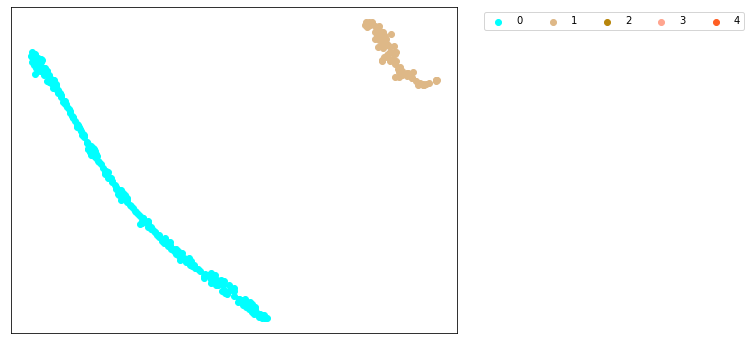

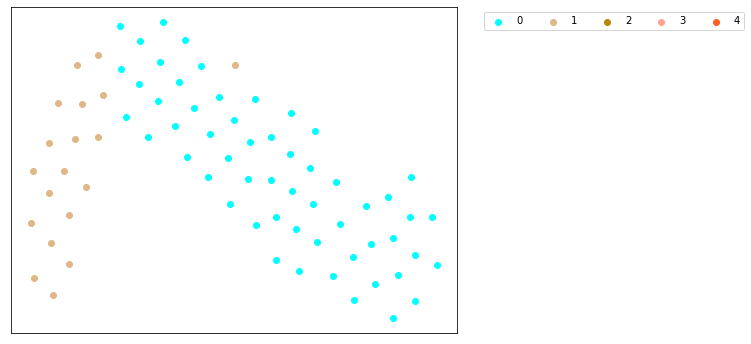

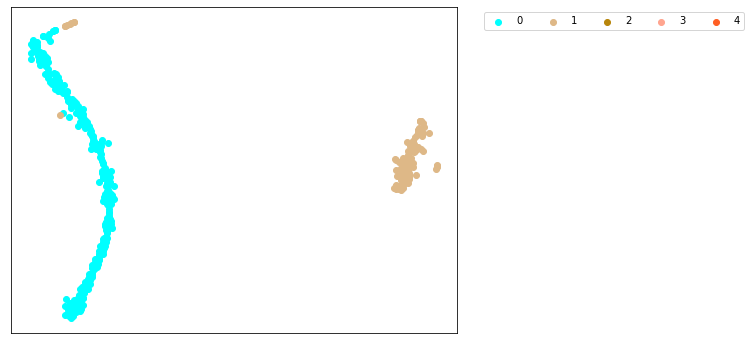

In [25]:
X_train, y_train, plt_arc_df_train = plot_tSNE_MVtec(model, metric_fc, train_loader)
X_test, y_test, plt_arc_df_test = plot_tSNE_MVtec(model, metric_fc, test_loader)
X = np.concatenate([X_train, X_test])
y = np.concatenate([y_train, y_test])
plot_tSNE(X, y)

### 実際のクラス（正常か異常か）と推論結果が異なるものを表示

In [26]:
plt_arc_df_train[plt_arc_df_train.label != plt_arc_df_train.ctgr]

,label,ctgr


In [27]:
plt_arc_df_test[plt_arc_df_test.label != plt_arc_df_test.ctgr]

,label,ctgr
57,1,0
61,1,0
63,1,0
71,1,0


## 新しくMy_BasicBlockを作成

In [28]:
def conv3x3(in_planes, out_planes, stride=1, groups=1, dilation=1):
    """3x3 convolution with padding"""
    return nn.Conv2d(in_planes, out_planes, kernel_size=3, stride=stride,
                     padding=dilation, groups=groups, bias=False, dilation=dilation)

def conv1x1(in_planes, out_planes, stride=1):
    """1x1 convolution"""
    return nn.Conv2d(in_planes, out_planes, kernel_size=1, stride=stride, bias=False)

In [29]:
class My_BasicBlock(nn.Module):
    expansion = 1
    med_out = None
    def __init__(self, inplanes, planes, stride=1, downsample=None, groups=1,
                 base_width=64, dilation=1, norm_layer=None):
        super(My_BasicBlock, self).__init__()
        if norm_layer is None:
            norm_layer = nn.BatchNorm2d
        width = int(planes * (base_width / 64.)) * groups
        # Both self.conv2 and self.downsample layers downsample the input when stride != 1
        self.conv1 = conv3x3(inplanes, width, stride, groups, dilation)
        self.bn1 = norm_layer(width)
        self.relu = nn.ReLU(inplace=True)
        self.conv2 = conv3x3(width, width, stride, groups, dilation)
        self.bn2 = norm_layer(width)
        self.downsample = downsample
        self.stride = stride

    def forward(self, x):
        identity = x

        out = self.conv1(x)
        out = self.bn1(out)
        out = self.relu(out)

        out = self.conv2(out)
        My_BasicBlock.med_out = out
        out = self.bn2(out)

        if self.downsample is not None:
            identity = self.downsample(x)

        out += identity
        out = self.relu(out)

        return out
      
    @classmethod
    def get_med_out(cls):
        return cls.med_out

## ResNetの一部を差し替える

In [30]:
list(model.children())[1][6][1] = My_BasicBlock(512, 512)

In [31]:
#params = torch.load("/content/drive/My Drive/MVTec_data/models/AdaCos_model_leather_" + dt_now) # Google Colab用
params = torch.load("./models/AdaCos_model_leather_" + dt_now) 
model.load_state_dict(params)

<All keys matched successfully>

## GradCam用に、画像データを作成

In [32]:
    transform_test_bad = transforms.Compose([
        #transforms.Resize((500,500)),
        transforms.Resize((512,512)),
        transforms.ToTensor(),
        #transforms.Normalize([0.485, 0.456, 0.406],[0.229, 0.224, 0.225])
    ])

In [33]:
train_test_set_bad = dataset.MVTec_dataset(
        train_img_paths_test_bad,
        train_labels_test_bad,
        transform=transform_test_bad)    

test_test_set_bad = dataset.MVTec_dataset(
        test_img_paths_test_bad,
        test_labels_test_bad,
        transform=transform_test_bad) 

In [34]:
train_test_bad_loader = DataLoader(train_test_set_bad, batch_size=len(train_test_set_bad))
train_test_bad_dataset_array = next(iter(train_test_bad_loader))[0].numpy()
train_test_bad_dataset_tensor = torch.from_numpy(train_test_bad_dataset_array)

test_test_bad_loader = DataLoader( test_test_set_bad, batch_size=len( test_test_set_bad))
test_test_bad_dataset_array = next(iter( test_test_bad_loader))[0].numpy()
test_test_bad_dataset_tensor = torch.from_numpy( test_test_bad_dataset_array)

In [35]:
print(train_test_bad_dataset_array.shape)
print(train_test_bad_dataset_tensor.shape)
print(test_test_bad_dataset_array.shape)
print(test_test_bad_dataset_tensor.shape)

(73, 3, 512, 512)
torch.Size([73, 3, 512, 512])
(19, 3, 512, 512)
torch.Size([19, 3, 512, 512])


## GradCam実行

In [36]:
def Grad_Cam_Leather(train_test_bad_dataset_tensor, train_img_paths_test_bad):
  for i in range(len(train_test_bad_dataset_tensor)):
    print(train_img_paths_test_bad[i])
    img = train_test_bad_dataset_tensor[i]
    original_img = img  #最後に表示する用
    img = img.unsqueeze(0)
    model.eval()
    metric_fc.eval()
    
    temp_output = model(img)
    output = metric_fc(temp_output)
    print(output)
    class_label = output.argmax(dim=1).item()
    #class_score = output[0][class_label]
    class_score = output[0][1]
    med_out = My_BasicBlock.get_med_out()
    N, C, H, W = med_out.shape
    grads = torch.autograd.grad(class_score, med_out)
    w  = grads[0][0].mean(-1).mean(-1) #チャンネルごとに勾配の平均をだし、重みを算出
    ans = torch.matmul(w, med_out.view(C, H*W))
    ans = F.relu(ans)
    ans = ans.view(H, W).cpu().detach().numpy()
    plt.imshow(ans)
    ans = cv2.resize(ans, (500, 500))
    plt.imshow(original_img.permute(1, 2, 0))
    plt.show()
    plt.imshow(original_img.permute(1, 2, 0))
    plt.imshow(ans, alpha=0.5, cmap='jet')
    plt.show()

./MVTec_data/leather/test/color/007.png
tensor([[-0.0214,  0.9427, -0.0904, -0.1544, -0.1639, -0.1548, -0.1756, -0.1116,
         -0.0872, -0.1164]], grad_fn=<MmBackward>)


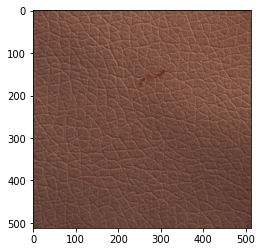

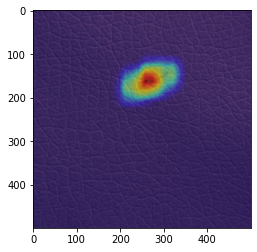

./MVTec_data/leather/test/fold/002.png
tensor([[ 0.0252,  0.9352, -0.0960, -0.1596, -0.1659, -0.1644, -0.1806, -0.1223,
         -0.0925, -0.1195]], grad_fn=<MmBackward>)


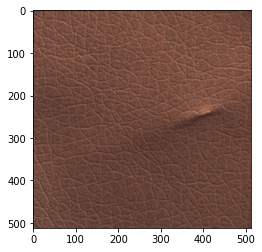

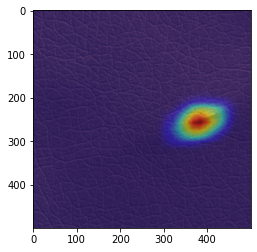

./MVTec_data/leather/test/fold/006.png
tensor([[-0.0424,  0.9447, -0.0881, -0.1513, -0.1607, -0.1514, -0.1722, -0.1067,
         -0.0850, -0.1143]], grad_fn=<MmBackward>)


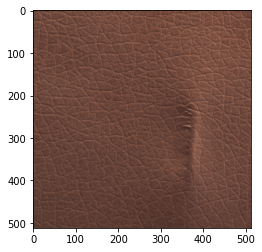

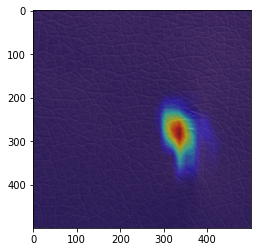

./MVTec_data/leather/test/color/009.png
tensor([[-0.0441,  0.9454, -0.0861, -0.1492, -0.1600, -0.1505, -0.1719, -0.1050,
         -0.0852, -0.1135]], grad_fn=<MmBackward>)


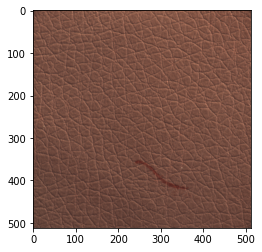

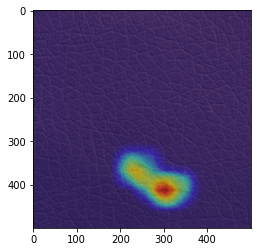

./MVTec_data/leather/test/color/015.png
tensor([[ 0.0204,  0.9385, -0.0931, -0.1566, -0.1656, -0.1629, -0.1777, -0.1186,
         -0.0930, -0.1191]], grad_fn=<MmBackward>)


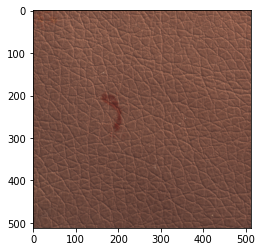

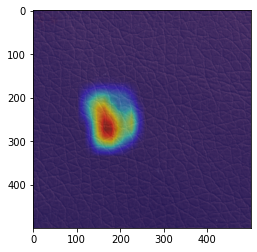

./MVTec_data/leather/test/fold/015.png
tensor([[-0.0186,  0.9407, -0.0925, -0.1558, -0.1623, -0.1571, -0.1746, -0.1120,
         -0.0894, -0.1187]], grad_fn=<MmBackward>)


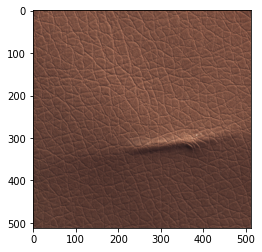

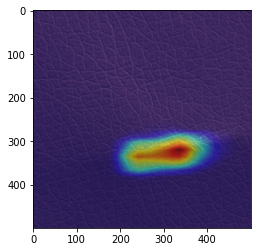

./MVTec_data/leather/test/fold/009.png
tensor([[-0.0289,  0.9417, -0.0897, -0.1526, -0.1608, -0.1541, -0.1751, -0.1108,
         -0.0868, -0.1162]], grad_fn=<MmBackward>)


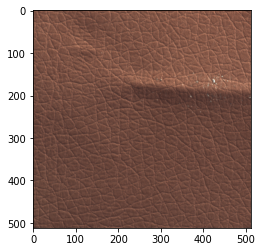

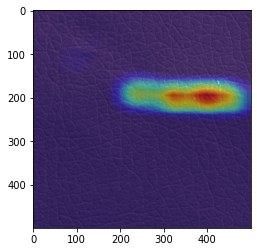

./MVTec_data/leather/test/fold/005.png
tensor([[-0.0162,  0.9424, -0.0899, -0.1538, -0.1637, -0.1566, -0.1757, -0.1124,
         -0.0880, -0.1172]], grad_fn=<MmBackward>)


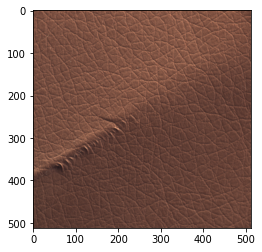

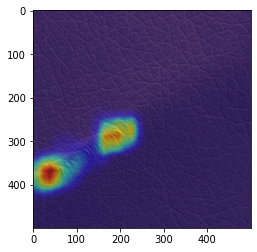

./MVTec_data/leather/test/color/004.png
tensor([[-0.0350,  0.9449, -0.0876, -0.1502, -0.1617, -0.1522, -0.1724, -0.1071,
         -0.0858, -0.1146]], grad_fn=<MmBackward>)


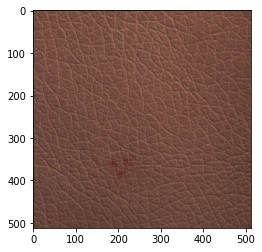

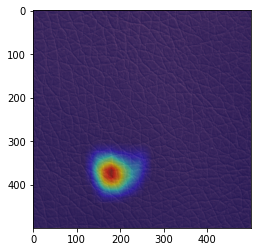

./MVTec_data/leather/test/poke/007.png
tensor([[-0.0288,  0.9441, -0.0896, -0.1510, -0.1617, -0.1533, -0.1734, -0.1087,
         -0.0869, -0.1149]], grad_fn=<MmBackward>)


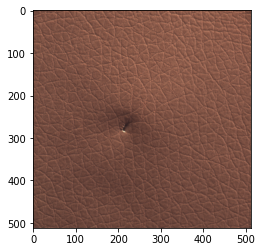

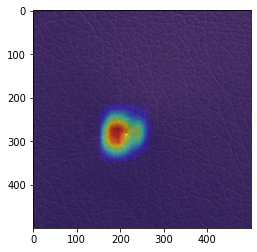

./MVTec_data/leather/test/cut/003.png
tensor([[ 0.0250,  0.9340, -0.0960, -0.1615, -0.1646, -0.1650, -0.1794, -0.1206,
         -0.0944, -0.1198]], grad_fn=<MmBackward>)


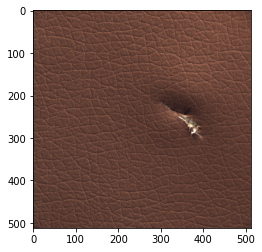

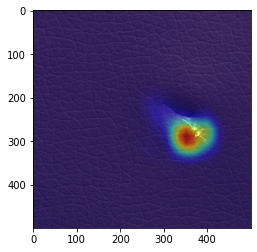

./MVTec_data/leather/test/glue/008.png
tensor([[-0.0860,  0.9490, -0.0795, -0.1436, -0.1561, -0.1421, -0.1644, -0.0937,
         -0.0803, -0.1091]], grad_fn=<MmBackward>)


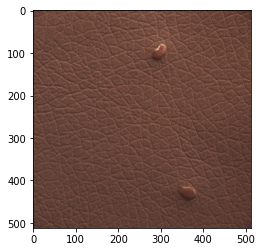

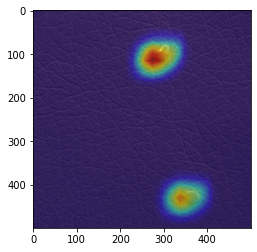

./MVTec_data/leather/test/poke/009.png
tensor([[-0.0049,  0.9418, -0.0909, -0.1529, -0.1636, -0.1578, -0.1756, -0.1144,
         -0.0892, -0.1163]], grad_fn=<MmBackward>)


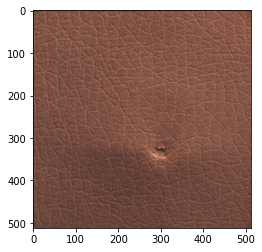

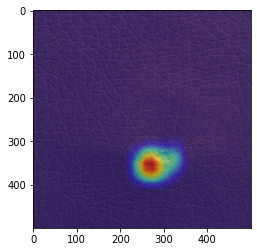

./MVTec_data/leather/test/color/006.png
tensor([[-0.0272,  0.9440, -0.0877, -0.1514, -0.1627, -0.1538, -0.1744, -0.1095,
         -0.0863, -0.1151]], grad_fn=<MmBackward>)


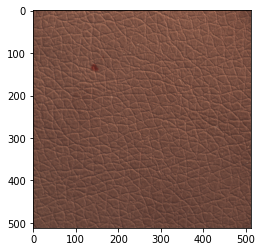

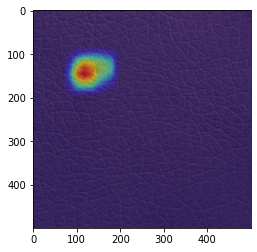

./MVTec_data/leather/test/cut/013.png
tensor([[-0.0328,  0.9444, -0.0886, -0.1519, -0.1617, -0.1533, -0.1732, -0.1082,
         -0.0859, -0.1146]], grad_fn=<MmBackward>)


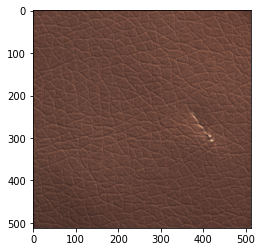

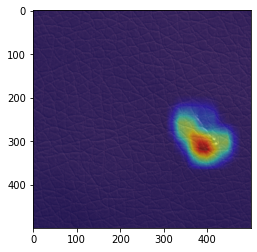

./MVTec_data/leather/test/glue/013.png
tensor([[-0.1161,  0.9483, -0.0724, -0.1347, -0.1508, -0.1367, -0.1581, -0.0867,
         -0.0774, -0.1062]], grad_fn=<MmBackward>)


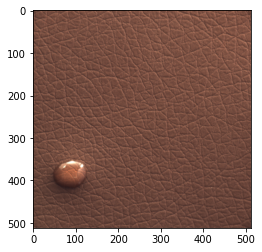

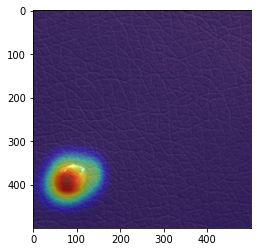

./MVTec_data/leather/test/color/018.png
tensor([[-0.0105,  0.9429, -0.0899, -0.1531, -0.1638, -0.1568, -0.1753, -0.1126,
         -0.0885, -0.1163]], grad_fn=<MmBackward>)


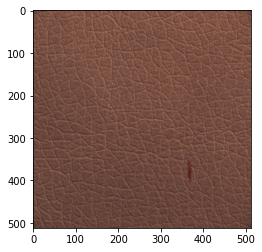

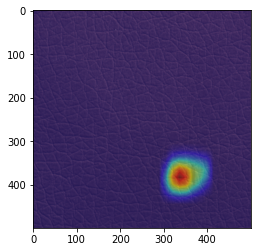

./MVTec_data/leather/test/cut/011.png
tensor([[-0.0700,  0.9477, -0.0843, -0.1458, -0.1571, -0.1455, -0.1669, -0.0988,
         -0.0823, -0.1108]], grad_fn=<MmBackward>)


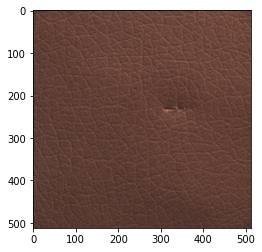

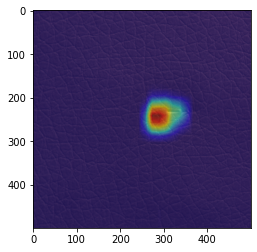

./MVTec_data/leather/test/color/014.png
tensor([[-0.1106,  0.9468, -0.0785, -0.1431, -0.1536, -0.1370, -0.1643, -0.0898,
         -0.0771, -0.1073]], grad_fn=<MmBackward>)


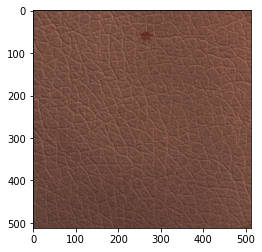

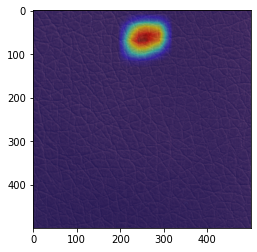

./MVTec_data/leather/test/color/010.png
tensor([[-0.0575,  0.9482, -0.0838, -0.1450, -0.1582, -0.1476, -0.1683, -0.1018,
         -0.0819, -0.1096]], grad_fn=<MmBackward>)


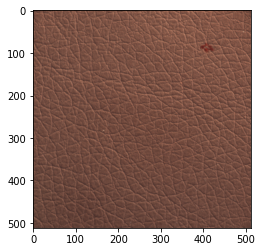

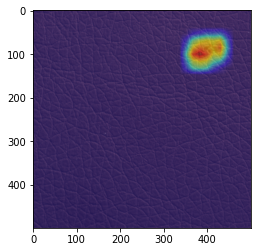

./MVTec_data/leather/test/fold/000.png
tensor([[-0.0900,  0.9467, -0.0810, -0.1460, -0.1547, -0.1415, -0.1673, -0.0950,
         -0.0784, -0.1093]], grad_fn=<MmBackward>)


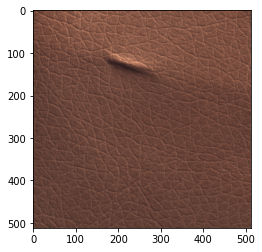

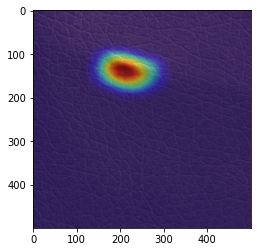

./MVTec_data/leather/test/cut/002.png
tensor([[-0.0918,  0.9488, -0.0799, -0.1422, -0.1555, -0.1404, -0.1649, -0.0937,
         -0.0791, -0.1084]], grad_fn=<MmBackward>)


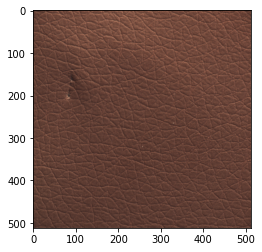

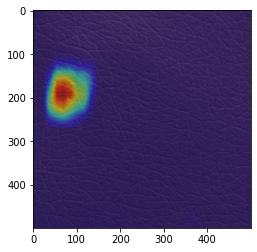

./MVTec_data/leather/test/fold/011.png
tensor([[-0.0300,  0.9440, -0.0877, -0.1522, -0.1629, -0.1535, -0.1739, -0.1092,
         -0.0866, -0.1158]], grad_fn=<MmBackward>)


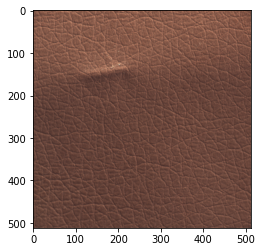

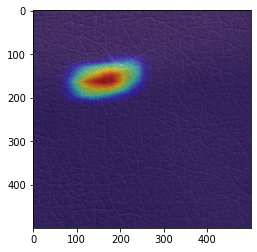

./MVTec_data/leather/test/cut/008.png
tensor([[-0.0156,  0.9428, -0.0909, -0.1545, -0.1637, -0.1562, -0.1742, -0.1106,
         -0.0892, -0.1164]], grad_fn=<MmBackward>)


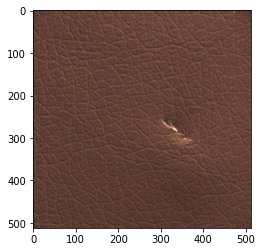

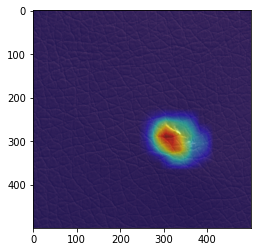

./MVTec_data/leather/test/glue/004.png
tensor([[-0.0857,  0.9487, -0.0821, -0.1440, -0.1565, -0.1427, -0.1652, -0.0948,
         -0.0799, -0.1098]], grad_fn=<MmBackward>)


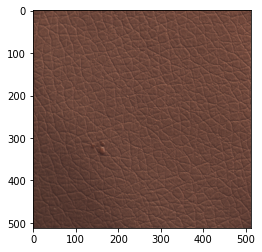

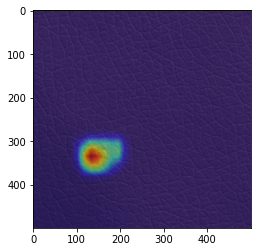

./MVTec_data/leather/test/poke/015.png
tensor([[-0.0494,  0.9454, -0.0877, -0.1509, -0.1614, -0.1497, -0.1718, -0.1039,
         -0.0842, -0.1138]], grad_fn=<MmBackward>)


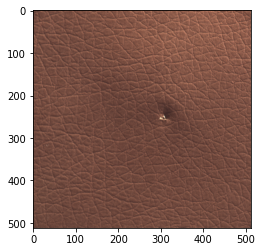

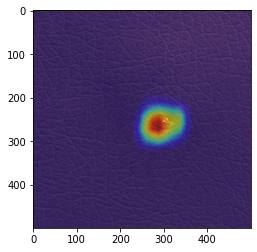

./MVTec_data/leather/test/cut/001.png
tensor([[-0.0470,  0.9443, -0.0881, -0.1514, -0.1612, -0.1510, -0.1721, -0.1057,
         -0.0856, -0.1155]], grad_fn=<MmBackward>)


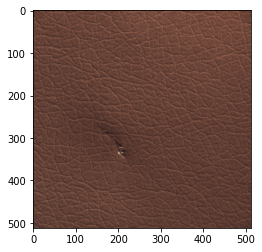

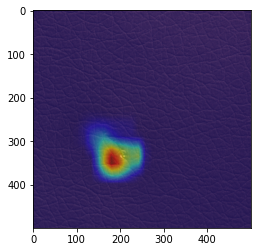

./MVTec_data/leather/test/cut/015.png
tensor([[-0.0166,  0.9423, -0.0907, -0.1543, -0.1635, -0.1560, -0.1750, -0.1123,
         -0.0885, -0.1163]], grad_fn=<MmBackward>)


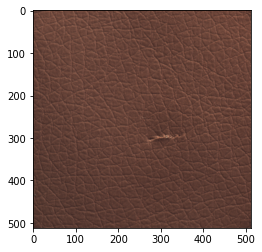

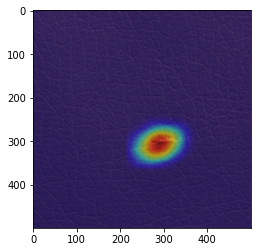

./MVTec_data/leather/test/fold/007.png
tensor([[-0.0270,  0.9420, -0.0911, -0.1550, -0.1635, -0.1554, -0.1753, -0.1105,
         -0.0877, -0.1182]], grad_fn=<MmBackward>)


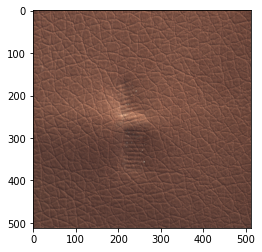

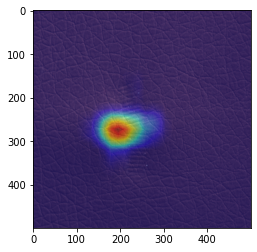

./MVTec_data/leather/test/color/001.png
tensor([[-0.0281,  0.9435, -0.0888, -0.1521, -0.1623, -0.1541, -0.1738, -0.1087,
         -0.0877, -0.1150]], grad_fn=<MmBackward>)


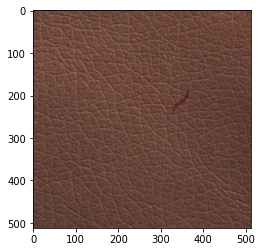

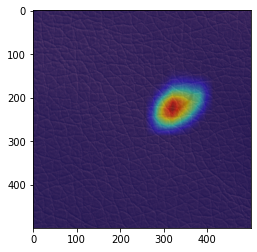

./MVTec_data/leather/test/cut/017.png
tensor([[-0.0358,  0.9446, -0.0882, -0.1512, -0.1621, -0.1523, -0.1726, -0.1075,
         -0.0864, -0.1146]], grad_fn=<MmBackward>)


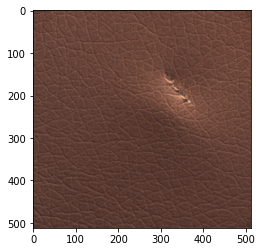

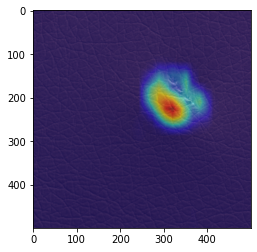

./MVTec_data/leather/test/fold/001.png
tensor([[-0.0259,  0.9429, -0.0893, -0.1539, -0.1626, -0.1547, -0.1743, -0.1095,
         -0.0887, -0.1170]], grad_fn=<MmBackward>)


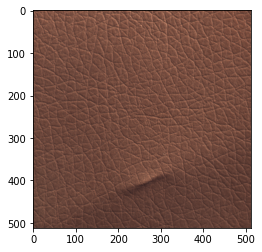

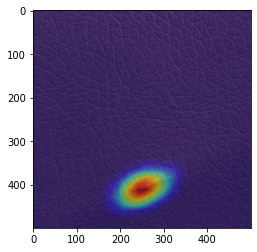

./MVTec_data/leather/test/cut/009.png
tensor([[-0.0357,  0.9439, -0.0893, -0.1528, -0.1616, -0.1530, -0.1728, -0.1084,
         -0.0864, -0.1156]], grad_fn=<MmBackward>)


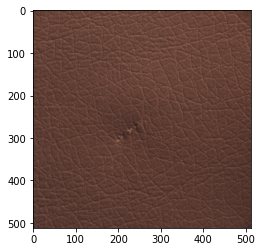

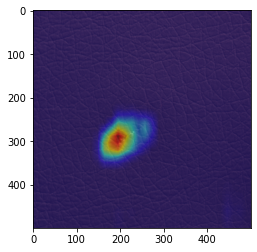

./MVTec_data/leather/test/glue/005.png
tensor([[-0.1057,  0.9468, -0.0804, -0.1427, -0.1512, -0.1386, -0.1613, -0.0890,
         -0.0800, -0.1095]], grad_fn=<MmBackward>)


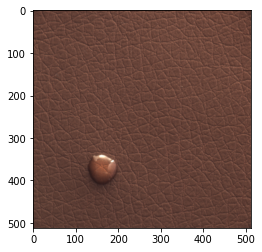

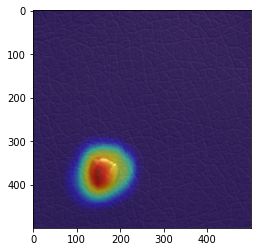

./MVTec_data/leather/test/poke/005.png
tensor([[-0.0279,  0.9439, -0.0883, -0.1519, -0.1627, -0.1540, -0.1736, -0.1081,
         -0.0871, -0.1154]], grad_fn=<MmBackward>)


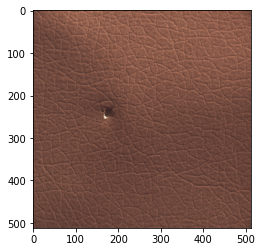

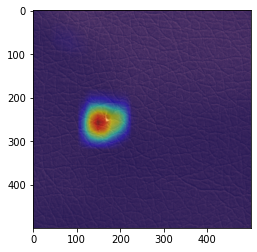

./MVTec_data/leather/test/glue/018.png
tensor([[-0.0613,  0.9471, -0.0805, -0.1431, -0.1563, -0.1464, -0.1686, -0.1020,
         -0.0816, -0.1103]], grad_fn=<MmBackward>)


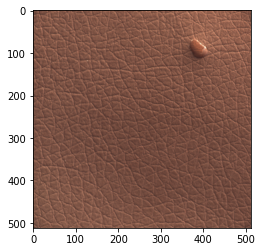

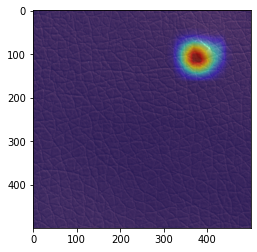

./MVTec_data/leather/test/glue/011.png
tensor([[-0.0722,  0.9470, -0.0832, -0.1470, -0.1578, -0.1453, -0.1685, -0.0993,
         -0.0822, -0.1117]], grad_fn=<MmBackward>)


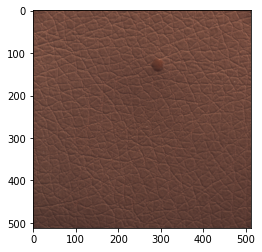

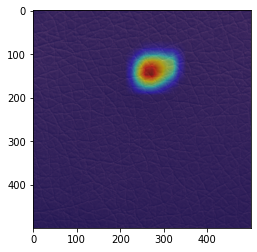

./MVTec_data/leather/test/glue/012.png
tensor([[-0.0365,  0.9454, -0.0872, -0.1497, -0.1614, -0.1516, -0.1718, -0.1067,
         -0.0858, -0.1136]], grad_fn=<MmBackward>)


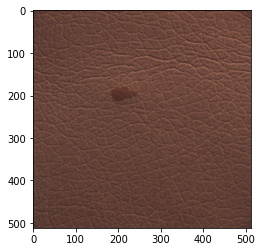

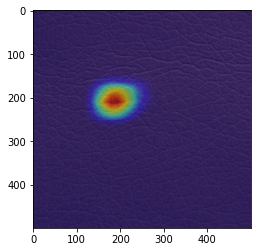

./MVTec_data/leather/test/color/002.png
tensor([[-0.0583,  0.9477, -0.0834, -0.1458, -0.1591, -0.1474, -0.1689, -0.1010,
         -0.0827, -0.1114]], grad_fn=<MmBackward>)


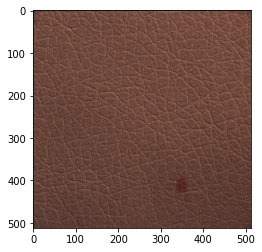

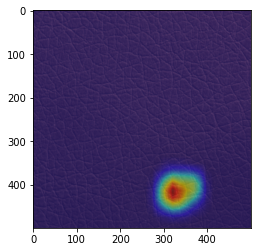

./MVTec_data/leather/test/cut/000.png
tensor([[ 0.0101,  0.9390, -0.0945, -0.1589, -0.1659, -0.1615, -0.1777, -0.1167,
         -0.0920, -0.1193]], grad_fn=<MmBackward>)


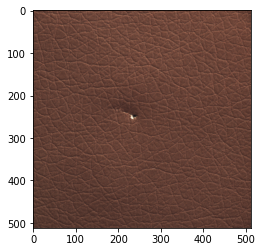

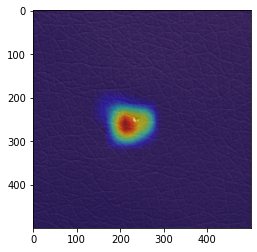

./MVTec_data/leather/test/cut/014.png
tensor([[-0.0653,  0.9477, -0.0842, -0.1468, -0.1590, -0.1462, -0.1685, -0.1001,
         -0.0819, -0.1115]], grad_fn=<MmBackward>)


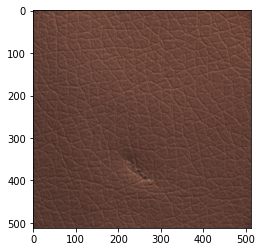

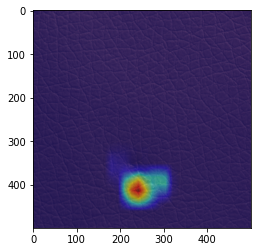

./MVTec_data/leather/test/glue/002.png
tensor([[-0.0213,  0.9423, -0.0913, -0.1558, -0.1645, -0.1554, -0.1751, -0.1105,
         -0.0880, -0.1170]], grad_fn=<MmBackward>)


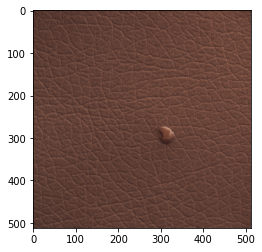

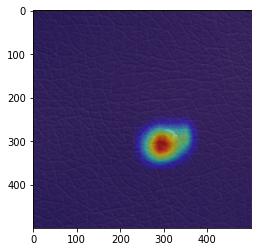

./MVTec_data/leather/test/glue/014.png
tensor([[-0.1690,  0.9411, -0.0776, -0.1413, -0.1507, -0.1255, -0.1579, -0.0783,
         -0.0673, -0.1023]], grad_fn=<MmBackward>)


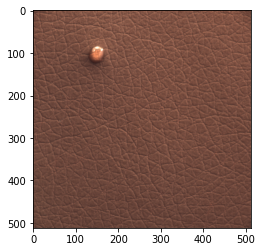

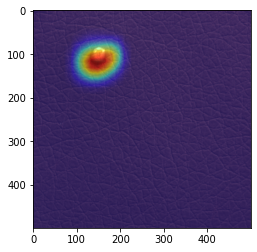

./MVTec_data/leather/test/poke/013.png
tensor([[-0.0721,  0.9488, -0.0820, -0.1451, -0.1584, -0.1443, -0.1671, -0.0975,
         -0.0811, -0.1102]], grad_fn=<MmBackward>)


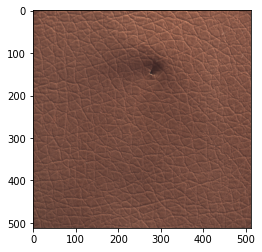

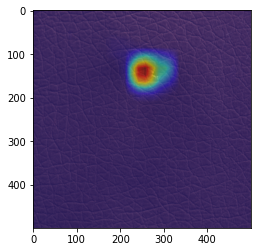

./MVTec_data/leather/test/cut/010.png
tensor([[-0.0314,  0.9430, -0.0902, -0.1533, -0.1614, -0.1541, -0.1735, -0.1092,
         -0.0871, -0.1161]], grad_fn=<MmBackward>)


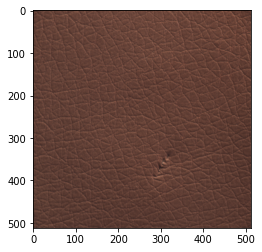

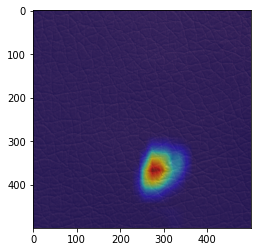

./MVTec_data/leather/test/poke/003.png
tensor([[-0.0112,  0.9432, -0.0887, -0.1510, -0.1632, -0.1560, -0.1749, -0.1119,
         -0.0887, -0.1148]], grad_fn=<MmBackward>)


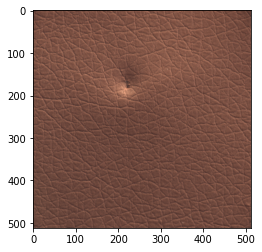

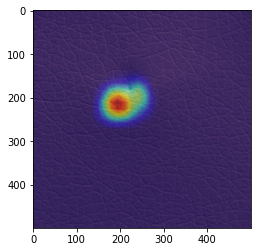

./MVTec_data/leather/test/poke/002.png
tensor([[-0.0602,  0.9477, -0.0837, -0.1464, -0.1592, -0.1474, -0.1690, -0.1012,
         -0.0820, -0.1108]], grad_fn=<MmBackward>)


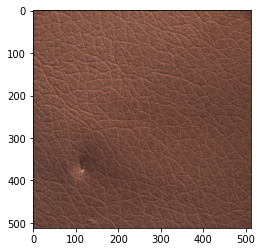

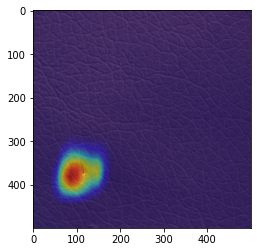

./MVTec_data/leather/test/color/008.png
tensor([[-0.0255,  0.9446, -0.0876, -0.1502, -0.1612, -0.1538, -0.1731, -0.1087,
         -0.0871, -0.1143]], grad_fn=<MmBackward>)


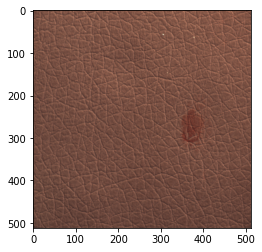

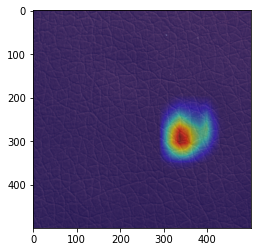

./MVTec_data/leather/test/cut/012.png
tensor([[-0.0220,  0.9436, -0.0889, -0.1519, -0.1628, -0.1554, -0.1738, -0.1090,
         -0.0889, -0.1149]], grad_fn=<MmBackward>)


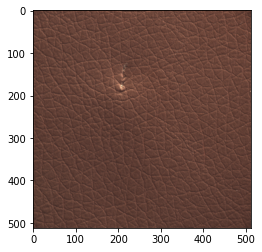

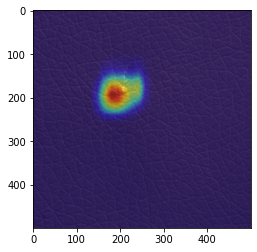

./MVTec_data/leather/test/poke/004.png
tensor([[-0.0910,  0.9500, -0.0791, -0.1405, -0.1547, -0.1409, -0.1641, -0.0920,
         -0.0776, -0.1064]], grad_fn=<MmBackward>)


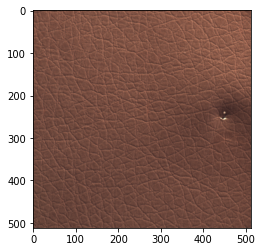

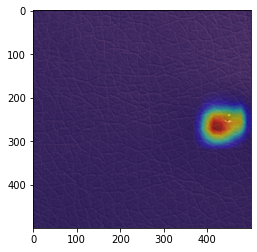

./MVTec_data/leather/test/glue/007.png
tensor([[-0.0823,  0.9481, -0.0822, -0.1443, -0.1559, -0.1434, -0.1647, -0.0948,
         -0.0822, -0.1093]], grad_fn=<MmBackward>)


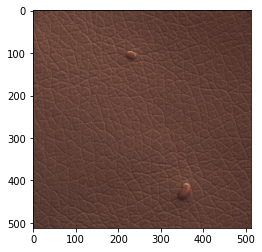

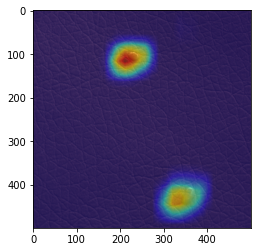

./MVTec_data/leather/test/color/013.png
tensor([[-0.0295,  0.9446, -0.0874, -0.1503, -0.1615, -0.1533, -0.1732, -0.1081,
         -0.0869, -0.1150]], grad_fn=<MmBackward>)


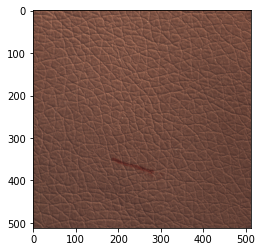

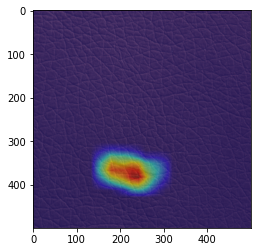

./MVTec_data/leather/test/fold/003.png
tensor([[-0.0504,  0.9474, -0.0837, -0.1461, -0.1596, -0.1487, -0.1696, -0.1029,
         -0.0840, -0.1117]], grad_fn=<MmBackward>)


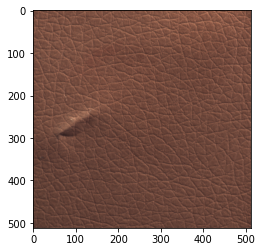

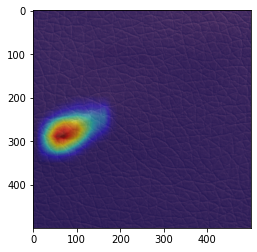

./MVTec_data/leather/test/glue/017.png
tensor([[ 0.0260,  0.9319, -0.0971, -0.1616, -0.1636, -0.1658, -0.1804, -0.1233,
         -0.0937, -0.1198]], grad_fn=<MmBackward>)


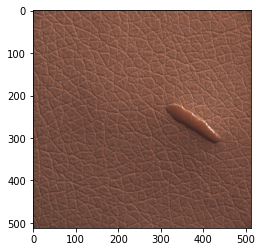

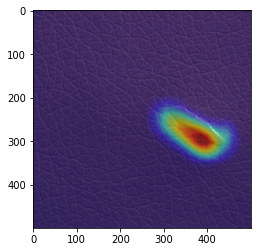

./MVTec_data/leather/test/glue/016.png
tensor([[-0.0491,  0.9463, -0.0860, -0.1481, -0.1593, -0.1496, -0.1707, -0.1036,
         -0.0843, -0.1123]], grad_fn=<MmBackward>)


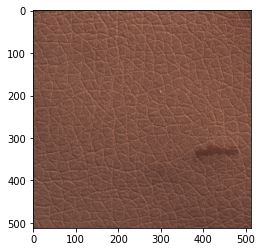

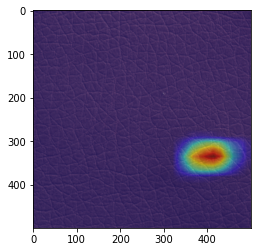

./MVTec_data/leather/test/fold/008.png
tensor([[-0.0265,  0.9423, -0.0917, -0.1565, -0.1633, -0.1549, -0.1738, -0.1094,
         -0.0877, -0.1174]], grad_fn=<MmBackward>)


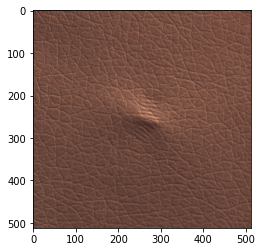

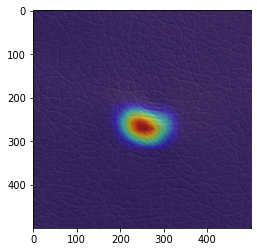

./MVTec_data/leather/test/fold/010.png
tensor([[-0.0565,  0.9465, -0.0865, -0.1485, -0.1592, -0.1484, -0.1692, -0.1019,
         -0.0842, -0.1125]], grad_fn=<MmBackward>)


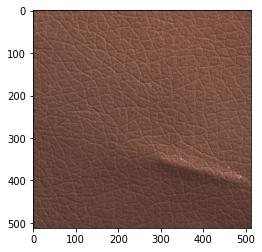

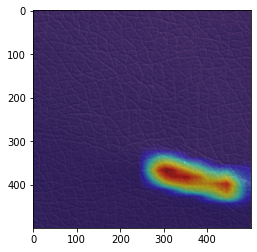

./MVTec_data/leather/test/poke/017.png
tensor([[-0.0681,  0.9476, -0.0843, -0.1464, -0.1581, -0.1459, -0.1679, -0.0992,
         -0.0812, -0.1111]], grad_fn=<MmBackward>)


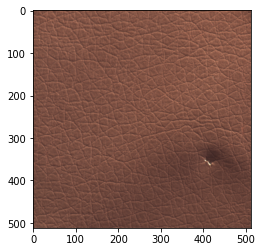

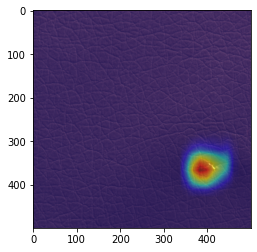

./MVTec_data/leather/test/glue/003.png
tensor([[-0.0606,  0.9456, -0.0855, -0.1491, -0.1584, -0.1475, -0.1705, -0.1026,
         -0.0823, -0.1121]], grad_fn=<MmBackward>)


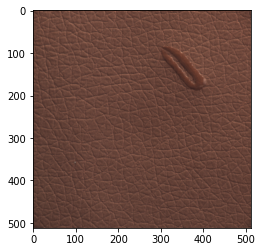

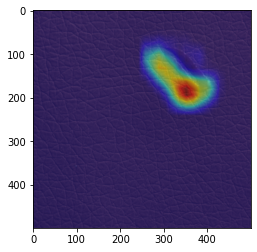

./MVTec_data/leather/test/cut/006.png
tensor([[-0.0128,  0.9415, -0.0916, -0.1552, -0.1640, -0.1573, -0.1768, -0.1132,
         -0.0880, -0.1176]], grad_fn=<MmBackward>)


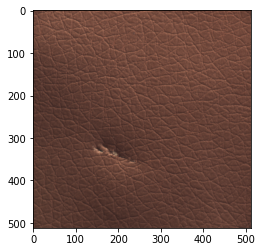

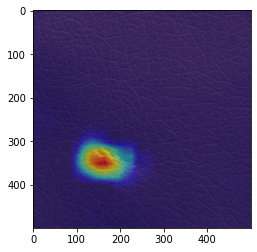

./MVTec_data/leather/test/fold/016.png
tensor([[-0.0223,  0.9162, -0.0932, -0.1608, -0.1576, -0.1526, -0.1853, -0.1206,
         -0.0851, -0.1149]], grad_fn=<MmBackward>)


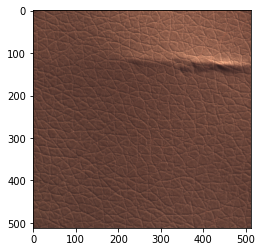

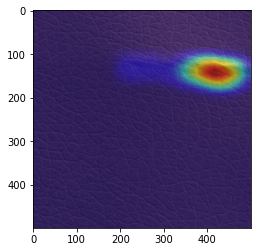

./MVTec_data/leather/test/poke/000.png
tensor([[-0.0557,  0.9479, -0.0832, -0.1457, -0.1592, -0.1477, -0.1694, -0.1020,
         -0.0822, -0.1100]], grad_fn=<MmBackward>)


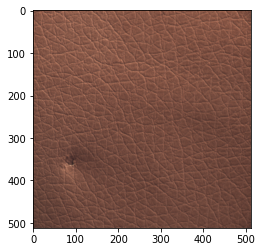

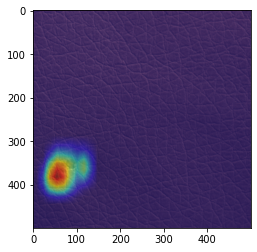

./MVTec_data/leather/test/fold/004.png
tensor([[-0.0039,  0.9379, -0.0955, -0.1591, -0.1632, -0.1608, -0.1748, -0.1155,
         -0.0919, -0.1205]], grad_fn=<MmBackward>)


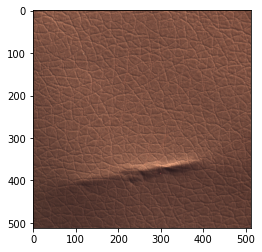

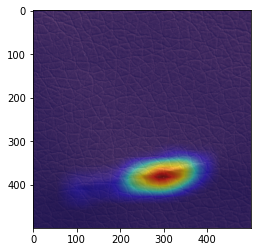

./MVTec_data/leather/test/color/005.png
tensor([[-0.0374,  0.9458, -0.0871, -0.1493, -0.1616, -0.1521, -0.1717, -0.1059,
         -0.0853, -0.1134]], grad_fn=<MmBackward>)


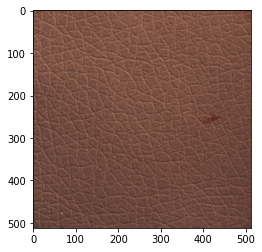

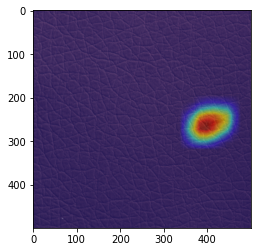

./MVTec_data/leather/test/color/000.png
tensor([[-0.0654,  0.9490, -0.0826, -0.1442, -0.1579, -0.1455, -0.1661, -0.0967,
         -0.0827, -0.1099]], grad_fn=<MmBackward>)


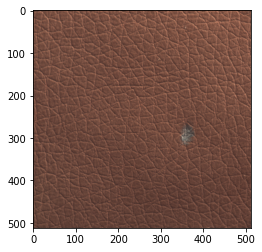

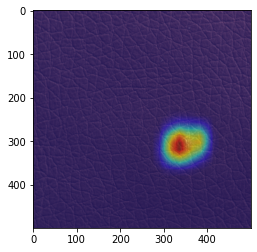

./MVTec_data/leather/test/color/016.png
tensor([[-0.0135,  0.9407, -0.0928, -0.1575, -0.1652, -0.1573, -0.1770, -0.1129,
         -0.0883, -0.1188]], grad_fn=<MmBackward>)


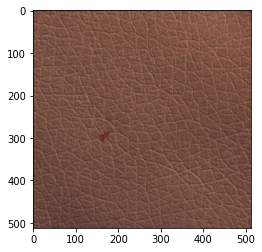

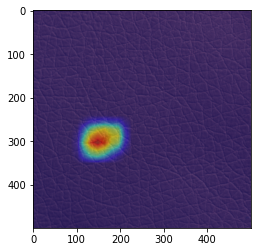

./MVTec_data/leather/test/cut/005.png
tensor([[-0.0597,  0.9462, -0.0846, -0.1476, -0.1583, -0.1478, -0.1693, -0.1020,
         -0.0842, -0.1119]], grad_fn=<MmBackward>)


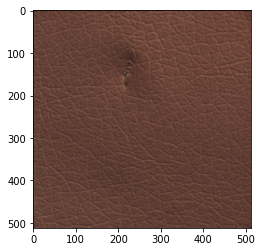

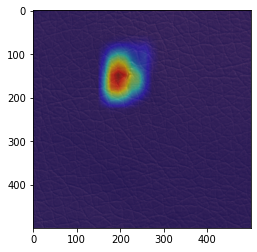

./MVTec_data/leather/test/cut/018.png
tensor([[-0.0436,  0.9452, -0.0865, -0.1505, -0.1613, -0.1506, -0.1730, -0.1054,
         -0.0837, -0.1127]], grad_fn=<MmBackward>)


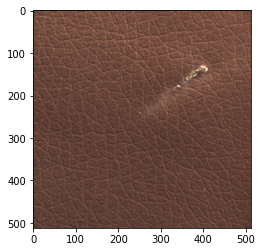

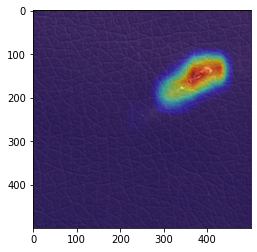

./MVTec_data/leather/test/poke/010.png
tensor([[-0.0105,  0.9419, -0.0898, -0.1522, -0.1636, -0.1572, -0.1760, -0.1138,
         -0.0886, -0.1150]], grad_fn=<MmBackward>)


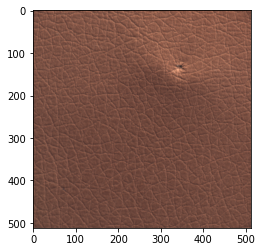

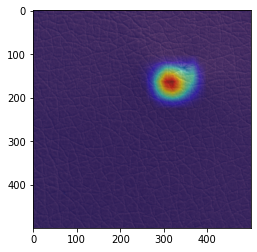

./MVTec_data/leather/test/poke/008.png
tensor([[-0.0931,  0.9490, -0.0808, -0.1426, -0.1546, -0.1412, -0.1620, -0.0924,
         -0.0797, -0.1089]], grad_fn=<MmBackward>)


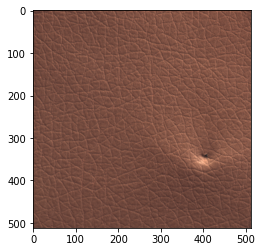

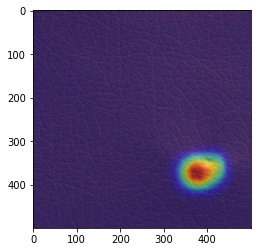

./MVTec_data/leather/test/poke/012.png
tensor([[-0.0487,  0.9436, -0.0876, -0.1512, -0.1613, -0.1501, -0.1726, -0.1065,
         -0.0841, -0.1140]], grad_fn=<MmBackward>)


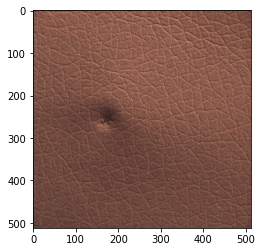

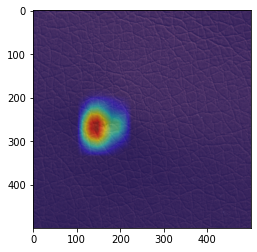

./MVTec_data/leather/test/poke/014.png
tensor([[-0.0609,  0.9482, -0.0828, -0.1452, -0.1595, -0.1470, -0.1682, -0.1011,
         -0.0817, -0.1108]], grad_fn=<MmBackward>)


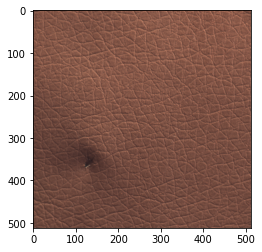

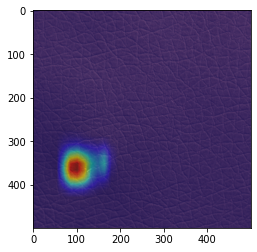

./MVTec_data/leather/test/color/011.png
tensor([[-0.0587,  0.9467, -0.0859, -0.1490, -0.1597, -0.1478, -0.1689, -0.1005,
         -0.0837, -0.1133]], grad_fn=<MmBackward>)


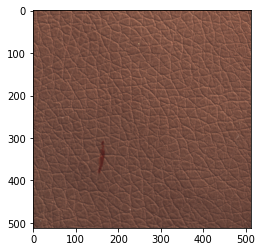

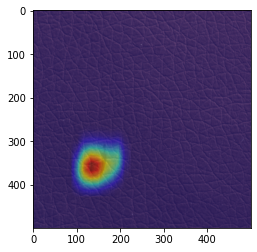

In [39]:
Grad_Cam_Leather(train_test_bad_dataset_tensor, train_img_paths_test_bad)

./MVTec_data/leather/test/cut/004.png
tensor([[ 0.0011,  0.9137, -0.0897, -0.1637, -0.1484, -0.1638, -0.1809, -0.1242,
         -0.0911, -0.1262]], grad_fn=<MmBackward>)


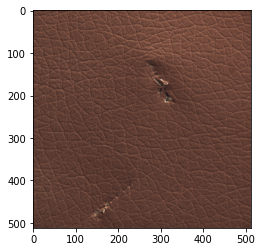

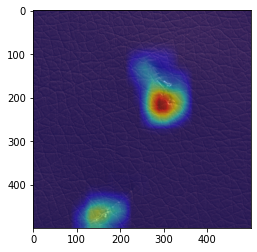

./MVTec_data/leather/test/glue/010.png
tensor([[ 0.6297,  0.6035, -0.1309, -0.1909, -0.1750, -0.2406, -0.2142, -0.2488,
         -0.1273, -0.1414]], grad_fn=<MmBackward>)


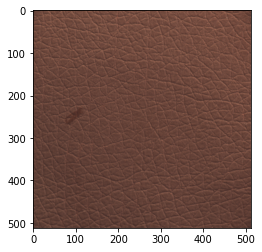

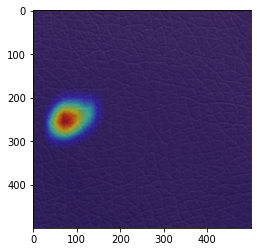

./MVTec_data/leather/test/poke/011.png
tensor([[-0.0557,  0.9439, -0.0863, -0.1497, -0.1588, -0.1490, -0.1752, -0.1032,
         -0.0826, -0.1108]], grad_fn=<MmBackward>)


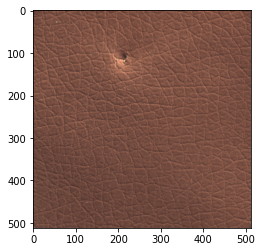

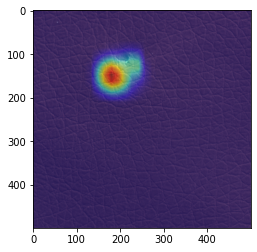

./MVTec_data/leather/test/color/017.png
tensor([[ 0.2781,  0.8488, -0.1217, -0.1881, -0.1761, -0.2082, -0.2046, -0.1817,
         -0.1172, -0.1356]], grad_fn=<MmBackward>)


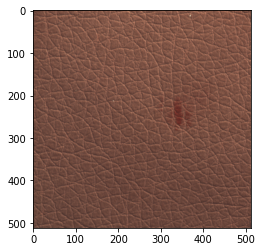

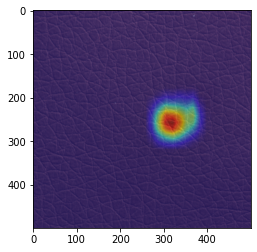

./MVTec_data/leather/test/poke/016.png
tensor([[ 0.2479,  0.8726, -0.1121, -0.1713, -0.1771, -0.1942, -0.1885, -0.1640,
         -0.1143, -0.1333]], grad_fn=<MmBackward>)


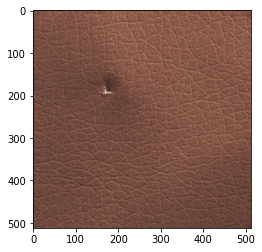

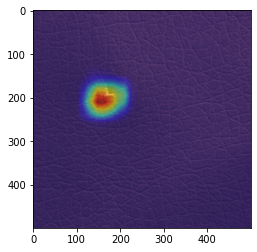

./MVTec_data/leather/test/fold/013.png
tensor([[ 0.7106,  0.5165, -0.1498, -0.1995, -0.1814, -0.2360, -0.2135, -0.2477,
         -0.1318, -0.1374]], grad_fn=<MmBackward>)


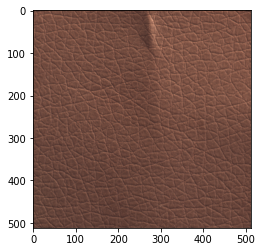

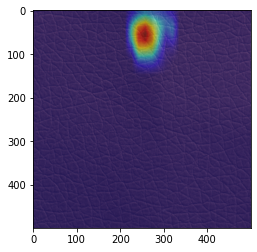

./MVTec_data/leather/test/poke/001.png
tensor([[ 0.5220,  0.7217, -0.1344, -0.1921, -0.1875, -0.2333, -0.2014, -0.2180,
         -0.1288, -0.1391]], grad_fn=<MmBackward>)


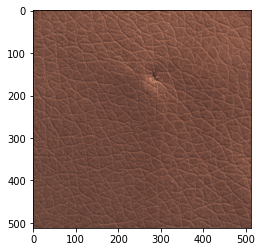

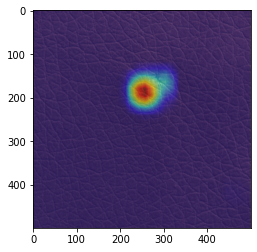

./MVTec_data/leather/test/glue/009.png
tensor([[ 0.6842,  0.5602, -0.1319, -0.1870, -0.1770, -0.2433, -0.2091, -0.2502,
         -0.1278, -0.1382]], grad_fn=<MmBackward>)


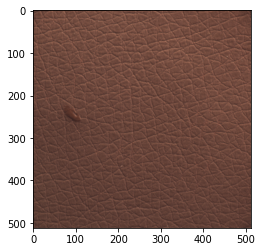

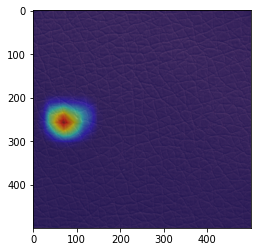

./MVTec_data/leather/test/glue/015.png
tensor([[-0.1217,  0.9451, -0.0735, -0.1338, -0.1443, -0.1352, -0.1574, -0.0842,
         -0.0775, -0.1053]], grad_fn=<MmBackward>)


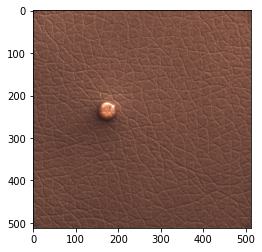

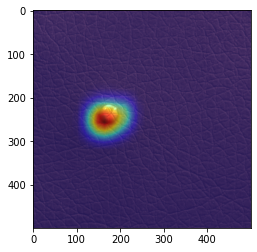

./MVTec_data/leather/test/glue/000.png
tensor([[-0.0293,  0.9303, -0.0903, -0.1546, -0.1527, -0.1554, -0.1740, -0.1148,
         -0.0887, -0.1169]], grad_fn=<MmBackward>)


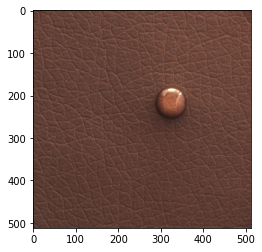

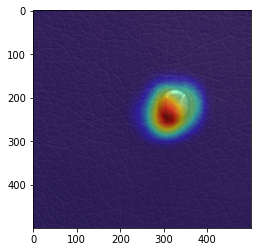

./MVTec_data/leather/test/cut/007.png
tensor([[ 0.2700,  0.8596, -0.1217, -0.1835, -0.1826, -0.2074, -0.2028, -0.1801,
         -0.1152, -0.1420]], grad_fn=<MmBackward>)


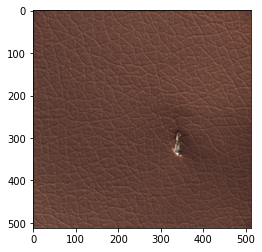

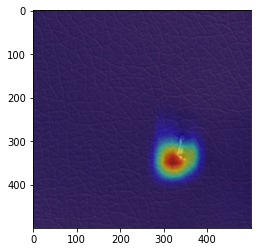

./MVTec_data/leather/test/cut/016.png
tensor([[-0.0888,  0.9492, -0.0772, -0.1399, -0.1547, -0.1424, -0.1638, -0.0926,
         -0.0822, -0.1100]], grad_fn=<MmBackward>)


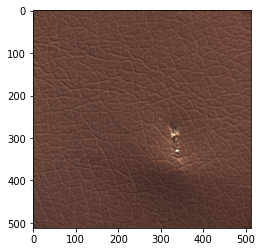

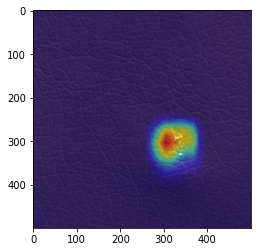

./MVTec_data/leather/test/color/003.png
tensor([[ 0.3140,  0.8481, -0.1169, -0.1835, -0.1853, -0.2064, -0.1992, -0.1840,
         -0.1208, -0.1369]], grad_fn=<MmBackward>)


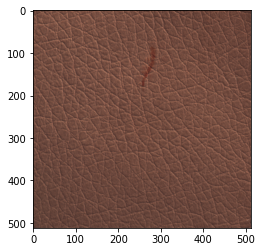

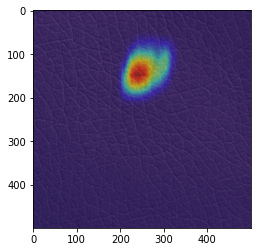

./MVTec_data/leather/test/color/012.png
tensor([[ 0.4794,  0.7102, -0.1368, -0.2003, -0.1729, -0.2287, -0.2153, -0.2193,
         -0.1292, -0.1414]], grad_fn=<MmBackward>)


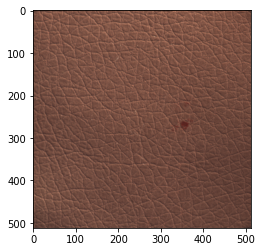

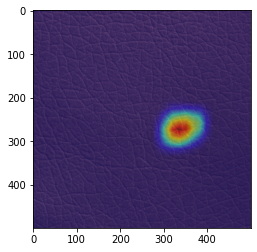

./MVTec_data/leather/test/glue/001.png
tensor([[ 0.4927,  0.7396, -0.1318, -0.1869, -0.1841, -0.2294, -0.2106, -0.2182,
         -0.1252, -0.1409]], grad_fn=<MmBackward>)


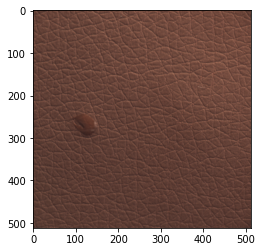

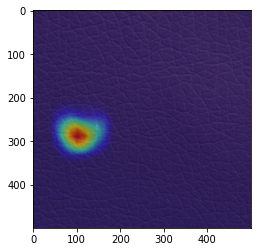

./MVTec_data/leather/test/poke/006.png
tensor([[ 0.9308, -0.0182, -0.1187, -0.1462, -0.1033, -0.1974, -0.1434, -0.2408,
         -0.1142, -0.1011]], grad_fn=<MmBackward>)


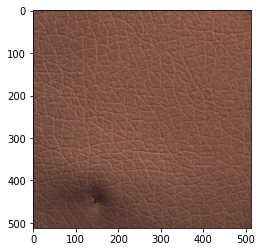

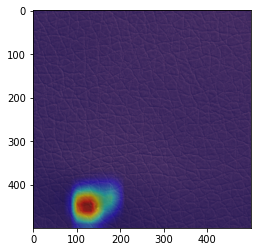

./MVTec_data/leather/test/fold/012.png
tensor([[ 0.1951,  0.8891, -0.1133, -0.1803, -0.1773, -0.1930, -0.2000, -0.1627,
         -0.1097, -0.1331]], grad_fn=<MmBackward>)


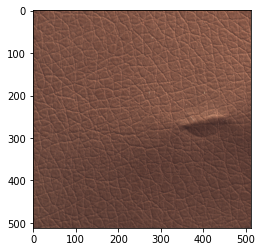

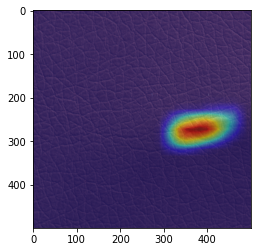

./MVTec_data/leather/test/glue/006.png
tensor([[-0.0172,  0.9421, -0.0904, -0.1551, -0.1650, -0.1566, -0.1753, -0.1123,
         -0.0882, -0.1177]], grad_fn=<MmBackward>)


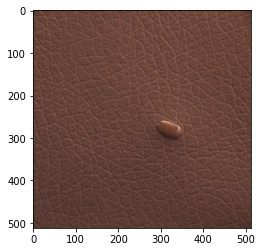

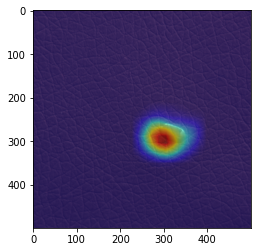

./MVTec_data/leather/test/fold/014.png
tensor([[ 0.1981,  0.8761, -0.1151, -0.1846, -0.1755, -0.1983, -0.2000, -0.1668,
         -0.1125, -0.1363]], grad_fn=<MmBackward>)


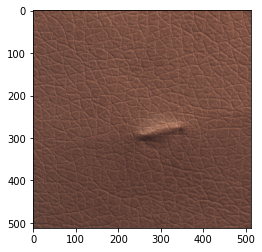

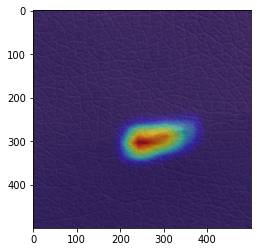

In [40]:
Grad_Cam_Leather(test_test_bad_dataset_tensor, test_img_paths_test_bad)